## **LRFM Analysis**

LRFM Analysis adalah salah satu teknik analisis yang berguna dalam menganalisis dan mengelompokkan pelanggan berdasarkan pola pembelian mereka. Singkatan LRFM mengacu pada:

1) Length (L): Lamanya waktu atau durasi pelanggan telah berinteraksi atau berhubungan dengan bisnis atau platform. Lamanya hubungan dengan pelanggan dapat menjadi faktor yang penting dalam menganalisis kesetiaan pelanggan dan retensi.
2) Recency (R): Waktu sejak pelanggan melakukan transaksi terakhir. Pelanggan yang melakukan pembelian baru-baru ini dianggap lebih berharga daripada yang tidak aktif dalam waktu yang lama.
3) Frequency (F): Frekuensi pembelian oleh pelanggan selama periode waktu tertentu. Pelanggan yang sering melakukan pembelian cenderung lebih berharga bagi bisnis.
4) Monetary Value (M): Jumlah uang yang dihabiskan oleh pelanggan selama periode waktu tertentu. Pelanggan yang mengeluarkan lebih banyak uang cenderung lebih berharga bagi bisnis.

Metode ini digunakan untuk mengelompokkan pelanggan ke dalam segmen-segmen berdasarkan kombinasi Length, Recency, Frequency, dan Monetary Value mereka. Analisis ini akan membantu mengidentifikasi segmen pelanggan yang paling berharga bagi Olist, serta memahami pola pembelian dan preferensi yang berbeda di antara segmen-segmen tersebut.

Hasil analisis ini akan membantu Olist dalam merancang strategi pemasaran yang lebih efektif, memberikan penawaran khusus yang disesuaikan dengan setiap segmen pelanggan, dan meningkatkan kepuasan pelanggan secara keseluruhan.

### **Length**

Pada bagian ini akan dilakukan pemberian nilai kepada tiap pelanggan berdasarkan lama waktu pelanggan menjadi member (tenure) dan melakukan transaksi di platfrom Olist. Skala skoring nya adalah 1 sampai 5, semakin besar nilai nya semakin lama pelanggan tersebut aktif melakukan transaksi.

(Nilai 1 melambangkan pelanggan yang tenure nya rendah/sebentar, sedangkan Nilai 5 melambangkan pelanggan yang tenur nya tinggi/lama).

In [ ]:
df_length = df[['customer_unique_id','order_purchase_timestamp']].copy()
df_length['first_purchase_date'] = df_length.groupby('customer_unique_id')['order_purchase_timestamp'].transform('min')
df_length['last_purchase_date'] = df_length.groupby('customer_unique_id')['order_purchase_timestamp'].transform('max')
df_length = df_length.drop(columns='order_purchase_timestamp')
df_length = df_length.drop_duplicates()
df_length.head()

,customer_unique_id,first_purchase_date,last_purchase_date
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16,2017-05-16
1,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19,2018-05-19
2,259dac757896d24d7702b9acbbff3f3c,2018-03-13,2018-03-13
3,07d190f123147d9e89d4b922543d7948,2018-07-08,2018-07-08
4,332cf4e83e16004ba7dca932ce82475b,2017-04-02,2017-04-02


In [ ]:
df_length['tenure_in_days'] = (df_length['last_purchase_date'] - df_length['first_purchase_date']).dt.days
df_length

,customer_unique_id,first_purchase_date,last_purchase_date,tenure_in_days
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16,2017-05-16,0
1,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19,2018-05-19,0
2,259dac757896d24d7702b9acbbff3f3c,2018-03-13,2018-03-13,0
3,07d190f123147d9e89d4b922543d7948,2018-07-08,2018-07-08,0
4,332cf4e83e16004ba7dca932ce82475b,2017-04-02,2017-04-02,0
...,...,...,...,...
119137,e4469e5047c00b0188885853d357d2ab,2018-06-03,2018-06-03,0
119139,1b553902a5bbe6ee54a3aaa7cbfb6816,2017-05-17,2017-05-17,0
119140,f979a07fc18b2af3780a796ba14b96f4,2017-10-08,2017-10-08,0
119141,d8bee9ec375c3a0f9ef8ed7456a51dcd,2017-01-26,2017-01-26,0


In [ ]:
min_length = df_length['tenure_in_days'].min()
max_length = df_length['tenure_in_days'].max()+1

In [ ]:
length_boundaries = np.percentile((min_length,max_length), [0, 20, 40, 60, 80, 100])
length_scores = [1,2,3,4,5]
df_length['length_score'] = pd.cut(df_length['tenure_in_days'], bins=length_boundaries, labels=length_scores, right=False)
df_length.head()

,customer_unique_id,first_purchase_date,last_purchase_date,tenure_in_days,length_score
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16,2017-05-16,0,1
1,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19,2018-05-19,0,1
2,259dac757896d24d7702b9acbbff3f3c,2018-03-13,2018-03-13,0,1
3,07d190f123147d9e89d4b922543d7948,2018-07-08,2018-07-08,0,1
4,332cf4e83e16004ba7dca932ce82475b,2017-04-02,2017-04-02,0,1


In [ ]:
df_tenure_days = df_length[['customer_unique_id','tenure_in_days']]
df_tenure_days.head()

,customer_unique_id,tenure_in_days
0,861eff4711a542e4b93843c6dd7febb0,0
1,060e732b5b29e8181a18229c7b0b2b5e,0
2,259dac757896d24d7702b9acbbff3f3c,0
3,07d190f123147d9e89d4b922543d7948,0
4,332cf4e83e16004ba7dca932ce82475b,0


In [ ]:
df_length_score = df_length[['customer_unique_id','length_score']]
df_length_score.head()

,customer_unique_id,length_score
0,861eff4711a542e4b93843c6dd7febb0,1
1,060e732b5b29e8181a18229c7b0b2b5e,1
2,259dac757896d24d7702b9acbbff3f3c,1
3,07d190f123147d9e89d4b922543d7948,1
4,332cf4e83e16004ba7dca932ce82475b,1


### **Recency**

Pada bagian ini akan dilakukan pemberian nilai kepada tiap pelanggan berdasarkan tanggal terakhir pelanggan tersebut melakukan pemesanan dari data diambil. Skala skoring nya adalah 1 sampai 5, semakin besar nilai nya semakin dekat tanggal pelanggan tersebut melakukan pemesanan dengan tanggal pengambilan data.

(Nilai 1 melambangkan pelanggan yang sudah lama tidak melakukan pembelian, sedangkan Nilai 5 melambangkan pelanggan yang melakukan pembelian baru-baru ini / mendekati tanggal pengambilan data).

In [ ]:
max_date = df['order_purchase_timestamp'].max() + pd.DateOffset(days=1)

In [ ]:
df_recency = df[['customer_unique_id','order_purchase_timestamp']].copy()
df_recency['last_purchase_date'] = df_recency.groupby('customer_unique_id')['order_purchase_timestamp'].transform('max')
df_recency.head()

,customer_unique_id,order_purchase_timestamp,last_purchase_date
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16,2017-05-16
1,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19,2018-05-19
2,259dac757896d24d7702b9acbbff3f3c,2018-03-13,2018-03-13
3,07d190f123147d9e89d4b922543d7948,2018-07-08,2018-07-08
4,332cf4e83e16004ba7dca932ce82475b,2017-04-02,2017-04-02


In [ ]:
df_recency = df_recency.drop(['order_purchase_timestamp'], axis=1)
df_recency = df_recency.drop_duplicates()
df_recency.head()

,customer_unique_id,last_purchase_date
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16
1,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19
2,259dac757896d24d7702b9acbbff3f3c,2018-03-13
3,07d190f123147d9e89d4b922543d7948,2018-07-08
4,332cf4e83e16004ba7dca932ce82475b,2017-04-02


In [ ]:
df_recency['recency_in_days'] = (max_date - df_recency['last_purchase_date']).dt.days
df_recency.head()

,customer_unique_id,last_purchase_date,recency_in_days
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16,471
1,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19,103
2,259dac757896d24d7702b9acbbff3f3c,2018-03-13,170
3,07d190f123147d9e89d4b922543d7948,2018-07-08,53
4,332cf4e83e16004ba7dca932ce82475b,2017-04-02,515


In [ ]:
min_recency = df_recency['recency_in_days'].min()
max_recency = df_recency['recency_in_days'].max()+1

In [ ]:
recency_boundaries = np.percentile((min_recency,max_recency), [0, 20, 40, 60, 80, 100])
recency_scores = [5,4,3,2,1]
df_recency['recency_score'] = pd.cut(df_recency['recency_in_days'], bins=recency_boundaries, labels=recency_scores, right=False)

In [ ]:
df_recency.head()

,customer_unique_id,last_purchase_date,recency_in_days,recency_score
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16,471,2
1,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19,103,5
2,259dac757896d24d7702b9acbbff3f3c,2018-03-13,170,4
3,07d190f123147d9e89d4b922543d7948,2018-07-08,53,5
4,332cf4e83e16004ba7dca932ce82475b,2017-04-02,515,2


In [ ]:
df_recency_days = df_recency[['customer_unique_id','recency_in_days']].copy()
df_recency_days.head()

,customer_unique_id,recency_in_days
0,861eff4711a542e4b93843c6dd7febb0,471
1,060e732b5b29e8181a18229c7b0b2b5e,103
2,259dac757896d24d7702b9acbbff3f3c,170
3,07d190f123147d9e89d4b922543d7948,53
4,332cf4e83e16004ba7dca932ce82475b,515


In [ ]:
df_recency_score = df_recency[['customer_unique_id','recency_score']].copy()
df_recency_score.head()

,customer_unique_id,recency_score
0,861eff4711a542e4b93843c6dd7febb0,2
1,060e732b5b29e8181a18229c7b0b2b5e,5
2,259dac757896d24d7702b9acbbff3f3c,4
3,07d190f123147d9e89d4b922543d7948,5
4,332cf4e83e16004ba7dca932ce82475b,2


### **Frequency**

Pada bagian ini akan dilakukan pemberian nilai kepada tiap customer berdasarkan banyaknya pelanggan melakukan transaksi di platfrom Olist. Skala skoring nya adalah 1 sampai 5, semakin besar nilai nya semakin banyak pemesanan yang telah dilakukan pelanggan tersebut.

(Nilai 1 melambangkan pelanggan melakukan order 1x, Nilai 2 melambangkan pelanggan melakukan order 2x, Nilai 3 melambangkan pelanggan melakukan order 3x, Nilai 4 melambangkan pelanggan melakukan order 4x, sedangkan Nilai 5 melambangkan pelanggan melakukan order lebih dari 5x).

In [ ]:
df_frequency = df[['customer_unique_id','order_purchase_timestamp']].copy()
df_frequency.shape

(114072, 2)

In [ ]:
df_frequency = df_frequency.drop_duplicates()
df_frequency.head()

,customer_unique_id,order_purchase_timestamp
0,861eff4711a542e4b93843c6dd7febb0,2017-05-16
1,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19
2,259dac757896d24d7702b9acbbff3f3c,2018-03-13
3,07d190f123147d9e89d4b922543d7948,2018-07-08
4,332cf4e83e16004ba7dca932ce82475b,2017-04-02


In [ ]:
freq_count = pd.DataFrame(df_frequency['customer_unique_id'].value_counts()).reset_index().rename(columns={'customer_unique_id':'frequency','index':'customer_unique_id'})
freq_count.head()

,customer_unique_id,frequency
0,8d50f5eadf50201ccdcedfb9e2ac8455,14
1,ca77025e7201e3b30c44b472ff346268,7
2,1b6c7548a2a1f9037c1fd3ddfed95f33,7
3,dc813062e0fc23409cd255f7f53c7074,6
4,3e43e6105506432c953e165fb2acf44c,6


In [ ]:
freq_boundaries = [1,2,3,4,5, float('inf')]
freq_scores = [1,2,3,4,5]
freq_count['frequency_score'] = pd.cut(freq_count['frequency'], bins=freq_boundaries, labels=freq_scores, right=False)


In [ ]:
freq_count.head()

,customer_unique_id,frequency,frequency_score
0,8d50f5eadf50201ccdcedfb9e2ac8455,14,5
1,ca77025e7201e3b30c44b472ff346268,7,5
2,1b6c7548a2a1f9037c1fd3ddfed95f33,7,5
3,dc813062e0fc23409cd255f7f53c7074,6,5
4,3e43e6105506432c953e165fb2acf44c,6,5


In [ ]:
df_frequency_count = freq_count[['customer_unique_id','frequency']].copy()
df_frequency_count.head()

,customer_unique_id,frequency
0,8d50f5eadf50201ccdcedfb9e2ac8455,14
1,ca77025e7201e3b30c44b472ff346268,7
2,1b6c7548a2a1f9037c1fd3ddfed95f33,7
3,dc813062e0fc23409cd255f7f53c7074,6
4,3e43e6105506432c953e165fb2acf44c,6


In [ ]:
df_frequency_score = freq_count[['customer_unique_id','frequency_score']].copy()
df_frequency_score.head()

,customer_unique_id,frequency_score
0,8d50f5eadf50201ccdcedfb9e2ac8455,5
1,ca77025e7201e3b30c44b472ff346268,5
2,1b6c7548a2a1f9037c1fd3ddfed95f33,5
3,dc813062e0fc23409cd255f7f53c7074,5
4,3e43e6105506432c953e165fb2acf44c,5


### **Monetary**

Pada bagian ini akan dilakukan pemberian nilai kepada tiap pelanggan berdasarkan banyaknya uang yang telah dibayarkan di platfrom Olist pada periode yang ditetapkan. Skala skoring nya adalah 1 sampai 5, semakin besar nilai nya semakin besar nilai transaksi pelanggan tersebut.

(Nilai 1 melambangkan pelanggan yang spending nya rendah, sedangkan Nilai 5 melambangkan pelanggan yang spendingnya tinggi).


In [ ]:
df_monetary = df.groupby('customer_unique_id')[['payment_value']].sum().reset_index()
df_monetary.head()

,customer_unique_id,payment_value
0,0000366f3b9a7992bf8c76cfdf3221e2,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,27.19
2,0000f46a3911fa3c0805444483337064,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,43.62
4,0004aac84e0df4da2b147fca70cf8255,196.89


In [ ]:
min_paid_value = df_monetary['payment_value'].min()
max_paid_value = df_monetary['payment_value'].max()+1

In [ ]:
monetary_boundaries = np.percentile((min_paid_value,max_paid_value), [0, 20, 40, 60, 80, 100])
monetary_scores = [1,2,3,4,5]
df_monetary['monetary_score'] = pd.cut(df_monetary['payment_value'], bins=monetary_boundaries, labels=monetary_scores, right=False)
df_monetary.head()

,customer_unique_id,payment_value,monetary_score
0,0000366f3b9a7992bf8c76cfdf3221e2,141.90,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,27.19,1
2,0000f46a3911fa3c0805444483337064,86.22,1
3,0000f6ccb0745a6a4b88665a16c9f078,43.62,1
4,0004aac84e0df4da2b147fca70cf8255,196.89,1


In [ ]:
df_monetary_value = df_monetary[['customer_unique_id','payment_value']].copy()
df_monetary_value.head()

,customer_unique_id,payment_value
0,0000366f3b9a7992bf8c76cfdf3221e2,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,27.19
2,0000f46a3911fa3c0805444483337064,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,43.62
4,0004aac84e0df4da2b147fca70cf8255,196.89


In [ ]:
df_monetary_score = df_monetary[['customer_unique_id','monetary_score']].copy()
df_monetary_score.head()

,customer_unique_id,monetary_score
0,0000366f3b9a7992bf8c76cfdf3221e2,1
1,0000b849f77a49e4a4ce2b2a4ca5be3f,1
2,0000f46a3911fa3c0805444483337064,1
3,0000f6ccb0745a6a4b88665a16c9f078,1
4,0004aac84e0df4da2b147fca70cf8255,1


## **LRFM Clustering**


### **Manual Clustering**

Pada bagian ini dilakukan pemberian cluster secara manual berdasarkan score LRFM yang telah dibuat sebelumnya. Dengan asumsi bahwa bobot ke-empatnya sama (memiliki kepentingan yang sama), maka ke-empat LRFM score sebelumnya dirata-ratakan untuk menentukan nilai LRFM dari masing-masing pelanggan. Nilai pelanggan ini di cluster (kelompokkan berdasarkan rata-ratanya), sehingga diperoleh cluster LRFM manual dari Cluster 1 hingga Cluster 5.

In [ ]:
dataframes = [df_tenure_days, df_recency_days, df_frequency_count, df_monetary_value]

# Merge the dataframes based on 'customer_unique_id'
df_lrfm = dataframes[0]
for i in range(1, len(dataframes)):
    df_lrfm = pd.merge(df_lrfm, dataframes[i], on='customer_unique_id', how='left')

df_lrfm.head()

,customer_unique_id,tenure_in_days,recency_in_days,frequency,payment_value
0,861eff4711a542e4b93843c6dd7febb0,0,471,1,146.87
1,060e732b5b29e8181a18229c7b0b2b5e,0,103,1,157.73
2,259dac757896d24d7702b9acbbff3f3c,0,170,1,173.30
3,07d190f123147d9e89d4b922543d7948,0,53,1,315.75
4,332cf4e83e16004ba7dca932ce82475b,0,515,1,146.21


In [ ]:
dataframes = [df_length_score, df_recency_score, df_frequency_score, df_monetary_score]

# Merge the dataframes based on 'customer_unique_id'
df_lrfm_score = dataframes[0]
for i in range(1, len(dataframes)):
    df_lrfm_score = pd.merge(df_lrfm_score, dataframes[i], on='customer_unique_id', how='inner')

category_columns = ['length_score', 'recency_score', 'frequency_score', 'monetary_score']  
df_lrfm_score[category_columns] = df_lrfm_score[category_columns].astype('int')  
df_lrfm_score['lrfm_score'] = df_lrfm_score.mean(axis=1,numeric_only=True)

df_lrfm_score.head()

,customer_unique_id,length_score,recency_score,frequency_score,monetary_score,lrfm_score
0,861eff4711a542e4b93843c6dd7febb0,1,2,1,1,1.25
1,060e732b5b29e8181a18229c7b0b2b5e,1,5,1,1,2.00
2,259dac757896d24d7702b9acbbff3f3c,1,4,1,1,1.75
3,07d190f123147d9e89d4b922543d7948,1,5,1,1,2.00
4,332cf4e83e16004ba7dca932ce82475b,1,2,1,1,1.25


In [ ]:
df_lrfm_score['lrfm_score'].value_counts()

1.75    29998
2.00    28711
1.50    18440
1.25    11797
1.00     2005
2.25      597
2.50      288
2.75      137
3.00       80
3.25       22
3.50        8
3.75        4
Name: lrfm_score, dtype: int64

In [ ]:
lrfm_boundaries = [1, 1.25, 1.5, 1.75, 2,  float('inf')]
lrfm_scores = [1,2,3,4,5]
df_lrfm_score['lrfm_score'] = pd.cut(df_lrfm_score['lrfm_score'], bins=lrfm_boundaries, labels=lrfm_scores, right=False)
df_lrfm_score.head()

,customer_unique_id,length_score,recency_score,frequency_score,monetary_score,lrfm_score
0,861eff4711a542e4b93843c6dd7febb0,1,2,1,1,2
1,060e732b5b29e8181a18229c7b0b2b5e,1,5,1,1,5
2,259dac757896d24d7702b9acbbff3f3c,1,4,1,1,4
3,07d190f123147d9e89d4b922543d7948,1,5,1,1,5
4,332cf4e83e16004ba7dca932ce82475b,1,2,1,1,2


In [ ]:
df_lrfm_score['lrfm_score'].value_counts()

4    29998
5    29847
3    18440
2    11797
1     2005
Name: lrfm_score, dtype: int64

In [ ]:
df_cluster_lrfm_manual = pd.merge(left=df_lrfm,right=df_lrfm_score,on='customer_unique_id',how='left')
df_cluster_lrfm_manual = df_cluster_lrfm_manual[['customer_unique_id', 'tenure_in_days', 'recency_in_days', 'frequency', 'payment_value', 'lrfm_score']]
df_cluster_lrfm_manual.head()

,customer_unique_id,tenure_in_days,recency_in_days,frequency,payment_value,lrfm_score
0,861eff4711a542e4b93843c6dd7febb0,0,471,1,146.87,2
1,060e732b5b29e8181a18229c7b0b2b5e,0,103,1,157.73,5
2,259dac757896d24d7702b9acbbff3f3c,0,170,1,173.30,4
3,07d190f123147d9e89d4b922543d7948,0,53,1,315.75,5
4,332cf4e83e16004ba7dca932ce82475b,0,515,1,146.21,2


In [ ]:
df_cluster_lrfm_manual = df_lrfm.copy()

In [ ]:
df_cluster_lrfm_manual = pd.merge(left=df_lrfm,right=df_lrfm_score,on='customer_unique_id',how='left')
df_cluster_lrfm_manual = df_cluster_lrfm_manual[['customer_unique_id', 'tenure_in_days', 'recency_in_days', 'frequency', 'payment_value', 'lrfm_score']]
df_cluster_lrfm_manual.head()

,customer_unique_id,tenure_in_days,recency_in_days,frequency,payment_value,lrfm_score
0,861eff4711a542e4b93843c6dd7febb0,0,471,1,146.87,2
1,060e732b5b29e8181a18229c7b0b2b5e,0,103,1,157.73,5
2,259dac757896d24d7702b9acbbff3f3c,0,170,1,173.30,4
3,07d190f123147d9e89d4b922543d7948,0,53,1,315.75,5
4,332cf4e83e16004ba7dca932ce82475b,0,515,1,146.21,2


In [ ]:
fig_cluster_lrfm_manual = px.scatter_3d(
    df_cluster_lrfm_manual, 
    y= 'recency_in_days', 
    x= 'frequency', 
    z= 'payment_value',
    color= df_cluster_lrfm_manual['lrfm_score'].astype(str),
)

fig_cluster_lrfm_manual.update_traces(marker_size = 2)

fig_cluster_lrfm_manual.update_layout(
    autosize=False,
    width=1000,
    height=500,
    paper_bgcolor="white",
)

fig_cluster_lrfm_manual.show()

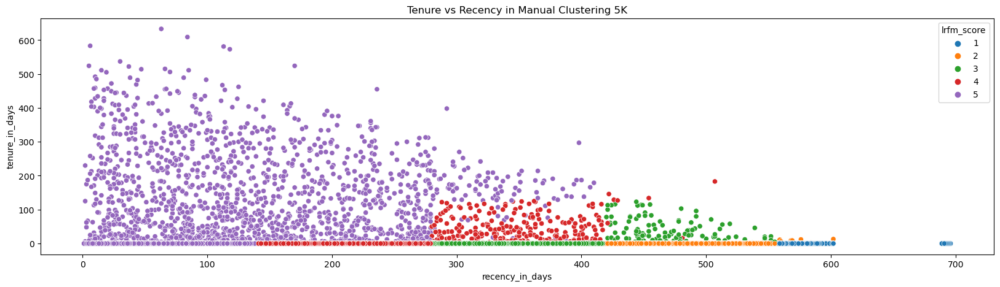

In [ ]:
plt.figure(figsize=(20,5))
sns.scatterplot(
    data=df_cluster_lrfm_manual,
    x='recency_in_days',
    y='tenure_in_days',
    hue='lrfm_score'
    )
plt.title('Tenure vs Recency in Manual Clustering 5K')
plt.show()

Berdasarkan pemetaan pada grafik 3D dan scatterplot 2D, dapat diidentifikasi bahwa:

- **Cluster 1** : customer yang tenure nya sangat sebentar (dibawah 100 hari), sudah lama tidak melakukan transaksi (diatas 500 hari yang lalu), melakukan transaksi hanya 1x, dengan spending yang sangat rendah.

- **Cluster 2** : customer yang tenure nya sangat sebentar (dibawah 100 hari), cukup lama tidak melakukan transaksi (diatas 400 hari yang lalu), melakukan transaksi 1 hingga 2 kali (tetapi mayoritas 1x), dengan spending yang rendah.

- **Cluster 3** : customer yang tenure nya cukup sebentar (dibawah 200 hari), cukup lama tidak melakukan transaksi (diatas 250 hari yang lalu), melakukan transaksi 1 hingga 2 kali (tetapi mayoritas 1x), dengan spending yang rendah.

- **Cluster 4** : customer yang tenure nya cukup sebentar (dibawah 200 hari), cukup recent melakukan transaksi (diatas 100 hari yang lalu), melakukan transaksi 1 hingga 2 kali, dengan spending yang cukup tinggi.

- **Cluster 5** : customer yang tenure nya bervariasi (ada yang hingga 600 hari), cukup recent melakukan transaksi (tetapi bervariasi), melakukan transaksi bervariasi jumlahnya, dengan spending yang bervariasi juga (ada yang tinggi).

***Silhouette Score***

In [ ]:
X_lrfm_no_ml = df_cluster_lrfm_manual[['customer_unique_id', 'tenure_in_days', 'recency_in_days', 'frequency','payment_value']].copy().set_index('customer_unique_id')

In [ ]:
scaler = RobustScaler()
X_lrfm_no_ml_scaled = scaler.fit_transform(X_lrfm_no_ml)

In [ ]:
lrfm_no_ml_labels = np.array(df_cluster_lrfm_manual['lrfm_score'].to_list())

In [ ]:
sil_score_lrfm_no_ml = (silhouette_score(X_lrfm_no_ml_scaled, lrfm_no_ml_labels, random_state = 42))
sil_score_lrfm_no_ml

-0.2039509825857462

    Dalam kasus clustering manual berdasarkan LRFM, nilai silhouette score yang diperoleh adalah -0.2039509825857462. Hal ini menunjukkan bahwa titik data cenderung ditempatkan dalam klaster yang salah atau memiliki tingkat keterpisahan yang rendah dengan klaster tempat ia ditempatkan. Dapat disimpulkan juga bahwa klasterisasi yang digunakan mungkin tidak optimal atau ada penyebaran yang signifikan antara klaster yang ada. Bisa dilihat juga dari grafik yang telah dibuat sebelumnya, bahwa banyak sekali overlapping antara satu cluster dengan cluster lainnya. Maka dari itu, clustering manual ini dapat dikatakan tidak baik untuk digunakan pengelompokkan customer berdasarkan LRFM nya.

### **K-Means Clustering**

Pada bagian ini dilakukan clustering dengan menggunakan algoritma K-Means, dengan pembagian jumlah cluster yang telah ditentukan yaitu 5 cluster. Pembagian ini disesuaikand dengan business practice di industry retail dan juga sumber academic paper seperti yang ada pada link ini: https://www.researchgate.net/publication/315979555_LRFMP_model_for_customer_segmentation_in_the_grocery_retail_industry_a_case_study

Secara terpisah, sudah dilakukan juga percobaan looping/tuning untuk best cluster. Akan tetapi, berdasarkan hasil looping, ditemukan bahwa dengan dataset yang ada, jumlah cluster yang terbaik adalah 10 cluster (silhoutte score = 1, dengan kata lain sempurna). Akan tetapi, jumlah cluster sebanyak ini sangat jarang ditemukan untuk pengelompokkan pelanggan di industry retail. Maka dari itu, jumlah cluster yang digunakan adalah yang telah ditetapkan sebelumnya yaitu 5 cluster.

In [ ]:
scaler = RobustScaler()

In [ ]:
X_clustering = df_lrfm_score.drop(columns='lrfm_score').set_index('customer_unique_id')
X_clustering_scaled = scaler.fit_transform(X_clustering)

In [ ]:
kmean_5k = KMeans(n_clusters=5, random_state=42, n_init='auto')
kmean_5k.fit(X_clustering_scaled)
cluster_kmeans5 = kmean_5k.labels_

In [ ]:
X_clustering['cluster_lrfm'] = cluster_kmeans5
X_clustering = X_clustering.reset_index()
X_clustering.head()

,customer_unique_id,length_score,recency_score,frequency_score,monetary_score,cluster_lrfm
0,861eff4711a542e4b93843c6dd7febb0,1,2,1,1,1
1,060e732b5b29e8181a18229c7b0b2b5e,1,5,1,1,2
2,259dac757896d24d7702b9acbbff3f3c,1,4,1,1,0
3,07d190f123147d9e89d4b922543d7948,1,5,1,1,2
4,332cf4e83e16004ba7dca932ce82475b,1,2,1,1,1


In [ ]:
df_cluster = X_clustering[['customer_unique_id','cluster_lrfm']]

In [ ]:
df_clustering = pd.merge(left=df_lrfm,right=df_cluster,on='customer_unique_id',how='left')
df_clustering

,customer_unique_id,tenure_in_days,recency_in_days,frequency,payment_value,cluster_lrfm
0,861eff4711a542e4b93843c6dd7febb0,0,471,1,146.87,1
1,060e732b5b29e8181a18229c7b0b2b5e,0,103,1,157.73,2
2,259dac757896d24d7702b9acbbff3f3c,0,170,1,173.30,0
3,07d190f123147d9e89d4b922543d7948,0,53,1,315.75,2
4,332cf4e83e16004ba7dca932ce82475b,0,515,1,146.21,1
...,...,...,...,...,...,...
92082,e4469e5047c00b0188885853d357d2ab,0,88,1,97.48,2
92083,1b553902a5bbe6ee54a3aaa7cbfb6816,0,470,1,124.52,1
92084,f979a07fc18b2af3780a796ba14b96f4,0,326,1,54.09,3
92085,d8bee9ec375c3a0f9ef8ed7456a51dcd,0,581,1,209.06,1


***Silhouette Score***

In [ ]:
X_lrfm_kmeans = df_clustering[['customer_unique_id', 'tenure_in_days', 'recency_in_days', 'frequency','payment_value']].copy().set_index('customer_unique_id')

In [ ]:
scaler = RobustScaler()
X_lrfm_kmeans_scaled = scaler.fit_transform(X_lrfm_kmeans)

In [ ]:
lrfm_kmeans_labels = np.array(df_clustering['cluster_lrfm'].to_list())

In [ ]:
sil_score_lrfm_kmeans = (silhouette_score(X_lrfm_kmeans_scaled, lrfm_kmeans_labels, random_state = 42))
sil_score_lrfm_kmeans

0.07313490897748755

In [ ]:
df_sil_score_lrfm_clustering = pd.DataFrame()
df_sil_score_lrfm_clustering['sil_score_manual'] = [sil_score_lrfm_no_ml]
df_sil_score_lrfm_clustering['sil_score_kmeans'] = [sil_score_lrfm_kmeans]
df_sil_score_lrfm_clustering

,sil_score_manual,sil_score_kmeans
0,-0.203951,0.073135


    Dalam kasus clustering menggunakan algoritma K-Means berdasarkan nilai LRFM customer, nilai silhouette score yang diperoleh adalah 0.07313490897748755. Hal ini menunjukkan bahwa titik data tersebut cenderung memiliki tingkat keterpisahan yang rendah dengan klaster tempat ia ditempatkan, namun secara keseluruhan masih cenderung cocok dalam klasternya. Meskipun nilainya positif, nilai sil score yang mendekati nol menandakan bahwa pemisahan antara klaster tidak terlalu jelas dan ada sejumlah tumpang tindih antara klaster.

    Akan tetapi, nilai silhouette score menggunakan algoritma K-Means sudah mengalami peningkatan yang cukup signifikan dibanding dengan clustering manual. Maka dari itu, dapat disimpulkan bahwa metode yang lebih baik untuk mengelompokkan customer berdasarkan LRFM score nya adalah metode K-Means.


In [ ]:
fig = px.scatter_3d(
    df_clustering, 
    y= 'recency_in_days', 
    x= 'frequency', 
    z= 'payment_value',
    color= df_clustering['cluster_lrfm'].astype(str),
)

fig.update_traces(marker_size = 2)

fig.update_layout(
    autosize=False,
    width=1000,
    height=500,
    paper_bgcolor="white",
)

fig.show()

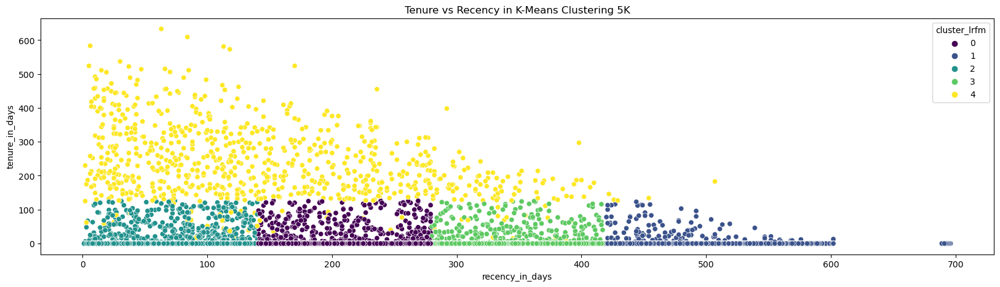

In [ ]:
plt.figure(figsize=(20,5))
sns.scatterplot(
    data=df_clustering,
    x='recency_in_days',
    y='tenure_in_days',
    hue='cluster_lrfm',
    palette='viridis'
    )
plt.title('Tenure vs Recency in K-Means Clustering 5K')
plt.show()

Berdasarkan pemetaan pada grafik 3D dan scatterplot 2D, dapat diidentifikasi bahwa:

- **Cluster 4** : customer dengan tenure lama (diatas 100 hari), melakukan pembelian terakhir cukup bervariasi (ada yang recent ada yang sudah lama) melakukan transaksi lebih dari 2x, dan memiliki nilai spending yang cukup rendah </br>

- **Cluster 2**: customer dengan tenure sebentar (dibawah 100 hari), melakukan pembelian terakhir cukup dekat (paling lambat dibawah 150 hari yang lalu), melakukan transaksi 1 hingga 2 kali, dan memiliki nilai spending bervariasi dan ada yang tinggi (proporsi normal) </br>

- **Cluster 0** : customer dengan tenure sebentar (dibawah 100 hari), melakukan pembelian terakhir cukup dekat (antara 150-280 hari yang lalu) melakukan transaksi 1 hingga 2 kali, dan memiliki nilai spending bervariasi dan ada yang tinggi (proporsi normal) </br>

- **Cluster 3** : customer dengan tenure sebentar (dibawah 100 hari), melakukan pembelian terakhir cukup lama (antara 280-420 hari yang lalu) melakukan transaksi 1 hingga 2 kali, dan memiliki nilai spending bervariasi dan ada yang sangat tinggi</br>

- **Cluster 1** : customer dengan tenure sebentar (dibawah 100 hari), melakukan pembelian terakhir cukup lama (di atas 420 hari yang lalu), melakukan transaksi 1 hingga 2 kali,  dan memiliki nilai spending paling rendah</br>


***Customer Lifetime Value Calculation***

Customer Lifetime Value atau disingkat CLV adalah ukuran yang digunakan untuk memvaluasi nilai monetaris yang dihasilkan oleh pelanggan selama mereka menjadi customer. Tujuan dilakukan nya analisa ini adalah untuk mengidentifikasi dan memahami customer dengan karakteristik apa yang bernilai tinggi dalam jangka panjang.

In [ ]:
df_clv = df_lrfm.copy()
df_clv['CLV'] = df_clv['payment_value']*df_clv['tenure_in_days']

In [ ]:
df_clv_cluster = pd.merge(left=df_clv,right=df_cluster,on='customer_unique_id',how='left')
df_clv_cluster

,customer_unique_id,tenure_in_days,recency_in_days,frequency,payment_value,CLV,cluster_lrfm
0,861eff4711a542e4b93843c6dd7febb0,0,471,1,146.87,0.0,1
1,060e732b5b29e8181a18229c7b0b2b5e,0,103,1,157.73,0.0,2
2,259dac757896d24d7702b9acbbff3f3c,0,170,1,173.30,0.0,0
3,07d190f123147d9e89d4b922543d7948,0,53,1,315.75,0.0,2
4,332cf4e83e16004ba7dca932ce82475b,0,515,1,146.21,0.0,1
...,...,...,...,...,...,...,...
92082,e4469e5047c00b0188885853d357d2ab,0,88,1,97.48,0.0,2
92083,1b553902a5bbe6ee54a3aaa7cbfb6816,0,470,1,124.52,0.0,1
92084,f979a07fc18b2af3780a796ba14b96f4,0,326,1,54.09,0.0,3
92085,d8bee9ec375c3a0f9ef8ed7456a51dcd,0,581,1,209.06,0.0,1


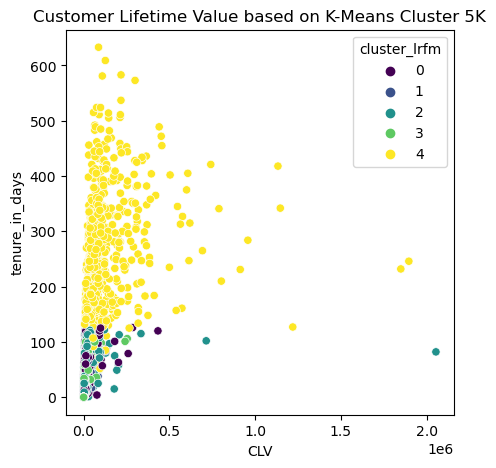

In [ ]:
plt.figure(figsize=(5,5))
sns.scatterplot(
    data=df_clv_cluster,
    x='CLV',
    y='tenure_in_days',
    hue='cluster_lrfm',
    palette='viridis'
    )
plt.title('Customer Lifetime Value based on K-Means Cluster 5K')
plt.show()

    Berdasarkan CLV nya, dapat dilihat bahwa nilai CLV tertinggi berada pada Cluster 4, sedangkan untuk cluster lainnya memiliki nilai CLV yang hampir serupa. Dapat disimpulkan bahwa Cluster 4 merupakan cluster terbaik (Very High Value Customer). Karena karakteristiknya hampir serupa, maka urutan cluster lainnya diurutkan berdasarkan recency nya, yaitu dari yang paling dekat dengan data diambil hingga paling lama.

- **Cluster 4** akan dinamakan Cluster Very High Value Customer.

- **Cluster 2** akan dinamakan Cluster High Value Customer.

- **Cluster 0** akan dinamakan Cluster Medium Value Customer.

- **Cluster 3** akan dinamakan Cluster Low Value Customer.

- **Cluster 1** akan dinamakan Cluster Very Low Value Customer.

In [ ]:
df_clustering['cluster_lrfm'] = df_clustering['cluster_lrfm'].replace({
    4 : "Very High Value Customer",
    2 : "High Value Customer",
    0 : "Medium Value Customer",
    3 : "Low Value Customer",
    1 : "Very Low Value Customer"
})

df_clustering.head()

,customer_unique_id,tenure_in_days,recency_in_days,frequency,payment_value,cluster_lrfm
0,861eff4711a542e4b93843c6dd7febb0,0,471,1,146.87,Very Low Value Customer
1,060e732b5b29e8181a18229c7b0b2b5e,0,103,1,157.73,High Value Customer
2,259dac757896d24d7702b9acbbff3f3c,0,170,1,173.30,Medium Value Customer
3,07d190f123147d9e89d4b922543d7948,0,53,1,315.75,High Value Customer
4,332cf4e83e16004ba7dca932ce82475b,0,515,1,146.21,Very Low Value Customer


In [ ]:
df_cluster_lrfm = df_clustering[['customer_unique_id','cluster_lrfm']].copy()
df_cluster_lrfm.head()

,customer_unique_id,cluster_lrfm
0,861eff4711a542e4b93843c6dd7febb0,Very Low Value Customer
1,060e732b5b29e8181a18229c7b0b2b5e,High Value Customer
2,259dac757896d24d7702b9acbbff3f3c,Medium Value Customer
3,07d190f123147d9e89d4b922543d7948,High Value Customer
4,332cf4e83e16004ba7dca932ce82475b,Very Low Value Customer


## **Geographic Clustering**

Clustering ini bertujuan untuk mengelompokkan wilayah geografis atau area berdasarkan karakteristik tertentu. Dalam konteks proyek ini, digunakan data demografis dan geografis pelanggan serta penjual untuk mengidentifikasi pola dan korelasi antara area geografis tertentu dengan perilaku pembelian atau penjualan. Dengan menggunakan teknik clustering, akan dibentuk kelompok-kelompok atau cluster berdasarkan kesamaan geografis, dan kemudian menganalisis atribut-atribut seperti jumlah pelanggan dan total penjualan di setiap cluster.


In [ ]:
customer_count = total_customer_by_area.rename(columns={'customer_unique_id':'total_customer'}).reset_index(drop=True)
customer_count.head()

,customer_state,total_customer
0,Acre,74
1,Alagoas,383
2,Amapá,66
3,Amazonas,140
4,Bahia,3120


In [ ]:
seller_count = total_seller_by_area.rename(columns={'seller_id':'total_seller'}).reset_index(drop=True)
seller_count.head()

,seller_state,total_seller
0,Amazonas,1
1,Bahia,18
2,Ceará,12
3,Distrito Federal,30
4,Espírito Santo,22


In [ ]:
location_count = pd.merge(left=customer_count,right=seller_count,left_on='customer_state',right_on='seller_state',how='left')
location_count = location_count.drop(columns='seller_state').rename(columns={'customer_state':'state_name'})
location_count['total_seller'] = location_count['total_seller'].fillna(0).astype(int)
location_count.head()

,state_name,total_customer,total_seller
0,Acre,74,0
1,Alagoas,383,0
2,Amapá,66,0
3,Amazonas,140,1
4,Bahia,3120,18


In [ ]:
np.percentile(location_count['total_customer'], [0,25,75])

array([  38.,  355., 2555.])

In [ ]:
np.percentile(location_count['total_seller'], [0,25,75])

array([ 0. ,  1. , 33.5])

In [ ]:
customer_area_boundaries = [38,  355, 2555, float('inf')]
seller_area_boundaries = [0,  1 , 33.5, float('inf')]
area_scores = [1,2,3]

location_count['customer_area_score'] = pd.cut(location_count['total_customer'], bins=customer_area_boundaries, labels=area_scores, right=False)
location_count['seller_area_score'] = pd.cut(location_count['total_seller'], bins=seller_area_boundaries, labels=area_scores, right=False)


location_count.head()


,state_name,total_customer,total_seller,customer_area_score,seller_area_score
0,Acre,74,0,1,1
1,Alagoas,383,0,2,1
2,Amapá,66,0,1,1
3,Amazonas,140,1,1,2
4,Bahia,3120,18,3,2


### **Manual Clustering**

Pada bagian ini, pengelompokkan wilayah dilakukan secara manual dengan memberikan scoring terhadap wilayah berdasarkan jumlah pelanggan yang ada di daerah tersebut dan jumlah penjual yang ada di daerah tersebut. Skala skor nya adalah 1 hingga 3, dimana semakin besar skor nya, semakin banyak jumlah pelanggan dan penjualnya.

In [ ]:
category_columns = ['customer_area_score', 'seller_area_score']  
location_count[category_columns] = location_count[category_columns].astype('int')  
location_count['area_score'] = ((location_count['customer_area_score'] + location_count['seller_area_score'])/2)

location_count.head()

,state_name,total_customer,total_seller,customer_area_score,seller_area_score,area_score
0,Acre,74,0,1,1,1.0
1,Alagoas,383,0,2,1,1.5
2,Amapá,66,0,1,1,1.0
3,Amazonas,140,1,1,2,1.5
4,Bahia,3120,18,3,2,2.5


In [ ]:
np.percentile(location_count['area_score'], [0,25,75])

array([1. , 1.5, 2.5])

In [ ]:
area_boundaries = [1, 1.5, 2.5, float('inf')]
area_scores = [1,2,3]

location_count['area_score'] = pd.cut(location_count['area_score'], bins=area_boundaries, labels=area_scores, right=False)

location_count.head()


,state_name,total_customer,total_seller,customer_area_score,seller_area_score,area_score
0,Acre,74,0,1,1,1
1,Alagoas,383,0,2,1,2
2,Amapá,66,0,1,1,1
3,Amazonas,140,1,1,2,2
4,Bahia,3120,18,3,2,3


In [ ]:
# value for data
geojson_data = r'br_states.geojson'  

# Create a Folium map centered on Brazil
brazil_map_area = folium.Map(location=[-14.2350, -51.9253], zoom_start=4.5)

# Add the Choropleth layer
chor_area = folium.Choropleth(
    geo_data=geojson_data,
    name='choropleth',
    data=location_count,
    columns=['state_name', 'area_score'],
    key_on='feature.properties.nome',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Area Score',
).add_to(brazil_map_area)

# Add markers with state names as labels
gdf_area = gpd.read_file(geojson_data)  # Read the GeoJSON data into a GeoDataFrame
for _, row in gdf_area.iterrows():
    state_name = row['nome']
    centroid = row['geometry'].centroid
    lat, lon = centroid.y, centroid.x
    folium.Marker(
        location=[lat, lon],
        icon=folium.DivIcon(html=f'<div style="font-weight:bold">{state_name}</div>')
    ).add_to(brazil_map_area)

# Display the map
brazil_map_area


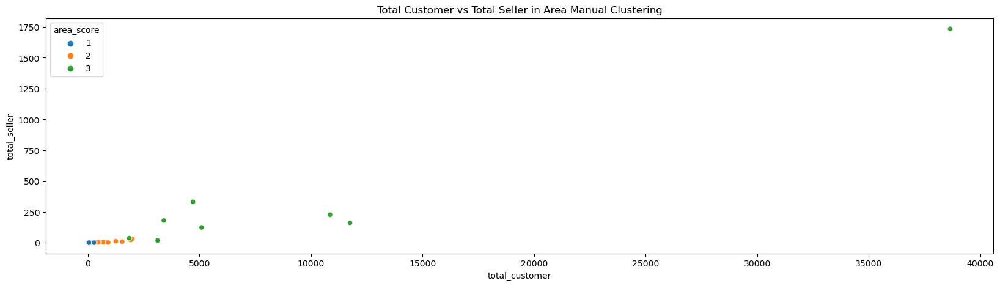

In [ ]:
plt.figure(figsize=(20,5))
sns.scatterplot(
    data=location_count,
    x='total_customer',
    y='total_seller',
    hue='area_score',
    )
plt.title('Total Customer vs Total Seller in Area Manual Clustering')

plt.show()

Berdasarkan pemetaan pada grafik area dan scatterplot 2D, dapat diidentifikasi bahwa:

- **Cluster 1** : area yang jumlah pelanggan dan jumlah penjualnya banyak.

- **Cluster 2** : area yang jumlah pelanggannya cukup banyak, tetapi jumlah penjualnya sedikit.

- **Cluster 3** : area yang jumlah pelanggan dan jumlah penjualnya sedikit (bahkan ada yang kosong).

***Silhouette Score***

In [ ]:
X_area_no_ml = location_count[['state_name','total_customer','total_seller']].copy().set_index('state_name')
X_area_no_ml.head()

,total_customer,total_seller
state_name,,
Acre,74,0
Alagoas,383,0
Amapá,66,0
Amazonas,140,1
Bahia,3120,18


In [ ]:
X_area_no_ml_scaled = scaler.fit_transform(X_area_no_ml)

In [ ]:
area_no_ml_labels = np.array(location_count['area_score'].to_list())

In [ ]:
sil_score_area_no_ml = (silhouette_score(X_area_no_ml_scaled, area_no_ml_labels, random_state = 42))
sil_score_area_no_ml

-0.10328163012787804

    Dalam kasus clustering manual berdasarkan wilayah, nilai silhouette score yang diperoleh adalah -0.10328163012787804. Hal ini menunjukkan bahwa titik data cenderung ditempatkan dalam klaster yang salah atau memiliki tingkat keterpisahan yang rendah dengan klaster tempat ia ditempatkan. Dapat disimpulkan juga bahwa klasterisasi yang digunakan mungkin tidak optimal atau ada penyebaran yang signifikan antara klaster yang ada. Bisa dilihat juga dari grafik yang telah dibuat sebelumnya, bahwa banyak sekali overlapping antara satu cluster dengan cluster lainnya. Maka dari itu, clustering manual ini dapat dikatakan tidak baik untuk digunakan pengelompokkan area berdasarkan jumlah pelanggan dan pelanggan nya.

### **K-Means Clustering**

Pada bagian ini dilakukan clustering dengan menggunakan algoritma K-Means, dengan pembagian jumlah cluster yang diiterasi dengan forloop agar diketahui berapa jumlah cluster yang terbaik untuk pengelompokkan area nya.

In [ ]:
X_area_clustering = location_count[['state_name','total_customer','total_seller']].copy().set_index('state_name')
X_area_clustering.head()

,total_customer,total_seller
state_name,,
Acre,74,0
Alagoas,383,0
Amapá,66,0
Amazonas,140,1
Bahia,3120,18


In [ ]:
# scaling
X_area_clustering_scaled = scaler.fit_transform(X_area_clustering)

In [ ]:
list_n_clusters = range(2,16)
list_inertia = []
list_sil = []


for i in list_n_clusters:

    # define algo
    kmeans = KMeans(n_clusters=i, random_state=42,n_init='auto') 

    # fit
    kmeans.fit(X_area_clustering_scaled)

    # kmeans memberi nama cluster pada tiap data poin
    kmeans.labels_ 

    # inertia
    inertia = kmeans.inertia_
    cluster_name = kmeans.labels_
    sil = (silhouette_score(X_area_clustering_scaled, cluster_name, random_state = 42))

    list_inertia.append(inertia)
    list_sil.append(sil)

In [ ]:
df_kmeans = pd.DataFrame()
df_kmeans['n_clusters'] = list_n_clusters
df_kmeans['inertia'] = list_inertia
df_kmeans['silhouette_score'] = list_sil

df_kmeans.sort_values(by='silhouette_score',ascending=False)

,n_clusters,inertia,silhouette_score
0,2,223.128727,0.913025
1,3,41.218190,0.784953
4,6,5.133976,0.617667
3,5,22.968475,0.590538
5,7,2.988843,0.584278
2,4,37.281613,0.573757
6,8,1.207196,0.550828
9,11,0.219944,0.386169
7,9,0.752572,0.371875
8,10,0.431792,0.362251


    Berdasarkan hasil iterasi, ditemukan bahwa nilai silhouette score paling baik berada pada clustering dengan jumlah cluster 2K. Maka dari itu, saat ini dicoba untuk dianalisa lebih lanjut menggunakan 2 cluster.

In [ ]:
# modeling
kmean_2k = KMeans(n_clusters=2, random_state=42, n_init='auto')
kmean_2k.fit(X_area_clustering_scaled)

# labels
cluster_kmeans2 = kmean_2k.labels_

In [ ]:
X_area_clustering['cluster_2k'] = cluster_kmeans2
X_area_clustering = X_area_clustering.reset_index()
X_area_clustering.head()

,state_name,total_customer,total_seller,cluster_2k
0,Acre,74,0,0
1,Alagoas,383,0,0
2,Amapá,66,0,0
3,Amazonas,140,1,0
4,Bahia,3120,18,0


In [ ]:
X_area_clustering['cluster_2k'].value_counts()

0    26
1     1
Name: cluster_2k, dtype: int64

In [ ]:
# value for data
geojson_data = r'br_states.geojson'  

# Create a Folium map centered on Brazil
brazil_map_area_2cluster = folium.Map(location=[-14.2350, -51.9253], zoom_start=4.5)

# Add the Choropleth layer
chor_area_2k = folium.Choropleth(
    geo_data=geojson_data,
    name='choropleth',
    data=X_area_clustering,
    columns=['state_name', 'cluster_2k'],
    key_on='feature.properties.nome',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Area Cluster',
).add_to(brazil_map_area_2cluster)

# Add markers with state names as labels
gdf_area_2k = gpd.read_file(geojson_data)  # Read the GeoJSON data into a GeoDataFrame
for _, row in gdf_area_2k.iterrows():
    state_name = row['nome']
    centroid = row['geometry'].centroid
    lat, lon = centroid.y, centroid.x
    folium.Marker(
        location=[lat, lon],
        icon=folium.DivIcon(html=f'<div style="font-weight:bold">{state_name}</div>')
    ).add_to(brazil_map_area_2cluster)

# Display the map
brazil_map_area_2cluster


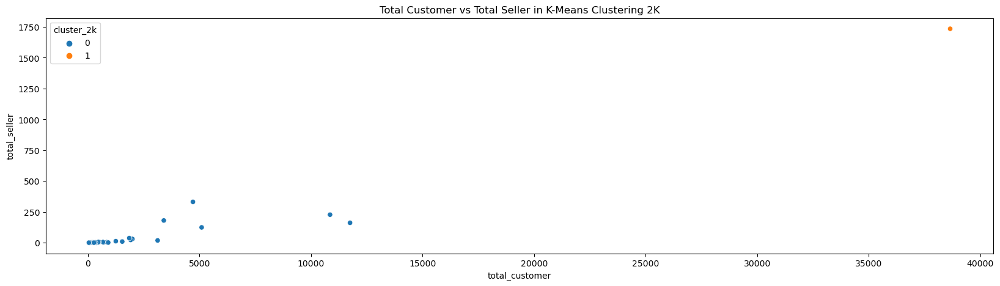

In [ ]:
plt.figure(figsize=(20,5))
sns.scatterplot(
    data=X_area_clustering,
    x='total_customer',
    y='total_seller',
    hue='cluster_2k',
    )
plt.title('Total Customer vs Total Seller in K-Means Clustering 2K')

plt.show()

    Berdasarkan pemetaan pada grafik area dan scatterplot 2D, dapat dilihat bahwa pada clustering dengan 2 cluster, terdapat jumlah anggota cluster yang sangat berbeda. Cluster 1 hanya memiliki 1 Area (Sao Paulo), sedangkan sisanya masuk ke Cluster 0. Hal ini disebabkan karena Sao Paulo memang memiliki banyak pelanggan dan penjual yang sangat tinggi (berbeda secara signifikan) dibandingkan dengan area lainnya. Maka dari itu, clustering ini kurang informatif untuk keperluan bisnis. Sehingga, perlu dicari jumlah cluster lain agar bisa lebih membantu analisa bisnis. Pada proyek ini dicoba pilihan kedua berdasarkan nilai silhouette tertinggi ke-2 yaitu 3 cluster.

In [ ]:
# modeling
kmean_3k = KMeans(n_clusters=3, random_state=42, n_init='auto')
kmean_3k.fit(X_area_clustering_scaled)

# labels
cluster_kmeans3 = kmean_3k.labels_

In [ ]:
X_area_clustering['cluster_3k'] = cluster_kmeans3
X_area_clustering.head()

,state_name,total_customer,total_seller,cluster_2k,cluster_3k
0,Acre,74,0,0,0
1,Alagoas,383,0,0,0
2,Amapá,66,0,0,0
3,Amazonas,140,1,0,0
4,Bahia,3120,18,0,0


In [ ]:
X_area_clustering['cluster_3k'].value_counts()

0    21
2     5
1     1
Name: cluster_3k, dtype: int64

***Silhouette Score***

In [ ]:
sil_score_area_kmeans_3k = df_kmeans[df_kmeans['n_clusters']==3]['silhouette_score'].loc[1]

In [ ]:
df_sil_score_area_clustering = pd.DataFrame()
df_sil_score_area_clustering['sil_score_manual'] = [sil_score_area_no_ml]
df_sil_score_area_clustering['sil_score_kmeans'] = [sil_score_area_kmeans_3k]
df_sil_score_area_clustering

,sil_score_manual,sil_score_kmeans
0,-0.103282,0.784953


    Dalam kasus clustering wilayah menggunakan algoritma K-Means dengan jumlah cluster 3 clusters, nilai silhouette score yang diperoleh adalah 0.784953. Hal ini menunjukkan bahwa klasterisasi yang dilakukan sangat baik dan titik data dalam klaster tersebut memiliki tingkat keterpisahan yang tinggi. Nilai Silhouette Score yang mendekati 1 menunjukkan bahwa titik data cenderung sangat cocok dengan klaster tempat ia ditempatkan dan memiliki tingkat kesamaan yang tinggi dengan anggota klaster lainnya.

    Silhouette score ini juga mengindikasikan bahwa pengelompokan data tersebut relatif homogen dan kompak dalam klasternya. Hal ini menandakan bahwa data-data yang berada dalam klaster tersebut memiliki karakteristik yang mirip satu sama lain, dan perbedaan antara klaster sangat jelas.

    Nilai silhouette score menggunakan algoritma K-Means sudah mengalami peningkatan yang cukup signifikan dibanding dengan clustering manual. Maka dari itu, dapat disimpulkan bahwa metode yang lebih baik untuk mengelompokkan area berdasarkan jumlah pelanggan dan penjual nya adalah metode K-Means.

In [ ]:
# value for data
geojson_data = r'br_states.geojson'  

# Create a Folium map centered on Brazil
brazil_map_3cluster = folium.Map(location=[-14.2350, -51.9253], zoom_start=4.5)

# Add the Choropleth layer
chor_area_3k = folium.Choropleth(
    geo_data=geojson_data,
    name='choropleth',
    data=X_area_clustering,
    columns=['state_name', 'cluster_3k'],
    key_on='feature.properties.nome',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.5,
    legend_name='Area Cluster',
).add_to(brazil_map_3cluster)

# Add markers with state names as labels
gdf_area_3k = gpd.read_file(geojson_data)  # Read the GeoJSON data into a GeoDataFrame
for _, row in gdf_area_3k.iterrows():
    state_name = row['nome']
    centroid = row['geometry'].centroid
    lat, lon = centroid.y, centroid.x
    folium.Marker(
        location=[lat, lon],
        icon=folium.DivIcon(html=f'<div style="font-weight:bold">{state_name}</div>')
    ).add_to(brazil_map_3cluster)

# Display the map
brazil_map_3cluster


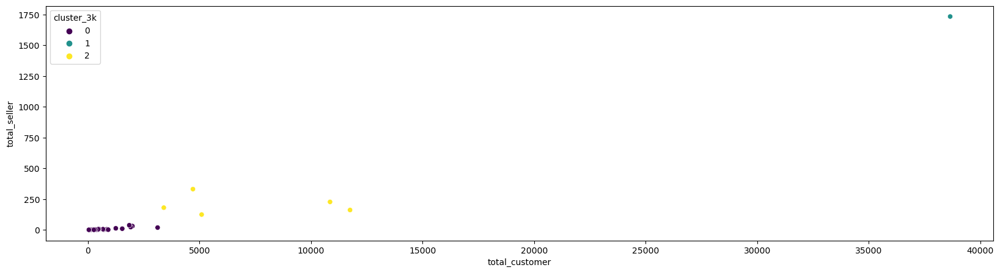

In [ ]:
plt.figure(figsize=(20,5))
sns.scatterplot(
    data=X_area_clustering,
    x='total_customer',
    y='total_seller',
    hue='cluster_3k',
    palette='viridis'
    )

plt.show()

Berdasarkan pemetaan pada grafik area dan scatterplot 2D, dapat diidentifikasi bahwa:

- **Cluster 0** : area yang jumlah pelanggan dan jumlah penjualnya sedikit (bahkan ada yang kosong). Cluster ini akan dinamakan Cluster Outlying Market.

- **Cluster 2** : area yang jumlah pelanggannya cukup banyak, tetapi jumlah penjualnya sedikit. Cluster ini akan dinamakan Cluster Secondary Market.

- **Cluster 1** : area yang jumlah pelanggan dan jumlah penjualnya banyak. Cluster ini akan dinamakan Cluster Major Market.

In [ ]:
X_area_clustering['cluster3k_name'] = X_area_clustering['cluster_3k'].replace({
    0: 'Outlying Market',
    2: 'Secondary Market',
    1: 'Major Market'
})

X_area_clustering

,state_name,total_customer,total_seller,cluster_2k,cluster_3k,cluster3k_name
0,Acre,74,0,0,0,Outlying Market
1,Alagoas,383,0,0,0,Outlying Market
2,Amapá,66,0,0,0,Outlying Market
3,Amazonas,140,1,0,0,Outlying Market
4,Bahia,3120,18,0,0,Outlying Market
5,Ceará,1245,12,0,0,Outlying Market
6,Distrito Federal,1990,30,0,0,Outlying Market
7,Espírito Santo,1912,22,0,0,Outlying Market
8,Goiás,1850,37,0,0,Outlying Market
9,Maranhão,694,1,0,0,Outlying Market


In [ ]:
state_cluster = X_area_clustering[['state_name','cluster3k_name']].copy()
state_cluster.head()

,state_name,cluster3k_name
0,Acre,Outlying Market
1,Alagoas,Outlying Market
2,Amapá,Outlying Market
3,Amazonas,Outlying Market
4,Bahia,Outlying Market


## **Combining LRFM and Area Cluster**

Pada bagian ini dilakukan pengelompokkan customer berdasarkan LRFM cluster nya dan Area cluster nya. Tujuan dari penggabungan ini adalah untuk menentukan kelompok yang tepat dalam pembuatan sistem rekomendasi kategori produk yang akan digunakan untuk keperluan marketing activity.

In [ ]:
df_customer_cluster = df.groupby(['customer_unique_id','customer_state','product_category_name_english'])[['order_item_id']].sum().reset_index()

df_customer_cluster.head()

,customer_unique_id,customer_state,product_category_name_english,order_item_id
0,0000366f3b9a7992bf8c76cfdf3221e2,São Paulo,bed_bath_table,1.0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,São Paulo,health_beauty,1.0
2,0000f46a3911fa3c0805444483337064,Santa Catarina,stationery,1.0
3,0000f6ccb0745a6a4b88665a16c9f078,Pará,telephony,1.0
4,0004aac84e0df4da2b147fca70cf8255,São Paulo,telephony,1.0


In [ ]:
df_customer_cluster = pd.merge(left=df_customer_cluster, right=df_cluster_lrfm, on='customer_unique_id', how='left')

In [ ]:
df_cluster_for_recsys = pd.merge(
    left=df_customer_cluster,
    right=state_cluster,
    left_on='customer_state',
    right_on='state_name',
    how='left')

df_cluster_for_recsys = df_cluster_for_recsys.rename(columns={'cluster3k_name':'cluster_area'})

df_cluster_for_recsys.head()

,customer_unique_id,customer_state,product_category_name_english,order_item_id,cluster_lrfm,state_name,cluster_area
0,0000366f3b9a7992bf8c76cfdf3221e2,São Paulo,bed_bath_table,1.0,High Value Customer,São Paulo,Major Market
1,0000b849f77a49e4a4ce2b2a4ca5be3f,São Paulo,health_beauty,1.0,High Value Customer,São Paulo,Major Market
2,0000f46a3911fa3c0805444483337064,Santa Catarina,stationery,1.0,Very Low Value Customer,Santa Catarina,Secondary Market
3,0000f6ccb0745a6a4b88665a16c9f078,Pará,telephony,1.0,Low Value Customer,Pará,Outlying Market
4,0004aac84e0df4da2b147fca70cf8255,São Paulo,telephony,1.0,Low Value Customer,São Paulo,Major Market


In [ ]:
pivot_cluster = pd.pivot_table(
    data=df_cluster_for_recsys,
    index='cluster_lrfm',
    columns='cluster_area',
    values='customer_unique_id',
    aggfunc='nunique',
    margins=True
)
pivot_cluster

cluster_area,Major Market,Outlying Market,Secondary Market,All
cluster_lrfm,,,,
High Value Customer,13137,5156,10386,28674
Low Value Customer,7255,3876,7432,18560
Medium Value Customer,12538,5736,11860,30131
Very High Value Customer,347,130,328,794
Very Low Value Customer,5366,2790,5776,13928
All,38643,17688,35782,92087


# **Recommendation System**

Pada proyek ini, dilakukan pembuatan recommendation system khususnya untuk pelanggan yang tergolong "Very Low Value Customer" dan "Low Value Customer" pada tiap market nya. Proyek ini difokuskan pada cluster tersebut karena pembuatan personalized activity untuk pelanggan yang tidak aktif dapat membantu meningkatkan peluang untuk mengembalikan mereka ke platform dan membuat mereka lebih aktif kembali. Pelanggan yang tidak aktif cenderung tidak pernah berbelanja atau menggunakan layanan platform dalam jangka waktu tertentu, dan ini dapat menjadi masalah bagi bisnis karena kehilangan potensi pendapatan dari pelanggan tersebut.

Berikut adalah beberapa alasan mengapa personalized recommendation penting untuk pelanggan yang tidak aktif:

1) Relevansi: Dengan personalized recommendation, bisnis dapat menyajikan penawaran yang relevan dan menarik berdasarkan riwayat pembelian dan preferensi sebelumnya dari pelanggan. Dengan demikian, pelanggan yang tidak aktif akan lebih cenderung menemukan rekomendasi yang menarik dan sesuai dengan minat mereka, yang dapat mempengaruhi mereka untuk kembali berbelanja.

2) Pengingat dan Pemberitahuan: Personalized recommendation juga dapat berfungsi sebagai pengingat dan pemberitahuan bagi pelanggan yang tidak aktif tentang produk atau layanan yang mungkin menarik bagi mereka. Dengan menunjukkan kepada mereka penawaran menarik yang mereka lewatkan selama ketidakaktifan mereka, bisnis dapat membangkitkan minat dan keinginan untuk kembali berbelanja.

3) Memperkuat Hubungan: Personalized recommendation dapat membantu memperkuat hubungan antara pelanggan dan platform. Dengan menunjukkan kepada pelanggan bahwa bisnis mengingat preferensi dan kebutuhan mereka, ini dapat meningkatkan rasa percaya dan kenyamanan mereka untuk berinteraksi kembali dengan platform.

4) Meningkatkan Retensi: Dengan memberikan rekomendasi yang disesuaikan dengan minat pelanggan, bisnis dapat meningkatkan tingkat retensi pelanggan yang tidak aktif. Pelanggan akan merasa lebih dihargai dan mungkin cenderung tetap setia dengan platform untuk kebutuhan belanja mereka.

5) Peluang Cross-Selling dan Up-Selling: Personalized recommendation juga dapat membuka peluang untuk melakukan cross-selling (menawarkan produk atau layanan tambahan yang relevan dengan pembelian sebelumnya) dan up-selling (menawarkan produk atau layanan yang lebih premium atau lebih mahal). Ini dapat meningkatkan nilai keranjang belanja dan pendapatan dari pelanggan yang tidak aktif.

6) Kompetitivitas: Dalam lingkungan bisnis yang kompetitif, personalized recommendation dapat menjadi keunggulan kompetitif. Dengan menyediakan pengalaman belanja yang lebih personal dan relevan, platform dapat menarik kembali pelanggan yang beralih ke pesaing.

Dengan menggunakan personalized recommendation secara cerdas dan efektif, platform dapat meningkatkan keterlibatan dan interaksi pelanggan, serta memaksimalkan potensi pendapatan dari pelanggan yang tidak aktif. Hal ini merupakan strategi yang sangat penting dalam menjaga pertumbuhan dan kesuksesan bisnis jangka panjang. 

Pada proyek ini, rekomendasi dibangun dengan memprediksi berapa banyak order yang akan dibuat oleh seorang pelanggan terhadap sebuah kategori produk, berdasarkan historikal data penjualan dan pembelian di tiap kategori produk. Karena model digunakan untuk memprediksi jumlah order yang dibuat pelanggan, maka skala Reader yang diset sebagai valid scale adalah 1-10 order, dimana ketika ada order di atas 10 dianggap tidak valid. Pemilihan batas atas 10 order ini didasarkan dengan standard MOQ di industry retail yaitu 10 order per pengiriman, dengan asumsi apabila ada pelanggan yang melakukan order sangat banyak adalah reseller.

Berdasarkan hal ini, maka dilakukan pembuatan sistem rekomendasi kategori produk pada tiap cluster yaitu:

| **Cluster** | **Description** |
| ---           | ---           | 
| **OMVLVC** | Outlying Market - Very Low Value Customer | 
| **SMVLVC** | Secondary Market - Very Low Value Customer  | 
| **MMVLVC** | Major Market - Very Low Value Customer  | 
| **OMLVC** | Outlying Market - Low Value Customer  | 
| **SMLVC** | Secondary Market - Low Value Customer | 
| **MMLVC** | Major Market - Low Value Customer  | 


#### ***List of Functions***

In [ ]:
# Creating Dataframe
def create_dataframe(df, cluster_area, cluster_lrfm):
    filtered_df = df[(df['cluster_area'] == cluster_area) & (df['cluster_lrfm'] == cluster_lrfm)]
    new_df = filtered_df.groupby(['customer_unique_id','product_category_name_english'])[['order_item_id']].sum().reset_index()
    return new_df

# Creating User Matarix
def create_user_matrix(df, index_col, columns_col, values_col):
    pivot_table = df.pivot_table(index=index_col, columns=columns_col, values=values_col)
    return pivot_table

# Creating Surprise Dataset
def create_surprise_dataset(df, order_col):
    min_scale = 1
    max_scale = 10
    reader = Reader(rating_scale=(min_scale, max_scale))
    data = Dataset.load_from_df(df=df, reader=reader)
    return data


## **Cluster Outlying Market - Very Low Value Customer (OMVLVC)**

### **Load Dataset**

In [ ]:
df_omvlvc = create_dataframe(df_cluster_for_recsys, 'Outlying Market', 'Very Low Value Customer')
df_omvlvc.head()

,customer_unique_id,product_category_name_english,order_item_id
0,00115fc7123b5310cf6d3a3aa932699e,sports_leisure,1.0
1,0011805441c0d1b68b48002f1d005526,computers_accessories,1.0
2,002043098f10ba39a4600b6c52fbfe3c,office_furniture,1.0
3,00324c9f4d710e7bac5c5ba679714430,housewares,2.0
4,0049dadc30da6a277c1e9d371df5a66f,housewares,1.0


In [ ]:
omvlvc_user_matrix = create_user_matrix(df_omvlvc, 'customer_unique_id', 'product_category_name_english', 'order_item_id')
omvlvc_user_matrix.head()

product_category_name_english,agro_industry_and_commerce,air_conditioning,art,audio,auto,baby,bed_bath_table,books_general_interest,books_technical,christmas_supplies,computers,computers_accessories,consoles_games,construction_tools_construction,cool_stuff,costruction_tools_garden,drinks,dvds_blu_ray,electronics,fashio_female_clothing,fashion_bags_accessories,fashion_male_clothing,fashion_shoes,fashion_sport,fashion_underwear_beach,fixed_telephony,food,food_drink,furniture_bedroom,furniture_decor,furniture_living_room,garden_tools,health_beauty,home_appliances,home_appliances_2,home_confort,home_construction,housewares,industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,luggage_accessories,market_place,musical_instruments,office_furniture,perfumery,pet_shop,security_and_services,signaling_and_security,small_appliances,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
00115fc7123b5310cf6d3a3aa932699e,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN
0011805441c0d1b68b48002f1d005526,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
002043098f10ba39a4600b6c52fbfe3c,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
00324c9f4d710e7bac5c5ba679714430,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0049dadc30da6a277c1e9d371df5a66f,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### **Dataset Surprise**

In [ ]:
data_omvlvc = create_surprise_dataset(df_omvlvc, 'order_item_id')

### **Dataset Splitting**

In [ ]:
trainset_omvlvc, testset_omvlvc = train_test_split(data=data_omvlvc, test_size=0.2, random_state=42)

### **Hyperparameters Tuning**

Pada bagian ini dilakukan pencarian hyperparameter terbaik untuk kedua model recommendation system yang akan dianalisa, hyperparameter tuning yang digunakan untuk tiap cluster adalah sama.

Hyperparameter Singular Value Decomposition (SVD):

1) n_epochs: Hyperparameter ini mengontrol jumlah iterasi atau epoch yang akan digunakan saat melatih model SVD. 
2) lr_all: Hyperparameter ini adalah learning rate (tingkat pembelajaran) untuk proses pembelajaran model SVD. Learning rate adalah faktor yang menentukan seberapa besar langkah yang akan diambil oleh model saat menyesuaikan bobotnya selama pelatihan. 
3) reg_all: Hyperparameter ini adalah regularisasi yang digunakan untuk mencegah overfitting dalam model. Regularisasi membantu menghindari model menjadi terlalu kompleks dan mempertahankan umumalisasi yang baik. 

Hyperparameter Alternating Least Squares (ALS):

1) bsl_options: Hyperparameter ini merupakan sub-dictionary yang berisi opsi atau konfigurasi yang berkaitan dengan collaborative filtering menggunakan metode ALS.
2) method: Hyperparameter ini menentukan metode yang akan digunakan dalam collaborative filtering. Di sini, metode yang digunakan adalah 'als', yang merupakan singkatan dari Alternating Least Squares.
3) n_epoch: Hyperparameter ini mengontrol jumlah iterasi atau epoch yang akan digunakan saat melatih model ALS. 
4) reg_u: Hyperparameter ini adalah regularisasi yang diterapkan pada faktor latennya untuk pengguna (user). Regularisasi membantu mencegah overfitting dan mempertahankan umumalisasi yang baik.
5) reg_i: Hyperparameter ini adalah regularisasi yang diterapkan pada faktor latennya untuk item atau produk. Regularisasi ini membantu menghindari overfitting pada item dan menjaga umumalisasi yang baik. 


In [ ]:
# hyperparameter untuk SVD
hyperparam_svd = {
    'n_epochs': list(range(5,500,25)),
    'lr_all': list(np.arange(0.002, 0.011, 0.001)),
    'reg_all': list(np.arange(0.01, 0.11, 0.01)),
}

In [ ]:
# hyperparameter untuk ALS
hyperparam_als = {
    'bsl_options':{
        'method':['als'],
        'n_epoch': list(range(5,500,25)),
        'reg_u': list(range(0,50,5)),
        'reg_i': list(range(0,50,5))
    }
}

#### **1. SVD (Singular Value Decomposition)**

Metode rekomendasi sistem (recsys) berbasis Singular Value Decomposition (SVD) adalah salah satu teknik membangun sistem rekomendasi berbasis kolaboratif yang menyediakan rekomendasi kepada pengguna berdasarkan pola perilaku dan preferensi mereka, serta menganalisis data historis tentang interaksi pengguna dengan item atau produk tertentu. Metode rekomendasi SVD dapat memberikan rekomendasi yang akurat dan dipersonalisasi, terutama ketika memiliki data interaksi yang cukup lengkap dan kualitas SVD yang baik. Namun, penting untuk dicatat bahwa SVD memiliki beberapa keterbatasan, seperti menghadapi masalah skala dengan dataset yang sangat besar atau rentan terhadap noise dalam data. SVD bekerja dengan mengurangi dimensi data dan mengekstrak faktor-faktor laten yang mendasari interaksi antara pengguna dan item. SVD menggunakan metode matematis untuk mendekomposisi matriks menjadi tiga matriks.

In [ ]:
gs_svd_omvlvc = GridSearchCV(
    algo_class= SVD,
    param_grid= hyperparam_svd,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)
# fit to data
gs_svd_omvlvc.fit(data_omvlvc)



In [ ]:
gs_svd_omvlvc.best_score

{'mae': 0.685001395780884, 'rmse': 2.1183300816655124}

In [ ]:
gs_svd_omvlvc.best_params

{'mae': {'n_epochs': 430, 'lr_all': 0.004, 'reg_all': 0.060000000000000005},
 'rmse': {'n_epochs': 280, 'lr_all': 0.005, 'reg_all': 0.09999999999999999}}

#### **2. ALS (Alternating Least Square)**

Metode rekomendasi sistem (recsys) berbasis Alternating Least Squares (ALS) adalah salah satu teknik membangun sistem rekomendasi berbasis kolaboratif yang digunakan untuk menemukan faktor-faktor laten (latent factors) yang mendasari interaksi antara pengguna dan item dalam data rating, seperti sistem rekomendasi berbasis user-item. ALS adalah metode iteratif yang menggunakan pendekatan bergantian untuk mengestimasi faktor-faktor laten matriks. Metode rekomendasi ALS adalah metode yang populer karena dapat digunakan untuk mengatasi masalah skala dengan dataset yang besar. ALS juga cenderung memberikan hasil yang baik dalam sistem rekomendasi berbasis kolaboratif, terutama ketika data memiliki sparsitas tinggi atau ketika faktor laten yang mendasari interaksi pengguna-item sangat kompleks. 

In [ ]:
gs_als_omvlvc = GridSearchCV(
    algo_class= BaselineOnly,
    param_grid= hyperparam_als,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)

# fit
gs_als_omvlvc.fit(data_omvlvc)

In [ ]:
gs_als_omvlvc.best_score

{'mae': 0.7092299714774652, 'rmse': 2.1398032772744306}

In [ ]:
gs_als_omvlvc.best_params

{'mae': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 45,
   'reg_i': 0}},
 'rmse': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 5,
   'reg_i': 45}}}

In [ ]:
omvlvc_mae_score = pd.DataFrame(index=['mae','rmse'])
omvlvc_mae_score['svd_model'] = [gs_svd_omvlvc.best_score['mae'],gs_svd_omvlvc.best_score['rmse']]
omvlvc_mae_score['als_model'] = [gs_als_omvlvc.best_score['mae'],gs_als_omvlvc.best_score['rmse']]
omvlvc_mae_score

,svd_model,als_model
mae,0.685001,0.709230
rmse,2.118330,2.139803


Berdasarkan hasil hyperparameter tuning, ditemukan bahwa nilai MAE dan RMSE pada model SVD lebih kecil dibandingkan model ALS. Maka dari itu, dapat disimpulkan bahwa model yang lebih baik digunakan untuk pembuatan recommendation system di cluster Outlying Market - Very Low Value Customer adalah model SVD.

Dapat dilihat juga bahwa RMSE nya tinggi, artinya, model yang dibuat akan lebih tidak baik membuat prediksi rekomendasi pada customer dengan kategori produk yang pembelian jumlahnya banyak.

### **Predict**

In [ ]:
if gs_svd_omvlvc.best_score['mae'] < gs_als_omvlvc.best_score['mae']:
    best_model_omvlvc = gs_svd_omvlvc.best_estimator['mae']
else:
    best_model_omvlvc = gs_als_omvlvc.best_estimator['mae']

In [ ]:
best_model_omvlvc.fit(trainset_omvlvc)

In [ ]:
list_customer = df_omvlvc['customer_unique_id'].drop_duplicates().to_list()
list_product = df_omvlvc['product_category_name_english'].drop_duplicates().to_list()

In [ ]:
list_omvlvc = []

for user in list_customer:
    for item in list_product:
        result = [user, item]
        list_omvlvc.append(result)

df_result_omvlvc = pd.DataFrame(
    data= list_omvlvc,
    columns=['customer_unique_id', 'product_category_name_english']
    )

In [ ]:
df_result_omvlvc.head()

,customer_unique_id,product_category_name_english
0,00115fc7123b5310cf6d3a3aa932699e,sports_leisure
1,00115fc7123b5310cf6d3a3aa932699e,computers_accessories
2,00115fc7123b5310cf6d3a3aa932699e,office_furniture
3,00115fc7123b5310cf6d3a3aa932699e,housewares
4,00115fc7123b5310cf6d3a3aa932699e,small_appliances


In [ ]:
list_est_order = []

for row in df_result_omvlvc.iterrows():
    user = row[1]['customer_unique_id']
    item = row[1]['product_category_name_english']

    # predict 1 row
    est_order = best_model_omvlvc.predict(uid=user, iid=item)
    list_est_order.append(est_order[3])

In [ ]:
df_result_omvlvc['est_order'] = list_est_order
df_result_omvlvc

,customer_unique_id,product_category_name_english,est_order
0,00115fc7123b5310cf6d3a3aa932699e,sports_leisure,1.022150
1,00115fc7123b5310cf6d3a3aa932699e,computers_accessories,1.658011
2,00115fc7123b5310cf6d3a3aa932699e,office_furniture,1.057567
3,00115fc7123b5310cf6d3a3aa932699e,housewares,1.776555
4,00115fc7123b5310cf6d3a3aa932699e,small_appliances,1.061774
...,...,...,...
153445,ffff371b4d645b6ecea244b27531430a,signaling_and_security,1.408422
153446,ffff371b4d645b6ecea244b27531430a,furniture_bedroom,1.279615
153447,ffff371b4d645b6ecea244b27531430a,fashion_sport,1.355964
153448,ffff371b4d645b6ecea244b27531430a,security_and_services,1.126982


In [ ]:
df_result_omvlvc['est_order'].describe()

count    153450.000000
mean          1.352631
std           0.424245
min           1.000000
25%           1.116237
50%           1.248194
75%           1.450378
max          10.000000
Name: est_order, dtype: float64

In [ ]:
df_actual_vs_result_omvlvc = pd.merge(
    left= df_result_omvlvc,
    right= df_omvlvc,
    on = ['customer_unique_id','product_category_name_english'],
    how = 'left'
).rename(columns={'order_item_id':'act_order'})
df_actual_vs_result_omvlvc.head()

,customer_unique_id,product_category_name_english,est_order,act_order
0,00115fc7123b5310cf6d3a3aa932699e,sports_leisure,1.022150,1.0
1,00115fc7123b5310cf6d3a3aa932699e,computers_accessories,1.658011,NaN
2,00115fc7123b5310cf6d3a3aa932699e,office_furniture,1.057567,NaN
3,00115fc7123b5310cf6d3a3aa932699e,housewares,1.776555,NaN
4,00115fc7123b5310cf6d3a3aa932699e,small_appliances,1.061774,NaN


In [ ]:
df_predict_omvlvc = df_actual_vs_result_omvlvc[df_actual_vs_result_omvlvc['act_order'].isna()].drop(columns='act_order')
df_predict_omvlvc.head()

,customer_unique_id,product_category_name_english,est_order
1,00115fc7123b5310cf6d3a3aa932699e,computers_accessories,1.658011
2,00115fc7123b5310cf6d3a3aa932699e,office_furniture,1.057567
3,00115fc7123b5310cf6d3a3aa932699e,housewares,1.776555
4,00115fc7123b5310cf6d3a3aa932699e,small_appliances,1.061774
5,00115fc7123b5310cf6d3a3aa932699e,perfumery,1.080759


In [ ]:
df_predict_omvlvc['cat_rank'] = df_predict_omvlvc.groupby('customer_unique_id')['est_order'].rank(ascending=False, method='dense')
df_predict_omvlvc.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
1,00115fc7123b5310cf6d3a3aa932699e,computers_accessories,1.658011,3.0
2,00115fc7123b5310cf6d3a3aa932699e,office_furniture,1.057567,42.0
3,00115fc7123b5310cf6d3a3aa932699e,housewares,1.776555,2.0
4,00115fc7123b5310cf6d3a3aa932699e,small_appliances,1.061774,41.0
5,00115fc7123b5310cf6d3a3aa932699e,perfumery,1.080759,39.0


In [ ]:
df_top_recom = df_predict_omvlvc[df_predict_omvlvc['cat_rank'].isin([1,2,3])].sort_values(by=['customer_unique_id','cat_rank'])
df_top_recom.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
33,00115fc7123b5310cf6d3a3aa932699e,construction_tools_construction,1.840713,1.0
3,00115fc7123b5310cf6d3a3aa932699e,housewares,1.776555,2.0
1,00115fc7123b5310cf6d3a3aa932699e,computers_accessories,1.658011,3.0
82,0011805441c0d1b68b48002f1d005526,fixed_telephony,1.953024,1.0
88,0011805441c0d1b68b48002f1d005526,construction_tools_construction,1.885979,2.0


In [ ]:
df_top_recom['cat_rank'].value_counts()

1.0    2794
2.0    2790
3.0    2790
Name: cat_rank, dtype: int64

In [ ]:
# Custom aggregation function to join unique product categories using a set
def join_unique_categories(categories):
    return ', '.join(set(categories))

# Group by 'customer_unique_id' and aggregate the unique product categories as a sentence
df_omvlvc_original_cat = df_omvlvc.groupby('customer_unique_id')['product_category_name_english'].agg(join_unique_categories).reset_index()

# Rename the column to 'cat_original'
df_omvlvc_original_cat = df_omvlvc_original_cat.rename(columns={'product_category_name_english': 'cat_original'})

df_omvlvc_original_cat.head()

,customer_unique_id,cat_original
0,00115fc7123b5310cf6d3a3aa932699e,sports_leisure
1,0011805441c0d1b68b48002f1d005526,computers_accessories
2,002043098f10ba39a4600b6c52fbfe3c,office_furniture
3,00324c9f4d710e7bac5c5ba679714430,housewares
4,0049dadc30da6a277c1e9d371df5a66f,housewares


In [ ]:
df_omvlvc_buyer_cat = pd.merge(left=df_top_recom, right=df_omvlvc_original_cat, on='customer_unique_id', how='left')
df_omvlvc_buyer_cat.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank,cat_original
0,00115fc7123b5310cf6d3a3aa932699e,construction_tools_construction,1.840713,1.0,sports_leisure
1,00115fc7123b5310cf6d3a3aa932699e,housewares,1.776555,2.0,sports_leisure
2,00115fc7123b5310cf6d3a3aa932699e,computers_accessories,1.658011,3.0,sports_leisure
3,0011805441c0d1b68b48002f1d005526,fixed_telephony,1.953024,1.0,computers_accessories
4,0011805441c0d1b68b48002f1d005526,construction_tools_construction,1.885979,2.0,computers_accessories


In [ ]:
df_omvlvc_cat_group = df_omvlvc_buyer_cat.groupby(['cat_original','product_category_name_english'])[['est_order']].sum().reset_index()
df_omvlvc_cat_group['cat_rank'] = df_omvlvc_cat_group.groupby(['cat_original'])['est_order'].rank(ascending=False, method='dense')
df_omvlvc_cat_group.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,construction_tools_construction,7.357415,2.0
1,agro_industry_and_commerce,fixed_telephony,9.650907,1.0
2,agro_industry_and_commerce,garden_tools,6.094685,4.0
3,agro_industry_and_commerce,housewares,3.580387,5.0
4,agro_industry_and_commerce,musical_instruments,7.281929,3.0


In [ ]:
df_omvlvc_cat_group_top_rank = df_omvlvc_cat_group[df_omvlvc_cat_group['cat_rank'].isin([1,2,3])].sort_values(by=['cat_original','cat_rank']).reset_index(drop=True)
df_omvlvc_cat_group_top_rank.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,fixed_telephony,9.650907,1.0
1,agro_industry_and_commerce,construction_tools_construction,7.357415,2.0
2,agro_industry_and_commerce,musical_instruments,7.281929,3.0
3,air_conditioning,fixed_telephony,17.557258,1.0
4,air_conditioning,construction_tools_construction,11.886515,2.0


In [ ]:
pivot_cat_omvlvc = pd.pivot_table(
    data=df_omvlvc_cat_group_top_rank,
    columns='cat_original',
    index='product_category_name_english',
    values='est_order',
    aggfunc=np.sum,
)

pivot_cat_omvlvc

cat_original,agro_industry_and_commerce,air_conditioning,art,audio,auto,baby,bed_bath_table,"bed_bath_table, furniture_decor",books_general_interest,books_technical,christmas_supplies,computers,computers_accessories,"computers_accessories, auto","computers_accessories, fixed_telephony","computers_accessories, garden_tools","computers_accessories, sports_leisure",consoles_games,construction_tools_construction,cool_stuff,"cool_stuff, auto","cool_stuff, fashion_bags_accessories","cool_stuff, furniture_decor",costruction_tools_garden,drinks,dvds_blu_ray,electronics,fashio_female_clothing,"fashio_female_clothing, fashion_sport",fashion_bags_accessories,fashion_male_clothing,fashion_shoes,fashion_underwear_beach,fixed_telephony,food,food_drink,furniture_bedroom,furniture_decor,furniture_living_room,garden_tools,"garden_tools, home_construction",health_beauty,home_appliances,home_appliances_2,home_confort,"home_confort, bed_bath_table",home_construction,housewares,"housewares, bed_bath_table, garden_tools","housewares, furniture_decor","housewares, toys",industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,"kitchen_dining_laundry_garden_furniture, furniture_decor",luggage_accessories,market_place,musical_instruments,"musical_instruments, sports_leisure",office_furniture,"office_furniture, furniture_decor",perfumery,"perfumery, sports_leisure",pet_shop,security_and_services,signaling_and_security,small_appliances,sports_leisure,stationery,tablets_printing_image,telephony,toys,"toys, baby",watches_gifts
product_category_name_english,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
construction_tools_construction,7.357415,11.886515,12.949002,16.775511,138.626734,79.197404,282.614619,8.709368,29.907134,3.885782,1.702425,NaN,282.299306,1.950445,2.256659,1.762168,1.946763,47.698697,NaN,262.158918,2.103998,3.374490,2.652100,5.500599,3.746470,9.616527,69.686597,3.442820,2.043811,98.548372,5.780453,19.148378,5.930836,26.767733,22.719403,1.885979,1.885979,261.832811,21.732239,189.056892,1.996909,389.688913,32.536168,7.192926,14.652464,3.835865,3.457685,196.572357,1.958467,4.101208,1.885979,1.885979,7.764987,2.220806,56.555951,33.420480,33.520159,1.611921,90.589652,1.787279,224.775068,1.736045,72.228970,1.839322,3.720762,34.641960,346.915492,72.504241,21.952284,305.707989,227.941012,NaN,185.374662
fashion_bags_accessories,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.715510,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
fashion_sport,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.663250,NaN
fixed_telephony,9.650907,17.557258,13.410273,23.832941,170.732223,91.362710,290.642683,8.187897,21.002844,6.127580,1.778538,3.869115,322.718487,NaN,NaN,1.658538,NaN,54.364629,6.606000,267.740993,NaN,NaN,2.845031,8.078462,NaN,8.054454,67.741183,3.624415,2.079028,106.646207,7.895596,27.289713,8.275320,NaN,23.781635,1.953024,1.953024,274.530066,28.459595,192.751722,NaN,411.971549,34.264480,8.237486,19.726180,6.237723,1.724690,216.974141,1.986198,4.593854,1.953024,1.953024,9.788933,NaN,70.601350,35.128993,37.395159,1.735648,96.685026,1.884698,211.694800,2.090685,80.718323,2.065641,NaN,29.577505,358.223141,80.259226,29.402996,342.991227,239.955808,5.279460,170.914413
furniture_decor,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.336568,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.894877,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
furniture_livin

In [ ]:
omvlvc_cat_recs = []
omvlvc_cat_ori = []

for col in pivot_cat_omvlvc.columns:
    non_na_indexes = pivot_cat_omvlvc[col].index[pivot_cat_omvlvc[col].notna()]
    joined_indexes = ', '.join(non_na_indexes)
    omvlvc_cat_ori.append(col)
    omvlvc_cat_recs.append(joined_indexes)

In [ ]:
df_omvlvc_recommendation = pd.DataFrame()
df_omvlvc_recommendation['cat_original'] = omvlvc_cat_ori
df_omvlvc_recommendation['cat_recommendation'] = omvlvc_cat_recs
df_omvlvc_recommendation.head()

,cat_original,cat_recommendation
0,agro_industry_and_commerce,"construction_tools_construction, fixed_telepho..."
1,air_conditioning,"construction_tools_construction, fixed_telepho..."
2,art,"construction_tools_construction, fixed_telepho..."
3,audio,"construction_tools_construction, fixed_telepho..."
4,auto,"construction_tools_construction, fixed_telepho..."


In [ ]:
df_omvlvc_recommendation

,cat_original,cat_recommendation
0,agro_industry_and_commerce,"construction_tools_construction, fixed_telepho..."
1,air_conditioning,"construction_tools_construction, fixed_telepho..."
2,art,"construction_tools_construction, fixed_telepho..."
3,audio,"construction_tools_construction, fixed_telepho..."
4,auto,"construction_tools_construction, fixed_telepho..."
...,...,...
68,tablets_printing_image,"construction_tools_construction, fixed_telepho..."
69,telephony,"construction_tools_construction, fixed_telepho..."
70,toys,"construction_tools_construction, fixed_telepho..."
71,"toys, baby","fashion_sport, fixed_telephony, garden_tools"


    Berdasarkan hasil model recsys yang sudah dibuat, dapat diperoleh sebuah tabel rekomendasi yang dapat digunakan untuk merekomendasikan kategori produk yang dapat ditawarkan ke pelanggan berdasarkan kategori produk yang pernah dibeli oleh pelanggan tersebut. Sebagai contoh, untuk customer yang pernah membeli produk air_conditioning, dapat kita rekomendasikan produk construction_tools_construction, fixed_telephony, garden_tools.

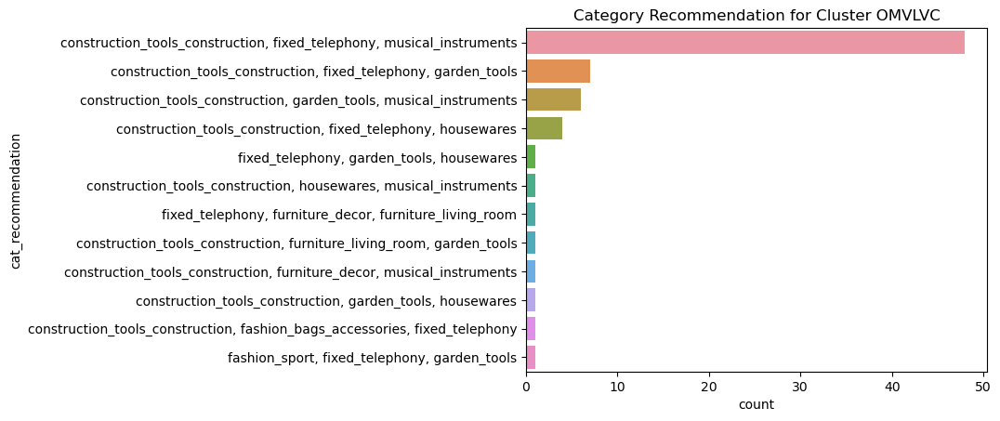

In [ ]:
sns.countplot(
    data=df_omvlvc_recommendation, 
    y='cat_recommendation', 
    order=df_omvlvc_recommendation['cat_recommendation'].value_counts().sort_values(ascending=False).index)
plt.title('Category Recommendation for Cluster OMVLVC')
plt.show()

    Berdasarkan hasil model rekomendasi, dapat disimpulkan bahwa pelanggan yang berada pada Cluster OMVLVC mayoritas dapat kita rekomendasikan produk construction_tools_construction, fixed_telephony, musical_instruments.

## **Cluster Secondary Market - Very Low Value Customer (SMVLVC)**

### **Load Dataset**

In [ ]:
df_smvlvc = create_dataframe(df_cluster_for_recsys, 'Secondary Market', 'Very Low Value Customer')
df_smvlvc.head()

,customer_unique_id,product_category_name_english,order_item_id
0,0000f46a3911fa3c0805444483337064,stationery,1.0
1,0005e1862207bf6ccc02e4228effd9a0,fashion_bags_accessories,1.0
2,002b4cd83fabaffaa475f78ea5ef3e08,fashion_bags_accessories,1.0
3,0036a074f98b80c4f1fc33dbbcf9c552,housewares,1.0
4,003e28cb6fab8a0901bff9229612375f,toys,1.0


In [ ]:
smvlvc_user_matrix = create_user_matrix(df_smvlvc, 'customer_unique_id', 'product_category_name_english', 'order_item_id')
smvlvc_user_matrix.head()

product_category_name_english,agro_industry_and_commerce,air_conditioning,art,arts_and_craftmanship,audio,auto,baby,bed_bath_table,books_general_interest,books_imported,books_technical,cds_dvds_musicals,christmas_supplies,cine_photo,computers,computers_accessories,consoles_games,construction_tools_construction,construction_tools_safety,cool_stuff,costruction_tools_garden,diapers_and_hygiene,drinks,dvds_blu_ray,electronics,fashio_female_clothing,fashion_bags_accessories,fashion_childrens_clothes,fashion_male_clothing,fashion_shoes,fashion_sport,fashion_underwear_beach,fixed_telephony,food,food_drink,furniture_bedroom,furniture_decor,furniture_living_room,furniture_mattress_and_upholstery,garden_tools,health_beauty,home_appliances,home_appliances_2,home_comfort_2,home_confort,home_construction,housewares,industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,luggage_accessories,market_place,music,musical_instruments,office_furniture,perfumery,pet_shop,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0000f46a3911fa3c0805444483337064,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN
0005e1862207bf6ccc02e4228effd9a0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
002b4cd83fabaffaa475f78ea5ef3e08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0036a074f98b80c4f1fc33dbbcf9c552,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
003e28cb6fab8a0901bff9229612375f,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN


### **Dataset Surprise**

In [ ]:
data_smvlvc = create_surprise_dataset(df_smvlvc, 'order_item_id')

### **Dataset Splitting**

In [ ]:
trainset_smvlvc, testset_smvlvc = train_test_split(data=data_smvlvc, test_size=0.2, random_state=42)

### **Hyperparam Tuning**

#### **1. SVD (Singular Value Decomposition)**

In [ ]:
gs_svd_smvlvc = GridSearchCV(
    algo_class= SVD,
    param_grid= hyperparam_svd,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)
# fit to data
gs_svd_smvlvc.fit(data_smvlvc)

In [ ]:
gs_svd_smvlvc.best_score

{'mae': 0.6867778301368317, 'rmse': 1.5627024981790918}

In [ ]:
gs_svd_smvlvc.best_params

{'mae': {'n_epochs': 380, 'lr_all': 0.007, 'reg_all': 0.04},
 'rmse': {'n_epochs': 480, 'lr_all': 0.008, 'reg_all': 0.09}}

#### **2. ALS (Alternating Least Square)**

In [ ]:
gs_als_smvlvc = GridSearchCV(
    algo_class= BaselineOnly,
    param_grid= hyperparam_als,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)

# fit
gs_als_smvlvc.fit(data_smvlvc)

In [ ]:
gs_als_smvlvc.best_score

{'mae': 0.6953374189897534, 'rmse': 1.5602177375040447}

In [ ]:
gs_als_smvlvc.best_params

{'mae': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 5,
   'reg_i': 0}},
 'rmse': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 0,
   'reg_i': 20}}}

In [ ]:
smvlvc_mae_score = pd.DataFrame(index=['mae','rmse'])
smvlvc_mae_score['svd_model'] = [gs_svd_smvlvc.best_score['mae'],gs_svd_smvlvc.best_score['rmse']]
smvlvc_mae_score['als_model'] = [gs_als_smvlvc.best_score['mae'],gs_als_smvlvc.best_score['rmse']]
smvlvc_mae_score

,svd_model,als_model
mae,0.686778,0.695337
rmse,1.562702,1.560218


Berdasarkan hasil hyperparameter tuning, ditemukan bahwa nilai MAE dan RMSE pada model SVD lebih kecil dibandingkan model ALS. Maka dari itu, dapat disimpulkan bahwa model yang lebih baik digunakan untuk pembuatan recommendation system di cluster Secondary Market - Very Low Value Customer adalah model SVD.

Dapat dilihat juga bahwa RMSE nya tinggi, artinya, model yang dibuat akan lebih tidak baik membuat prediksi rekomendasi pada customer dengan kategori produk yang pembelian jumlahnya banyak.

### **Predict**

In [ ]:
if gs_svd_smvlvc.best_score['mae'] < gs_als_smvlvc.best_score['mae']:
    best_model_smvlvc = gs_svd_smvlvc.best_estimator['mae']
else:
    best_model_smvlvc = gs_als_smvlvc.best_estimator['mae']

In [ ]:
best_model_smvlvc.fit(trainset_smvlvc)

In [ ]:
list_customer = df_smvlvc['customer_unique_id'].drop_duplicates().to_list()
list_product = df_smvlvc['product_category_name_english'].drop_duplicates().to_list()

In [ ]:
list_smvlvc = []

for user in list_customer:
    for item in list_product:
        result = [user, item]
        list_smvlvc.append(result)

df_result_smvlvc = pd.DataFrame(
    data= list_smvlvc,
    columns=['customer_unique_id', 'product_category_name_english']
    )

In [ ]:
df_result_smvlvc.head()

,customer_unique_id,product_category_name_english
0,0000f46a3911fa3c0805444483337064,stationery
1,0000f46a3911fa3c0805444483337064,fashion_bags_accessories
2,0000f46a3911fa3c0805444483337064,housewares
3,0000f46a3911fa3c0805444483337064,toys
4,0000f46a3911fa3c0805444483337064,bed_bath_table


In [ ]:
list_est_order = []

for row in df_result_smvlvc.iterrows():
    user = row[1]['customer_unique_id']
    item = row[1]['product_category_name_english']

    # predict 1 row
    est_order = best_model_smvlvc.predict(uid=user, iid=item)
    list_est_order.append(est_order[3])

In [ ]:
df_result_smvlvc['est_order'] = list_est_order
df_result_smvlvc

,customer_unique_id,product_category_name_english,est_order
0,0000f46a3911fa3c0805444483337064,stationery,1.011643
1,0000f46a3911fa3c0805444483337064,fashion_bags_accessories,1.265999
2,0000f46a3911fa3c0805444483337064,housewares,1.479275
3,0000f46a3911fa3c0805444483337064,toys,1.000000
4,0000f46a3911fa3c0805444483337064,bed_bath_table,1.361217
...,...,...,...
375435,ffffd2657e2aad2907e67c3e9daecbeb,cds_dvds_musicals,1.302497
375436,ffffd2657e2aad2907e67c3e9daecbeb,signaling_and_security,1.149011
375437,ffffd2657e2aad2907e67c3e9daecbeb,diapers_and_hygiene,1.262192
375438,ffffd2657e2aad2907e67c3e9daecbeb,drinks,1.302497


In [ ]:
df_actual_vs_result_smvlvc = pd.merge(
    left= df_result_smvlvc,
    right= df_smvlvc,
    on = ['customer_unique_id','product_category_name_english'],
    how = 'left'
).rename(columns={'order_item_id':'act_order'})
df_actual_vs_result_smvlvc.head()

,customer_unique_id,product_category_name_english,est_order,act_order
0,0000f46a3911fa3c0805444483337064,stationery,1.011643,1.0
1,0000f46a3911fa3c0805444483337064,fashion_bags_accessories,1.265999,NaN
2,0000f46a3911fa3c0805444483337064,housewares,1.479275,NaN
3,0000f46a3911fa3c0805444483337064,toys,1.000000,NaN
4,0000f46a3911fa3c0805444483337064,bed_bath_table,1.361217,NaN


In [ ]:
df_predict_smvlvc = df_actual_vs_result_smvlvc[df_actual_vs_result_smvlvc['act_order'].isna()].drop(columns='act_order')
df_predict_smvlvc.head()

,customer_unique_id,product_category_name_english,est_order
1,0000f46a3911fa3c0805444483337064,fashion_bags_accessories,1.265999
2,0000f46a3911fa3c0805444483337064,housewares,1.479275
3,0000f46a3911fa3c0805444483337064,toys,1.000000
4,0000f46a3911fa3c0805444483337064,bed_bath_table,1.361217
5,0000f46a3911fa3c0805444483337064,computers_accessories,1.362971


In [ ]:
df_predict_smvlvc['cat_rank'] = df_predict_smvlvc.groupby('customer_unique_id')['est_order'].rank(ascending=False, method='dense')
df_predict_smvlvc.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
1,0000f46a3911fa3c0805444483337064,fashion_bags_accessories,1.265999,23.0
2,0000f46a3911fa3c0805444483337064,housewares,1.479275,7.0
3,0000f46a3911fa3c0805444483337064,toys,1.000000,60.0
4,0000f46a3911fa3c0805444483337064,bed_bath_table,1.361217,15.0
5,0000f46a3911fa3c0805444483337064,computers_accessories,1.362971,14.0


In [ ]:
df_top_recom = df_predict_smvlvc[df_predict_smvlvc['cat_rank'].isin([1,2,3])].sort_values(by=['customer_unique_id','cat_rank'])
df_top_recom.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
28,0000f46a3911fa3c0805444483337064,construction_tools_construction,1.652027,1.0
56,0000f46a3911fa3c0805444483337064,christmas_supplies,1.633515,2.0
50,0000f46a3911fa3c0805444483337064,books_imported,1.615369,3.0
116,0005e1862207bf6ccc02e4228effd9a0,home_construction,2.406164,1.0
121,0005e1862207bf6ccc02e4228effd9a0,christmas_supplies,1.649597,2.0


In [ ]:
df_top_recom['cat_rank'].value_counts()

1.0    5777
2.0    5776
3.0    5776
Name: cat_rank, dtype: int64

In [ ]:
# Custom aggregation function to join unique product categories using a set
def join_unique_categories(categories):
    return ', '.join(set(categories))

# Group by 'customer_unique_id' and aggregate the unique product categories as a sentence
df_smvlvc_original_cat = df_smvlvc.groupby('customer_unique_id')['product_category_name_english'].agg(join_unique_categories).reset_index()

# Rename the column to 'cat_original'
df_smvlvc_original_cat = df_smvlvc_original_cat.rename(columns={'product_category_name_english': 'cat_original'})

df_smvlvc_original_cat.head()

,customer_unique_id,cat_original
0,0000f46a3911fa3c0805444483337064,stationery
1,0005e1862207bf6ccc02e4228effd9a0,fashion_bags_accessories
2,002b4cd83fabaffaa475f78ea5ef3e08,fashion_bags_accessories
3,0036a074f98b80c4f1fc33dbbcf9c552,housewares
4,003e28cb6fab8a0901bff9229612375f,toys


In [ ]:
df_smvlvc_buyer_cat = pd.merge(left=df_top_recom, right=df_smvlvc_original_cat, on='customer_unique_id', how='left')
df_smvlvc_buyer_cat.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank,cat_original
0,0000f46a3911fa3c0805444483337064,construction_tools_construction,1.652027,1.0,stationery
1,0000f46a3911fa3c0805444483337064,christmas_supplies,1.633515,2.0,stationery
2,0000f46a3911fa3c0805444483337064,books_imported,1.615369,3.0,stationery
3,0005e1862207bf6ccc02e4228effd9a0,home_construction,2.406164,1.0,fashion_bags_accessories
4,0005e1862207bf6ccc02e4228effd9a0,christmas_supplies,1.649597,2.0,fashion_bags_accessories


In [ ]:
df_smvlvc_cat_group = df_smvlvc_buyer_cat.groupby(['cat_original','product_category_name_english'])[['est_order']].sum().reset_index()
df_smvlvc_cat_group['cat_rank'] = df_smvlvc_cat_group.groupby(['cat_original'])['est_order'].rank(ascending=False, method='dense')
df_smvlvc_cat_group.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,air_conditioning,3.256548,5.0
1,agro_industry_and_commerce,arts_and_craftmanship,1.743454,7.0
2,agro_industry_and_commerce,books_imported,4.598854,4.0
3,agro_industry_and_commerce,christmas_supplies,8.401081,2.0
4,agro_industry_and_commerce,construction_tools_construction,4.715796,3.0


In [ ]:
df_smvlvc_cat_group_top_rank = df_smvlvc_cat_group[df_smvlvc_cat_group['cat_rank'].isin([1,2,3])].sort_values(by=['cat_original','cat_rank']).reset_index(drop=True)
df_smvlvc_cat_group_top_rank.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,home_construction,9.906624,1.0
1,agro_industry_and_commerce,christmas_supplies,8.401081,2.0
2,agro_industry_and_commerce,construction_tools_construction,4.715796,3.0
3,air_conditioning,home_construction,48.617699,1.0
4,air_conditioning,construction_tools_construction,32.203140,2.0


In [ ]:
pivot_cat_smvlvc = pd.pivot_table(
    data=df_smvlvc_cat_group_top_rank,
    columns='cat_original',
    index='product_category_name_english',
    values='est_order',
    aggfunc=np.sum,
)

pivot_cat_smvlvc

cat_original,agro_industry_and_commerce,air_conditioning,art,"arts_and_craftmanship, toys",audio,auto,baby,bed_bath_table,"bed_bath_table, furniture_decor","bed_bath_table, furniture_living_room","bed_bath_table, sports_leisure","bed_bath_table, telephony",books_general_interest,books_imported,books_technical,cds_dvds_musicals,christmas_supplies,cine_photo,computers,computers_accessories,"computers_accessories, electronics","computers_accessories, furniture_decor","computers_accessories, garden_tools","computers_accessories, luggage_accessories",consoles_games,construction_tools_construction,"construction_tools_construction, pet_shop",construction_tools_safety,cool_stuff,"cool_stuff, baby","cool_stuff, bed_bath_table","cool_stuff, furniture_decor","cool_stuff, sports_leisure","cool_stuff, stationery",costruction_tools_garden,diapers_and_hygiene,drinks,dvds_blu_ray,"dvds_blu_ray, computers_accessories",electronics,"electronics, auto","electronics, furniture_decor",fashio_female_clothing,fashion_bags_accessories,"fashion_bags_accessories, auto","fashion_bags_accessories, baby","fashion_bags_accessories, market_place","fashion_bags_accessories, music","fashion_bags_accessories, music, baby","fashion_bags_accessories, telephony",fashion_childrens_clothes,fashion_male_clothing,fashion_shoes,"fashion_shoes, baby",fashion_sport,fashion_underwear_beach,fixed_telephony,food,food_drink,furniture_bedroom,"furniture_bedroom, auto","furniture_bedroom, pet_shop, fashion_bags_accessories","furniture_bedroom, stationery, auto",furniture_decor,furniture_living_room,furniture_mattress_and_upholstery,garden_tools,"garden_tools, furniture_decor",health_beauty,"health_beauty, housewares, perfumery","health_beauty, perfumery",home_appliances,"home_appliances, fashion_shoes",home_appliances_2,home_comfort_2,home_confort,"home_confort, bed_bath_table","home_confort, bed_bath_table, furniture_decor",home_construction,housewares,"housewares, auto, furniture_decor","housewares, baby","housewares, bed_bath_table","housewares, furniture_decor","housewares, garden_tools","housewares, market_place","housewares, sports_leisure","housewares, toys",industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,luggage_accessories,"luggage_accessories, baby",market_place,"market_place, furniture_decor",music,musical_instruments,"musical_instruments, fashion_bags_accessories, auto",office_furniture,perfumery,"perfumery, bed_bath_table, furniture_decor","perfumery, furniture_decor","perfumery, stationery",pet_shop,signaling_and_security,small_appliances,"small_appliances, furniture_decor",small_appliances_home_oven_and_coffee,sports_leisure,"sports_leisure, fashion_male_clothing, housewares","sports_leisure, market_place",stationery,"stationery, sports_leisure","stationery, toys",tablets_printing_image,telephony,"telephony, fixed_telephony","telephony, luggage_accessories",toys,"toys, furniture_decor",watches_gifts,"watches_gifts, audio","watches_gifts, bed_bath_table","watches_gifts, fashion_bags_accessories","watches_gifts, sports_leisure","watches_gifts, telephony"
product_category_name_english,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
air_conditioning,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.958146,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.370442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.931993,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.005431,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.818629,NaN,NaN,NaN,NaN,1.673345,NaN,NaN,NaN,NaN,NaN,1.756669,NaN,NaN,NaN,2.273564,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
art,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.600520,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [ ]:
smvlvc_cat_recs = []
smvlvc_cat_ori = []

for col in pivot_cat_smvlvc.columns:
    non_na_indexes = pivot_cat_smvlvc[col].index[pivot_cat_smvlvc[col].notna()]
    joined_indexes = ', '.join(non_na_indexes)
    smvlvc_cat_ori.append(col)
    smvlvc_cat_recs.append(joined_indexes)

In [ ]:
df_smvlvc_recommendation = pd.DataFrame()
df_smvlvc_recommendation['cat_original'] = smvlvc_cat_ori
df_smvlvc_recommendation['cat_recommendation'] = smvlvc_cat_recs
df_smvlvc_recommendation.head()

,cat_original,cat_recommendation
0,agro_industry_and_commerce,"christmas_supplies, construction_tools_constru..."
1,air_conditioning,"christmas_supplies, construction_tools_constru..."
2,art,"christmas_supplies, construction_tools_constru..."
3,"arts_and_craftmanship, toys","books_imported, construction_tools_constructio..."
4,audio,"christmas_supplies, construction_tools_constru..."


    Berdasarkan hasil model recsys yang sudah dibuat, dapat diperoleh sebuah tabel rekomendasi yang dapat digunakan untuk merekomendasikan kategori produk yang dapat ditawarkan ke pelanggan berdasarkan kategori produk yang pernah dibeli oleh pelanggan tersebut. Sebagai contoh, untuk customer yang pernah membeli produk air_conditioning, dapat kita rekomendasikan produk christmas_supplies, construction_tools_construction, dan home_construction.

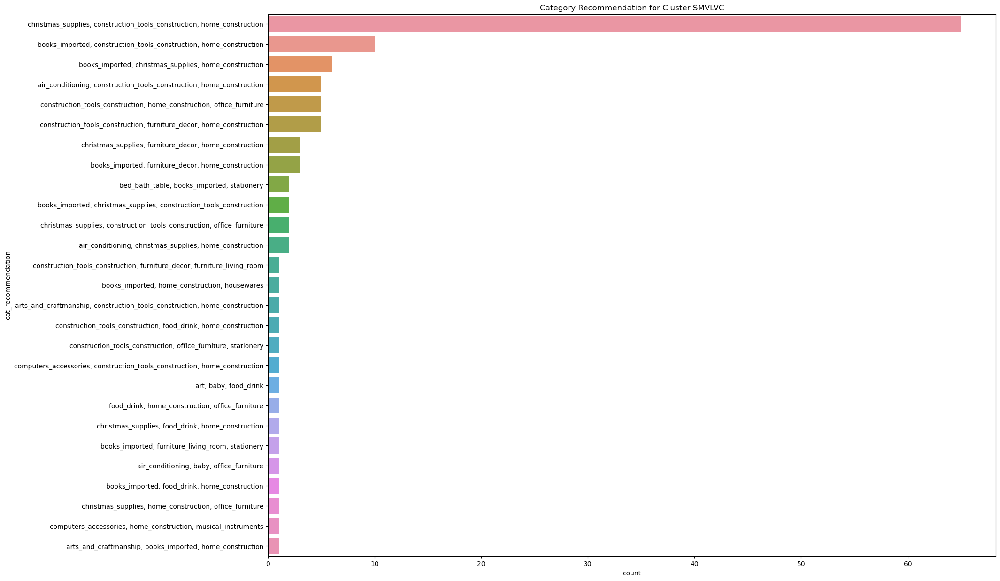

In [ ]:
plt.figure(figsize=(20,15))
sns.countplot(
    data=df_smvlvc_recommendation, 
    y='cat_recommendation', 
    order=df_smvlvc_recommendation['cat_recommendation'].value_counts().sort_values(ascending=False).index)
plt.title('Category Recommendation for Cluster SMVLVC')
plt.show()

    Berdasarkan hasil model rekomendasi, dapat disimpulkan bahwa pelanggan yang berada pada Cluster SMVLVC mayoritas dapat kita rekomendasikan produk christmas_supplies, construction_tools_construction, home_construction.

## **Cluster Major Market - Very Low Value Customer (MMVLVC)**

### **Load Dataset**

In [ ]:
df_mmvlvc = create_dataframe(df_cluster_for_recsys, 'Major Market', 'Very Low Value Customer')
df_mmvlvc.head()

,customer_unique_id,product_category_name_english,order_item_id
0,0011857aff0e5871ce5eb429f21cdaf5,luggage_accessories,1.0
1,00191a9719ef48ebb5860b130347bf33,bed_bath_table,1.0
2,001a2bf0e46c684031af91fb2bce149d,housewares,1.0
3,001f3c4211216384d5fe59b041ce1461,housewares,1.0
4,002d71b244beb91ca7030b15ab526446,books_general_interest,1.0


In [ ]:
mmvlvc_user_matrix = create_user_matrix(df_mmvlvc, 'customer_unique_id', 'product_category_name_english', 'order_item_id')
mmvlvc_user_matrix.head()

product_category_name_english,agro_industry_and_commerce,air_conditioning,art,audio,auto,baby,bed_bath_table,books_general_interest,books_technical,cine_photo,computers,computers_accessories,consoles_games,construction_tools_construction,cool_stuff,costruction_tools_garden,costruction_tools_tools,drinks,dvds_blu_ray,electronics,fashio_female_clothing,fashion_bags_accessories,fashion_childrens_clothes,fashion_male_clothing,fashion_shoes,fashion_sport,fashion_underwear_beach,fixed_telephony,food,food_drink,furniture_bedroom,furniture_decor,furniture_living_room,furniture_mattress_and_upholstery,garden_tools,health_beauty,home_appliances,home_appliances_2,home_comfort_2,home_confort,home_construction,housewares,industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,la_cuisine,luggage_accessories,market_place,music,musical_instruments,office_furniture,perfumery,pet_shop,small_appliances,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0011857aff0e5871ce5eb429f21cdaf5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
00191a9719ef48ebb5860b130347bf33,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
001a2bf0e46c684031af91fb2bce149d,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
001f3c4211216384d5fe59b041ce1461,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
002d71b244beb91ca7030b15ab526446,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### **Dataset Surprise**

In [ ]:
data_mmvlvc = create_surprise_dataset(df_mmvlvc, 'order_item_id')

### **Dataset Splitting**

In [ ]:
trainset_mmvlvc, testset_mmvlvc = train_test_split(data=data_mmvlvc, test_size=0.2, random_state=42)

### **Hyperparam Tuning**

#### **1. SVD (Singular Value Decomposition)**

In [ ]:
gs_svd_mmvlvc = GridSearchCV(
    algo_class= SVD,
    param_grid= hyperparam_svd,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)
# fit to data
gs_svd_mmvlvc.fit(data_mmvlvc)

In [ ]:
gs_svd_mmvlvc.best_score

{'mae': 0.6869209041862494, 'rmse': 1.7220014146910252}

In [ ]:
gs_svd_mmvlvc.best_params

{'mae': {'n_epochs': 430, 'lr_all': 0.008, 'reg_all': 0.060000000000000005},
 'rmse': {'n_epochs': 80, 'lr_all': 0.002, 'reg_all': 0.09999999999999999}}

#### **2. ALS (Alternating Least Square)**

In [ ]:
gs_als_mmvlvc = GridSearchCV(
    algo_class= BaselineOnly,
    param_grid= hyperparam_als,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)

# fit
gs_als_mmvlvc.fit(data_mmvlvc)

In [ ]:
gs_als_mmvlvc.best_score

{'mae': 0.6998024275660197, 'rmse': 1.729036580691039}

In [ ]:
gs_als_mmvlvc.best_params

{'mae': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 5,
   'reg_i': 0}},
 'rmse': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 5,
   'reg_i': 45}}}

In [ ]:
mmvlvc_mae_score = pd.DataFrame(index=['mae','rmse'])
mmvlvc_mae_score['svd_model'] = [gs_svd_mmvlvc.best_score['mae'],gs_svd_mmvlvc.best_score['rmse']]
mmvlvc_mae_score['als_model'] = [gs_als_mmvlvc.best_score['mae'],gs_als_mmvlvc.best_score['rmse']]
mmvlvc_mae_score

,svd_model,als_model
mae,0.686921,0.699802
rmse,1.722001,1.729037


Berdasarkan hasil hyperparameter tuning, ditemukan bahwa nilai MAE dan RMSE pada model SVD lebih kecil dibandingkan model ALS. Maka dari itu, dapat disimpulkan bahwa model yang lebih baik digunakan untuk pembuatan recommendation system di cluster Major Market - Very Low Value Customer adalah model SVD.

Dapat dilihat juga bahwa RMSE nya tinggi, artinya, model yang dibuat akan lebih tidak baik membuat prediksi rekomendasi pada customer dengan kategori produk yang pembelian jumlahnya banyak.

### **Predict**

In [ ]:
if gs_svd_mmvlvc.best_score['mae'] < gs_als_mmvlvc.best_score['mae']:
    best_model_mmvlvc = gs_svd_mmvlvc.best_estimator['mae']
else:
    best_model_mmvlvc = gs_als_mmvlvc.best_estimator['mae']

In [ ]:
best_model_mmvlvc.fit(trainset_mmvlvc)

In [ ]:
list_customer = df_mmvlvc['customer_unique_id'].drop_duplicates().to_list()
list_product = df_mmvlvc['product_category_name_english'].drop_duplicates().to_list()

In [ ]:
list_mmvlvc = []

for user in list_customer:
    for item in list_product:
        result = [user, item]
        list_mmvlvc.append(result)

df_result_mmvlvc = pd.DataFrame(
    data= list_mmvlvc,
    columns=['customer_unique_id', 'product_category_name_english']
    )

In [ ]:
df_result_mmvlvc.head()

,customer_unique_id,product_category_name_english
0,0011857aff0e5871ce5eb429f21cdaf5,luggage_accessories
1,0011857aff0e5871ce5eb429f21cdaf5,bed_bath_table
2,0011857aff0e5871ce5eb429f21cdaf5,housewares
3,0011857aff0e5871ce5eb429f21cdaf5,books_general_interest
4,0011857aff0e5871ce5eb429f21cdaf5,toys


In [ ]:
list_est_order = []

for row in df_result_mmvlvc.iterrows():
    user = row[1]['customer_unique_id']
    item = row[1]['product_category_name_english']

    # predict 1 row
    est_order = best_model_mmvlvc.predict(uid=user, iid=item)
    list_est_order.append(est_order[3])

In [ ]:
df_result_mmvlvc['est_order'] = list_est_order
df_result_mmvlvc

,customer_unique_id,product_category_name_english,est_order
0,0011857aff0e5871ce5eb429f21cdaf5,luggage_accessories,1.027627
1,0011857aff0e5871ce5eb429f21cdaf5,bed_bath_table,1.302106
2,0011857aff0e5871ce5eb429f21cdaf5,housewares,1.298165
3,0011857aff0e5871ce5eb429f21cdaf5,books_general_interest,1.034194
4,0011857aff0e5871ce5eb429f21cdaf5,toys,1.000000
...,...,...,...
316589,ffedff0547d809c90c05c2691c51f9b7,computers,1.336116
316590,ffedff0547d809c90c05c2691c51f9b7,music,1.176041
316591,ffedff0547d809c90c05c2691c51f9b7,la_cuisine,1.336116
316592,ffedff0547d809c90c05c2691c51f9b7,furniture_mattress_and_upholstery,1.336116


In [ ]:
df_actual_vs_result_mmvlvc = pd.merge(
    left= df_result_mmvlvc,
    right= df_mmvlvc,
    on = ['customer_unique_id','product_category_name_english'],
    how = 'left'
).rename(columns={'order_item_id':'act_order'})
df_actual_vs_result_mmvlvc.head()

,customer_unique_id,product_category_name_english,est_order,act_order
0,0011857aff0e5871ce5eb429f21cdaf5,luggage_accessories,1.027627,1.0
1,0011857aff0e5871ce5eb429f21cdaf5,bed_bath_table,1.302106,NaN
2,0011857aff0e5871ce5eb429f21cdaf5,housewares,1.298165,NaN
3,0011857aff0e5871ce5eb429f21cdaf5,books_general_interest,1.034194,NaN
4,0011857aff0e5871ce5eb429f21cdaf5,toys,1.000000,NaN


In [ ]:
df_predict_mmvlvc = df_actual_vs_result_mmvlvc[df_actual_vs_result_mmvlvc['act_order'].isna()].drop(columns='act_order')
df_predict_mmvlvc.head()

,customer_unique_id,product_category_name_english,est_order
1,0011857aff0e5871ce5eb429f21cdaf5,bed_bath_table,1.302106
2,0011857aff0e5871ce5eb429f21cdaf5,housewares,1.298165
3,0011857aff0e5871ce5eb429f21cdaf5,books_general_interest,1.034194
4,0011857aff0e5871ce5eb429f21cdaf5,toys,1.000000
5,0011857aff0e5871ce5eb429f21cdaf5,furniture_decor,1.564360


In [ ]:
df_predict_mmvlvc['cat_rank'] = df_predict_mmvlvc.groupby('customer_unique_id')['est_order'].rank(ascending=False, method='dense')
df_predict_mmvlvc.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
1,0011857aff0e5871ce5eb429f21cdaf5,bed_bath_table,1.302106,15.0
2,0011857aff0e5871ce5eb429f21cdaf5,housewares,1.298165,16.0
3,0011857aff0e5871ce5eb429f21cdaf5,books_general_interest,1.034194,46.0
4,0011857aff0e5871ce5eb429f21cdaf5,toys,1.000000,52.0
5,0011857aff0e5871ce5eb429f21cdaf5,furniture_decor,1.564360,3.0


In [ ]:
df_top_recom = df_predict_mmvlvc[df_predict_mmvlvc['cat_rank'].isin([1,2,3])].sort_values(by=['customer_unique_id','cat_rank'])
df_top_recom.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
37,0011857aff0e5871ce5eb429f21cdaf5,home_appliances_2,1.666362,1.0
6,0011857aff0e5871ce5eb429f21cdaf5,furniture_living_room,1.595516,2.0
5,0011857aff0e5871ce5eb429f21cdaf5,furniture_decor,1.564360,3.0
77,00191a9719ef48ebb5860b130347bf33,computers_accessories,1.756540,1.0
96,00191a9719ef48ebb5860b130347bf33,home_appliances_2,1.705207,2.0


In [ ]:
df_top_recom['cat_rank'].value_counts()

1.0    5376
2.0    5366
3.0    5366
Name: cat_rank, dtype: int64

In [ ]:
# Custom aggregation function to join unique product categories using a set
def join_unique_categories(categories):
    return ', '.join(set(categories))

# Group by 'customer_unique_id' and aggregate the unique product categories as a sentence
df_mmvlvc_original_cat = df_mmvlvc.groupby('customer_unique_id')['product_category_name_english'].agg(join_unique_categories).reset_index()

# Rename the column to 'cat_original'
df_mmvlvc_original_cat = df_mmvlvc_original_cat.rename(columns={'product_category_name_english': 'cat_original'})

df_mmvlvc_original_cat.head()

,customer_unique_id,cat_original
0,0011857aff0e5871ce5eb429f21cdaf5,luggage_accessories
1,00191a9719ef48ebb5860b130347bf33,bed_bath_table
2,001a2bf0e46c684031af91fb2bce149d,housewares
3,001f3c4211216384d5fe59b041ce1461,housewares
4,002d71b244beb91ca7030b15ab526446,books_general_interest


In [ ]:
df_mmvlvc_buyer_cat = pd.merge(left=df_top_recom, right=df_mmvlvc_original_cat, on='customer_unique_id', how='left')
df_mmvlvc_buyer_cat.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank,cat_original
0,0011857aff0e5871ce5eb429f21cdaf5,home_appliances_2,1.666362,1.0,luggage_accessories
1,0011857aff0e5871ce5eb429f21cdaf5,furniture_living_room,1.595516,2.0,luggage_accessories
2,0011857aff0e5871ce5eb429f21cdaf5,furniture_decor,1.564360,3.0,luggage_accessories
3,00191a9719ef48ebb5860b130347bf33,computers_accessories,1.756540,1.0,bed_bath_table
4,00191a9719ef48ebb5860b130347bf33,home_appliances_2,1.705207,2.0,bed_bath_table


In [ ]:
df_mmvlvc_cat_group = df_mmvlvc_buyer_cat.groupby(['cat_original','product_category_name_english'])[['est_order']].sum().reset_index()
df_mmvlvc_cat_group['cat_rank'] = df_mmvlvc_cat_group.groupby(['cat_original'])['est_order'].rank(ascending=False, method='dense')
df_mmvlvc_cat_group.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,bed_bath_table,2.287764,3.0
1,agro_industry_and_commerce,drinks,4.046896,2.0
2,agro_industry_and_commerce,furniture_bedroom,1.534993,6.0
3,agro_industry_and_commerce,furniture_decor,1.658848,5.0
4,agro_industry_and_commerce,furniture_living_room,1.671903,4.0


In [ ]:
df_mmvlvc_cat_group_top_rank = df_mmvlvc_cat_group[df_mmvlvc_cat_group['cat_rank'].isin([1,2,3])].sort_values(by=['cat_original','cat_rank']).reset_index(drop=True)
df_mmvlvc_cat_group_top_rank.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,home_appliances_2,5.885678,1.0
1,agro_industry_and_commerce,drinks,4.046896,2.0
2,agro_industry_and_commerce,bed_bath_table,2.287764,3.0
3,air_conditioning,home_appliances_2,39.697782,1.0
4,air_conditioning,furniture_living_room,24.910526,2.0


In [ ]:
pivot_cat_mmvlvc = pd.pivot_table(
    data=df_mmvlvc_cat_group_top_rank,
    columns='cat_original',
    index='product_category_name_english',
    values='est_order',
    aggfunc=np.sum,
)

pivot_cat_mmvlvc

cat_original,agro_industry_and_commerce,air_conditioning,art,audio,auto,baby,bed_bath_table,"bed_bath_table, furniture_decor",books_general_interest,books_technical,cine_photo,computers,computers_accessories,"computers_accessories, auto","computers_accessories, bed_bath_table","computers_accessories, sports_leisure","computers_accessories, telephony",consoles_games,"consoles_games, garden_tools","consoles_games, sports_leisure",construction_tools_construction,cool_stuff,"cool_stuff, auto","cool_stuff, bed_bath_table","cool_stuff, furniture_living_room","cool_stuff, tablets_printing_image","cool_stuff, telephony",costruction_tools_garden,costruction_tools_tools,drinks,dvds_blu_ray,electronics,fashio_female_clothing,fashion_bags_accessories,"fashion_bags_accessories, baby",fashion_childrens_clothes,fashion_male_clothing,"fashion_male_clothing, luggage_accessories","fashion_male_clothing, sports_leisure",fashion_shoes,"fashion_shoes, baby","fashion_shoes, toys",fashion_sport,fashion_underwear_beach,fixed_telephony,food,food_drink,furniture_bedroom,furniture_decor,"furniture_decor, baby",furniture_living_room,furniture_mattress_and_upholstery,garden_tools,"garden_tools, art",health_beauty,"health_beauty, bed_bath_table","health_beauty, cool_stuff","health_beauty, furniture_decor","health_beauty, sports_leisure","health_beauty, telephony",home_appliances,"home_appliances, bed_bath_table",home_appliances_2,home_comfort_2,home_confort,"home_confort, bed_bath_table","home_confort, furniture_decor",home_construction,housewares,"housewares, art","housewares, bed_bath_table","housewares, drinks","housewares, furniture_decor","housewares, luggage_accessories","housewares, toys",industry_commerce_and_business,"industry_commerce_and_business, furniture_decor",kitchen_dining_laundry_garden_furniture,"la_cuisine, baby",luggage_accessories,market_place,music,musical_instruments,office_furniture,"office_furniture, housewares",perfumery,"perfumery, food","perfumery, furniture_decor","perfumery, sports_leisure",pet_shop,"pet_shop, bed_bath_table","pet_shop, health_beauty","pet_shop, housewares",small_appliances,"small_appliances, housewares",sports_leisure,"sports_leisure, furniture_decor","sports_leisure, luggage_accessories",stationery,tablets_printing_image,"tablets_printing_image, furniture_decor",telephony,toys,"toys, baby",watches_gifts,"watches_gifts, baby","watches_gifts, electronics","watches_gifts, furniture_decor","watches_gifts, home_confort","watches_gifts, housewares","watches_gifts, sports_leisure"
product_category_name_english,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
agro_industry_and_commerce,NaN,18.843610,NaN,16.720003,147.436301,100.165692,462.284066,18.213917,19.577760,6.788772,3.487302,1.696420,315.805030,NaN,NaN,1.816325,NaN,54.071377,NaN,1.440620,NaN,224.056774,1.603104,1.664355,2.207208,NaN,NaN,4.971528,NaN,3.969442,NaN,77.784391,5.137830,103.080823,1.891474,1.559775,NaN,NaN,2.050296,27.457155,NaN,NaN,5.038172,8.344976,28.201872,20.148242,14.093156,8.066673,528.527990,2.322617,23.427494,1.696420,172.297787,NaN,402.477326,1.696420,NaN,1.585782,NaN,NaN,34.978423,2.451787,10.331544,5.358653,32.682346,4.655405,1.696420,7.988068,344.884900,NaN,NaN,NaN,NaN,2.280562,NaN,4.851191,2.036776,8.321261,NaN,78.290377,31.197154,NaN,28.637699,92.741531,1.518185,190.086790,NaN,NaN,NaN,69.870547,NaN,NaN,1.484497,33.715557,1.655558,354.200855,1.923698,1.555373,67.559080,8.249286,NaN,231.145173,187.255846,4.727912,123.357671,1.525996,1.666891,1.548203,1.703265,NaN,1.696420
bed_bath_table,2.287764,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.116203,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.163679,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [ ]:
mmvlvc_cat_recs = []
mmvlvc_cat_ori = []

for col in pivot_cat_mmvlvc.columns:
    non_na_indexes = pivot_cat_mmvlvc[col].index[pivot_cat_mmvlvc[col].notna()]
    joined_indexes = ', '.join(non_na_indexes)
    mmvlvc_cat_ori.append(col)
    mmvlvc_cat_recs.append(joined_indexes)

In [ ]:
df_mmvlvc_recommendation = pd.DataFrame()
df_mmvlvc_recommendation['cat_original'] = mmvlvc_cat_ori
df_mmvlvc_recommendation['cat_recommendation'] = mmvlvc_cat_recs
df_mmvlvc_recommendation.head()

,cat_original,cat_recommendation
0,agro_industry_and_commerce,"bed_bath_table, drinks, home_appliances_2"
1,air_conditioning,"agro_industry_and_commerce, furniture_living_r..."
2,art,"furniture_decor, furniture_living_room, musica..."
3,audio,"agro_industry_and_commerce, furniture_living_r..."
4,auto,"agro_industry_and_commerce, furniture_living_r..."


    Berdasarkan hasil model recsys yang sudah dibuat, dapat diperoleh sebuah tabel rekomendasi yang dapat digunakan untuk merekomendasikan kategori produk yang dapat ditawarkan ke pelanggan berdasarkan kategori produk yang pernah dibeli oleh pelanggan tersebut. Sebagai contoh, untuk customer yang pernah membeli produk air_conditioning, dapat kita rekomendasikan produk agro_industry_and_commerce, furniture_living_room, dan home_appliances_2.

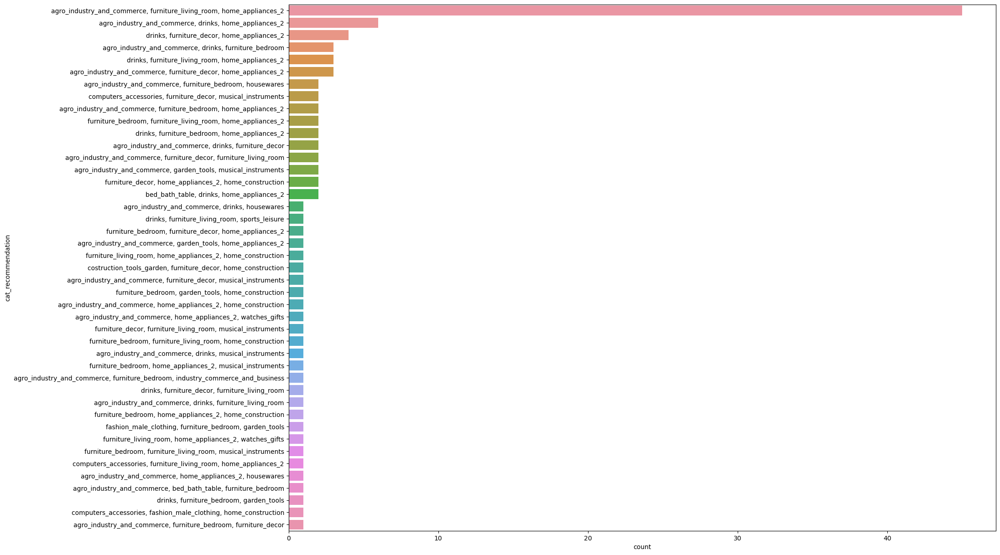

In [ ]:
plt.figure(figsize=(20,15))
sns.countplot(
    data=df_mmvlvc_recommendation, 
    y='cat_recommendation', 
    order=df_mmvlvc_recommendation['cat_recommendation'].value_counts().sort_values(ascending=False).index)
plt.show()

    Berdasarkan hasil model rekomendasi, dapat disimpulkan bahwa pelanggan yang berada pada Cluster MMVLVC mayoritas dapat kita rekomendasikan produk agro_industry_and_commerce, furniture_living_room, dan home_appliances_2.

## **Cluster Outlying Market - Low Value Customer (OMLVC)**

### **Load Dataset**

In [ ]:
df_omlvc = create_dataframe(df_cluster_for_recsys, 'Outlying Market', 'Low Value Customer')
df_omlvc.head()

,customer_unique_id,product_category_name_english,order_item_id
0,0000f6ccb0745a6a4b88665a16c9f078,telephony,1.0
1,0006fdc98a402fceb4eb0ee528f6a8d4,bed_bath_table,1.0
2,001926cef41060fae572e2e7b30bd2a4,computers_accessories,2.0
3,001926cef41060fae572e2e7b30bd2a4,electronics,1.0
4,002ae492472e45ad6ebeb7a625409392,health_beauty,3.0


In [ ]:
omlvc_user_matrix = create_user_matrix(df_omlvc, 'customer_unique_id', 'product_category_name_english', 'order_item_id')
omlvc_user_matrix.head()

product_category_name_english,agro_industry_and_commerce,air_conditioning,art,audio,auto,baby,bed_bath_table,books_general_interest,books_technical,christmas_supplies,computers,computers_accessories,consoles_games,construction_tools_construction,construction_tools_lights,construction_tools_safety,cool_stuff,costruction_tools_garden,costruction_tools_tools,drinks,dvds_blu_ray,electronics,fashio_female_clothing,fashion_bags_accessories,fashion_childrens_clothes,fashion_male_clothing,fashion_shoes,fashion_sport,fashion_underwear_beach,fixed_telephony,food,food_drink,furniture_bedroom,furniture_decor,furniture_living_room,garden_tools,health_beauty,home_appliances,home_appliances_2,home_comfort_2,home_confort,home_construction,housewares,industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,luggage_accessories,market_place,musical_instruments,office_furniture,perfumery,pet_shop,security_and_services,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0000f6ccb0745a6a4b88665a16c9f078,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN
0006fdc98a402fceb4eb0ee528f6a8d4,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
001926cef41060fae572e2e7b30bd2a4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
002ae492472e45ad6ebeb7a625409392,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0037eb1ff742ee2e71ba887f65f3c6f3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### **Dataset Surprise**

In [ ]:
data_omlvc = create_surprise_dataset(df_omlvc, 'order_item_id')

### **Dataset Splitting**

In [ ]:
trainset_omlvc, testset_omlvc = train_test_split(data=data_omlvc, test_size=0.2, random_state=42)

### **Hyperparam Tuning**

#### **1. SVD (Singular Value Decomposition)**

In [ ]:
gs_svd_omlvc = GridSearchCV(
    algo_class= SVD,
    param_grid= hyperparam_svd,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)
# fit to data
gs_svd_omlvc.fit(data_omlvc)

In [ ]:
gs_svd_omlvc.best_score

{'mae': 0.7782215481251666, 'rmse': 2.799495871574588}

In [ ]:
gs_svd_omlvc.best_params

{'mae': {'n_epochs': 480, 'lr_all': 0.002, 'reg_all': 0.05},
 'rmse': {'n_epochs': 430, 'lr_all': 0.002, 'reg_all': 0.09999999999999999}}

#### **2. ALS (Alternating Least Square)**

In [ ]:
gs_als_omlvc = GridSearchCV(
    algo_class= BaselineOnly,
    param_grid= hyperparam_als,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)

# fit
gs_als_omlvc.fit(data_omlvc)

In [ ]:
gs_als_omlvc.best_score

{'mae': 0.8172477447106925, 'rmse': 2.812558449325997}

In [ ]:
gs_als_omlvc.best_params

{'mae': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 5,
   'reg_i': 5}},
 'rmse': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 5,
   'reg_i': 45}}}

In [ ]:
omlvc_mae_score = pd.DataFrame(index=['mae','rmse'])
omlvc_mae_score['svd_model'] = [gs_svd_omlvc.best_score['mae'],gs_svd_omlvc.best_score['rmse']]
omlvc_mae_score['als_model'] = [gs_als_omlvc.best_score['mae'],gs_als_omlvc.best_score['rmse']]
omlvc_mae_score

,svd_model,als_model
mae,0.778222,0.817248
rmse,2.799496,2.812558


Berdasarkan hasil hyperparameter tuning, ditemukan bahwa nilai MAE dan RMSE pada model SVD lebih kecil dibandingkan model ALS. Maka dari itu, dapat disimpulkan bahwa model yang lebih baik digunakan untuk pembuatan recommendation system di cluster Outlying Market - Low Value Customer adalah model SVD.

Dapat dilihat juga bahwa RMSE nya tinggi, artinya, model yang dibuat akan lebih tidak baik membuat prediksi rekomendasi pada customer dengan kategori produk yang pembelian jumlahnya banyak.

### **Predict**

In [ ]:
if gs_svd_omlvc.best_score['mae'] < gs_als_omlvc.best_score['mae']:
    best_model_omlvc = gs_svd_omlvc.best_estimator['mae']
else:
    best_model_omlvc = gs_als_omlvc.best_estimator['mae']

In [ ]:
best_model_omlvc.fit(trainset_omlvc)

In [ ]:
list_customer = df_omlvc['customer_unique_id'].drop_duplicates().to_list()
list_product = df_omlvc['product_category_name_english'].drop_duplicates().to_list()

In [ ]:
list_omlvc = []

for user in list_customer:
    for item in list_product:
        result = [user, item]
        list_omlvc.append(result)

df_result_omlvc = pd.DataFrame(
    data= list_omlvc,
    columns=['customer_unique_id', 'product_category_name_english']
    )

In [ ]:
df_result_omlvc.head()

,customer_unique_id,product_category_name_english
0,0000f6ccb0745a6a4b88665a16c9f078,telephony
1,0000f6ccb0745a6a4b88665a16c9f078,bed_bath_table
2,0000f6ccb0745a6a4b88665a16c9f078,computers_accessories
3,0000f6ccb0745a6a4b88665a16c9f078,electronics
4,0000f6ccb0745a6a4b88665a16c9f078,health_beauty


In [ ]:
list_est_order = []

for row in df_result_omlvc.iterrows():
    user = row[1]['customer_unique_id']
    item = row[1]['product_category_name_english']

    # predict 1 row
    est_order = best_model_omlvc.predict(uid=user, iid=item)
    list_est_order.append(est_order[3])

In [ ]:
df_result_omlvc['est_order'] = list_est_order
df_result_omlvc

,customer_unique_id,product_category_name_english,est_order
0,0000f6ccb0745a6a4b88665a16c9f078,telephony,1.060101
1,0000f6ccb0745a6a4b88665a16c9f078,bed_bath_table,1.323187
2,0000f6ccb0745a6a4b88665a16c9f078,computers_accessories,1.692324
3,0000f6ccb0745a6a4b88665a16c9f078,electronics,1.017381
4,0000f6ccb0745a6a4b88665a16c9f078,health_beauty,1.000000
...,...,...,...
236431,fff3a9369e4b7102fab406a334a678c3,food,1.482926
236432,fff3a9369e4b7102fab406a334a678c3,construction_tools_safety,1.476069
236433,fff3a9369e4b7102fab406a334a678c3,small_appliances_home_oven_and_coffee,1.326237
236434,fff3a9369e4b7102fab406a334a678c3,tablets_printing_image,1.261171


In [ ]:
df_actual_vs_result_omlvc = pd.merge(
    left= df_result_omlvc,
    right= df_omlvc,
    on = ['customer_unique_id','product_category_name_english'],
    how = 'left'
).rename(columns={'order_item_id':'act_order'})
df_actual_vs_result_omlvc.head()

,customer_unique_id,product_category_name_english,est_order,act_order
0,0000f6ccb0745a6a4b88665a16c9f078,telephony,1.060101,1.0
1,0000f6ccb0745a6a4b88665a16c9f078,bed_bath_table,1.323187,NaN
2,0000f6ccb0745a6a4b88665a16c9f078,computers_accessories,1.692324,NaN
3,0000f6ccb0745a6a4b88665a16c9f078,electronics,1.017381,NaN
4,0000f6ccb0745a6a4b88665a16c9f078,health_beauty,1.000000,NaN


In [ ]:
df_predict_omlvc = df_actual_vs_result_omlvc[df_actual_vs_result_omlvc['act_order'].isna()].drop(columns='act_order')
df_predict_omlvc.head()

,customer_unique_id,product_category_name_english,est_order
1,0000f6ccb0745a6a4b88665a16c9f078,bed_bath_table,1.323187
2,0000f6ccb0745a6a4b88665a16c9f078,computers_accessories,1.692324
3,0000f6ccb0745a6a4b88665a16c9f078,electronics,1.017381
4,0000f6ccb0745a6a4b88665a16c9f078,health_beauty,1.000000
5,0000f6ccb0745a6a4b88665a16c9f078,housewares,1.564534


In [ ]:
df_predict_omlvc['cat_rank'] = df_predict_omlvc.groupby('customer_unique_id')['est_order'].rank(ascending=False, method='dense')
df_predict_omlvc.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
1,0000f6ccb0745a6a4b88665a16c9f078,bed_bath_table,1.323187,20.0
2,0000f6ccb0745a6a4b88665a16c9f078,computers_accessories,1.692324,5.0
3,0000f6ccb0745a6a4b88665a16c9f078,electronics,1.017381,48.0
4,0000f6ccb0745a6a4b88665a16c9f078,health_beauty,1.000000,52.0
5,0000f6ccb0745a6a4b88665a16c9f078,housewares,1.564534,11.0


In [ ]:
df_top_recom = df_predict_omlvc[df_predict_omlvc['cat_rank'].isin([1,2,3])].sort_values(by=['customer_unique_id','cat_rank'])
df_top_recom.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
54,0000f6ccb0745a6a4b88665a16c9f078,agro_industry_and_commerce,2.408462,1.0
49,0000f6ccb0745a6a4b88665a16c9f078,fashion_sport,2.263824,2.0
46,0000f6ccb0745a6a4b88665a16c9f078,fashion_male_clothing,1.899230,3.0
110,0006fdc98a402fceb4eb0ee528f6a8d4,fashion_sport,2.554185,1.0
115,0006fdc98a402fceb4eb0ee528f6a8d4,agro_industry_and_commerce,2.496379,2.0


In [ ]:
df_top_recom['cat_rank'].value_counts()

1.0    3884
2.0    3876
3.0    3876
Name: cat_rank, dtype: int64

In [ ]:
# Custom aggregation function to join unique product categories using a set
def join_unique_categories(categories):
    return ', '.join(set(categories))

# Group by 'customer_unique_id' and aggregate the unique product categories as a sentence
df_omlvc_original_cat = df_omlvc.groupby('customer_unique_id')['product_category_name_english'].agg(join_unique_categories).reset_index()

# Rename the column to 'cat_original'
df_omlvc_original_cat = df_omlvc_original_cat.rename(columns={'product_category_name_english': 'cat_original'})

df_omlvc_original_cat.head()

,customer_unique_id,cat_original
0,0000f6ccb0745a6a4b88665a16c9f078,telephony
1,0006fdc98a402fceb4eb0ee528f6a8d4,bed_bath_table
2,001926cef41060fae572e2e7b30bd2a4,"computers_accessories, electronics"
3,002ae492472e45ad6ebeb7a625409392,health_beauty
4,0037eb1ff742ee2e71ba887f65f3c6f3,housewares


In [ ]:
df_omlvc_buyer_cat = pd.merge(left=df_top_recom, right=df_omlvc_original_cat, on='customer_unique_id', how='left')
df_omlvc_buyer_cat.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank,cat_original
0,0000f6ccb0745a6a4b88665a16c9f078,agro_industry_and_commerce,2.408462,1.0,telephony
1,0000f6ccb0745a6a4b88665a16c9f078,fashion_sport,2.263824,2.0,telephony
2,0000f6ccb0745a6a4b88665a16c9f078,fashion_male_clothing,1.899230,3.0,telephony
3,0006fdc98a402fceb4eb0ee528f6a8d4,fashion_sport,2.554185,1.0,bed_bath_table
4,0006fdc98a402fceb4eb0ee528f6a8d4,agro_industry_and_commerce,2.496379,2.0,bed_bath_table


In [ ]:
df_omlvc_cat_group = df_omlvc_buyer_cat.groupby(['cat_original','product_category_name_english'])[['est_order']].sum().reset_index()
df_omlvc_cat_group['cat_rank'] = df_omlvc_cat_group.groupby(['cat_original'])['est_order'].rank(ascending=False, method='dense')
df_omlvc_cat_group.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,auto,2.730932,4.0
1,agro_industry_and_commerce,fashion_male_clothing,7.143497,2.0
2,agro_industry_and_commerce,fashion_sport,9.610996,1.0
3,agro_industry_and_commerce,furniture_decor,3.699264,3.0
4,agro_industry_and_commerce,garden_tools,1.932702,6.0


In [ ]:
df_omlvc_cat_group_top_rank = df_omlvc_cat_group[df_omlvc_cat_group['cat_rank'].isin([1,2,3])].sort_values(by=['cat_original','cat_rank']).reset_index(drop=True)
df_omlvc_cat_group_top_rank.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,fashion_sport,9.610996,1.0
1,agro_industry_and_commerce,fashion_male_clothing,7.143497,2.0
2,agro_industry_and_commerce,furniture_decor,3.699264,3.0
3,"agro_industry_and_commerce, furniture_decor",fashion_sport,3.825186,1.0
4,"agro_industry_and_commerce, furniture_decor",cool_stuff,3.686935,2.0


In [ ]:
pivot_cat_omlvc = pd.pivot_table(
    data=df_omlvc_cat_group_top_rank,
    columns='cat_original',
    index='product_category_name_english',
    values='est_order',
    aggfunc=np.sum,
)

pivot_cat_omlvc

cat_original,agro_industry_and_commerce,"agro_industry_and_commerce, furniture_decor",air_conditioning,art,audio,auto,"auto, toys",baby,bed_bath_table,"bed_bath_table, baby","bed_bath_table, furniture_decor","bed_bath_table, sports_leisure","bed_bath_table, toys",books_general_interest,books_technical,christmas_supplies,computers,computers_accessories,"computers_accessories, electronics","computers_accessories, luggage_accessories","computers_accessories, telephony",consoles_games,construction_tools_construction,"construction_tools_construction, furniture_decor",construction_tools_lights,construction_tools_safety,"construction_tools_safety, home_construction",cool_stuff,"cool_stuff, auto","cool_stuff, baby","cool_stuff, bed_bath_table","cool_stuff, fashion_underwear_beach","cool_stuff, luggage_accessories","cool_stuff, toys",costruction_tools_garden,costruction_tools_tools,drinks,dvds_blu_ray,electronics,"electronics, auto",fashio_female_clothing,fashion_bags_accessories,"fashion_bags_accessories, toys",fashion_childrens_clothes,fashion_male_clothing,fashion_shoes,"fashion_shoes, baby",fashion_sport,fashion_underwear_beach,fixed_telephony,food,food_drink,furniture_bedroom,furniture_decor,furniture_living_room,"furniture_living_room, furniture_decor",garden_tools,"garden_tools, furniture_decor","garden_tools, home_construction",health_beauty,"health_beauty, bed_bath_table, fashion_shoes","health_beauty, cool_stuff","health_beauty, electronics","health_beauty, garden_tools","health_beauty, housewares","health_beauty, sports_leisure","health_beauty, watches_gifts",home_appliances,home_appliances_2,"home_appliances_2, furniture_decor",home_comfort_2,home_confort,"home_confort, bed_bath_table",home_construction,housewares,"housewares, bed_bath_table","housewares, furniture_decor","housewares, garden_tools","housewares, home_appliances_2","housewares, luggage_accessories","housewares, sports_leisure",industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,luggage_accessories,market_place,musical_instruments,office_furniture,"office_furniture, telephony",perfumery,"perfumery, toys",pet_shop,security_and_services,signaling_and_security,small_appliances,"small_appliances, cool_stuff","small_appliances, home_confort",small_appliances_home_oven_and_coffee,sports_leisure,"sports_leisure, furniture_decor","sports_leisure, garden_tools",stationery,"stationery, luggage_accessories",tablets_printing_image,telephony,"telephony, auto","telephony, sports_leisure",toys,"toys, baby",watches_gifts,"watches_gifts, sports_leisure","watches_gifts, telephony"
product_category_name_english,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
agro_industry_and_commerce,NaN,NaN,12.399597,2.436711,25.121782,318.341067,2.395183,283.003455,688.873881,5.632770,12.443155,3.321679,2.570604,32.612788,17.552325,17.889606,85.163017,546.163983,2.508333,2.138920,2.496379,175.753210,21.371270,2.447376,7.862995,7.029469,3.771107,466.023842,2.970524,2.734239,5.387065,2.542245,2.586850,9.175352,19.672212,7.814672,4.323165,10.067846,126.397627,2.485475,7.422511,207.491458,2.727919,2.496379,9.670749,39.391279,2.044167,6.270250,14.978273,17.394263,10.235570,22.372813,12.922771,458.812899,36.753790,2.328298,365.970628,5.692174,2.562324,836.562134,3.082353,NaN,2.638274,2.445347,2.474937,7.007765,2.764395,54.605277,17.859658,2.548145,4.428132,33.239485,10.820177,24.385293,289.489391,2.340486,2.168810,2.128548,2.408681,1.976057,4.963073,5.076601,12.438239,114.355234,46.629712,43.631811,141.204251,2.076920,325.194717,2.541817,128.688631,2.515202,3.054851,51.928198,2.901992,2.599252,2.459799,804.016475,8.128351,NaN,160.235433,3.570705,9.581288,465.489322,2.366673,2.202070,468.783437,3.247560,615.649690,2.430808,2.549734
auto,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.533594,NaN,NaN,NaN,2.257721,NaN,NaN,NaN,2.747057,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.074781,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [ ]:
omlvc_cat_recs = []
omlvc_cat_ori = []

for col in pivot_cat_omlvc.columns:
    non_na_indexes = pivot_cat_omlvc[col].index[pivot_cat_omlvc[col].notna()]
    joined_indexes = ', '.join(non_na_indexes)
    omlvc_cat_ori.append(col)
    omlvc_cat_recs.append(joined_indexes)

In [ ]:
df_omlvc_recommendation = pd.DataFrame()
df_omlvc_recommendation['cat_original'] = omlvc_cat_ori
df_omlvc_recommendation['cat_recommendation'] = omlvc_cat_recs
df_omlvc_recommendation.head()

,cat_original,cat_recommendation
0,agro_industry_and_commerce,"fashion_male_clothing, fashion_sport, furnitur..."
1,"agro_industry_and_commerce, furniture_decor","cool_stuff, fashion_sport, food"
2,air_conditioning,"agro_industry_and_commerce, fashion_male_cloth..."
3,art,"agro_industry_and_commerce, fashion_male_cloth..."
4,audio,"agro_industry_and_commerce, fashion_male_cloth..."


    Berdasarkan hasil model recsys yang sudah dibuat, dapat diperoleh sebuah tabel rekomendasi yang dapat digunakan untuk merekomendasikan kategori produk yang dapat ditawarkan ke pelanggan berdasarkan kategori produk yang pernah dibeli oleh pelanggan tersebut. Sebagai contoh, untuk customer yang pernah membeli produk air_conditioning, dapat kita rekomendasikan produk agro_industry_and_commerce, fashion_male_clothing, dan fashion_sport.

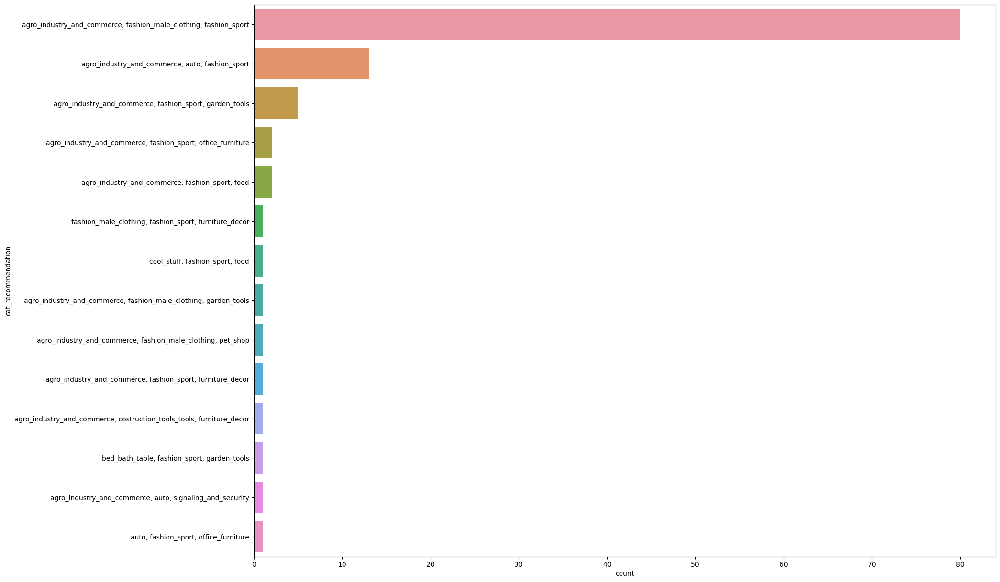

In [ ]:
plt.figure(figsize=(20,15))
sns.countplot(
    data=df_omlvc_recommendation, 
    y='cat_recommendation', 
    order=df_omlvc_recommendation['cat_recommendation'].value_counts().sort_values(ascending=False).index)
plt.show()

    Berdasarkan hasil model rekomendasi, dapat disimpulkan bahwa pelanggan yang berada pada Cluster OMLVC mayoritas dapat kita rekomendasikan produk agro_industry_and_commerce, fashion_male_clothing, dan fashion_sport.

## **Cluster Secondary Market - Low Value Customer (SMLVC)**

### **Load Dataset**

In [ ]:
df_smlvc = create_dataframe(df_cluster_for_recsys, 'Secondary Market', 'Low Value Customer')
df_smlvc.head()

,customer_unique_id,product_category_name_english,order_item_id
0,000a5ad9c4601d2bbdd9ed765d5213b3,health_beauty,1.0
1,0010a452c6d13139e50b57f19f52e04e,home_confort,1.0
2,001147e649a7b1afd577e873841632dd,housewares,3.0
3,0011c98589159d6149979563c504cb21,small_appliances,1.0
4,0012929d977a8d7280bb277c1e5f589d,watches_gifts,1.0


In [ ]:
smlvc_user_matrix = create_user_matrix(df_smlvc, 'customer_unique_id', 'product_category_name_english', 'order_item_id')
smlvc_user_matrix.head()

product_category_name_english,agro_industry_and_commerce,air_conditioning,art,audio,auto,baby,bed_bath_table,books_general_interest,books_technical,cds_dvds_musicals,christmas_supplies,cine_photo,computers,computers_accessories,consoles_games,construction_tools_construction,construction_tools_lights,construction_tools_safety,cool_stuff,costruction_tools_garden,costruction_tools_tools,drinks,dvds_blu_ray,electronics,fashio_female_clothing,fashion_bags_accessories,fashion_male_clothing,fashion_shoes,fashion_sport,fashion_underwear_beach,fixed_telephony,flowers,food,food_drink,furniture_bedroom,furniture_decor,furniture_living_room,furniture_mattress_and_upholstery,garden_tools,health_beauty,home_appliances,home_appliances_2,home_comfort_2,home_confort,home_construction,housewares,industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,la_cuisine,luggage_accessories,market_place,musical_instruments,office_furniture,party_supplies,perfumery,pet_shop,signaling_and_security,small_appliances,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
000a5ad9c4601d2bbdd9ed765d5213b3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0010a452c6d13139e50b57f19f52e04e,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
001147e649a7b1afd577e873841632dd,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0011c98589159d6149979563c504cb21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN
0012929d977a8d7280bb277c1e5f589d,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0


### **Dataset Surprise**

In [ ]:
data_smlvc = create_surprise_dataset(df_smlvc, 'order_item_id')

### **Dataset Splitting**

In [ ]:
trainset_smlvc, testset_smlvc = train_test_split(data=data_smlvc, test_size=0.2, random_state=42)

### **Hyperparam Tuning**

#### **1. SVD (Singular Value Decomposition)**

In [ ]:
gs_svd_smlvc = GridSearchCV(
    algo_class= SVD,
    param_grid= hyperparam_svd,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)
# fit to data
gs_svd_smlvc.fit(data_smlvc)

In [ ]:
gs_svd_smlvc.best_score

{'mae': 0.7319326569569434, 'rmse': 2.0991439212967196}

In [ ]:
gs_svd_smlvc.best_params

{'mae': {'n_epochs': 455, 'lr_all': 0.006, 'reg_all': 0.03},
 'rmse': {'n_epochs': 255, 'lr_all': 0.005, 'reg_all': 0.09}}

#### **2. ALS (Alternating Least Square)**

In [ ]:
gs_als_smlvc = GridSearchCV(
    algo_class= BaselineOnly,
    param_grid= hyperparam_als,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)

# fit
gs_als_smlvc.fit(data_smlvc)

In [ ]:
gs_als_smlvc.best_score

{'mae': 0.7443812945877168, 'rmse': 2.0471495375992643}

In [ ]:
gs_als_smlvc.best_params

{'mae': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 5,
   'reg_i': 5}},
 'rmse': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 0,
   'reg_i': 5}}}

In [ ]:
smlvc_mae_score = pd.DataFrame(index=['mae','rmse'])
smlvc_mae_score['svd_model'] = [gs_svd_smlvc.best_score['mae'],gs_svd_smlvc.best_score['rmse']]
smlvc_mae_score['als_model'] = [gs_als_smlvc.best_score['mae'],gs_als_smlvc.best_score['rmse']]
smlvc_mae_score

,svd_model,als_model
mae,0.731933,0.744381
rmse,2.099144,2.047150


Berdasarkan hasil hyperparameter tuning, ditemukan bahwa nilai MAE dan RMSE pada model SVD lebih kecil dibandingkan model ALS. Maka dari itu, dapat disimpulkan bahwa model yang lebih baik digunakan untuk pembuatan recommendation system di cluster Secondary Market - Low Value Customer adalah model SVD.

Dapat dilihat juga bahwa RMSE nya tinggi, artinya, model yang dibuat akan lebih tidak baik membuat prediksi rekomendasi pada customer dengan kategori produk yang pembelian jumlahnya banyak.

### **Predict**

In [ ]:
if gs_svd_smlvc.best_score['mae'] < gs_als_smlvc.best_score['mae']:
    best_model_smlvc = gs_svd_smlvc.best_estimator['mae']
else:
    best_model_smlvc = gs_als_smlvc.best_estimator['mae']

In [ ]:
best_model_smlvc.fit(trainset_smlvc)

In [ ]:
list_customer = df_smlvc['customer_unique_id'].drop_duplicates().to_list()
list_product = df_smlvc['product_category_name_english'].drop_duplicates().to_list()

In [ ]:
list_smlvc = []

for user in list_customer:
    for item in list_product:
        result = [user, item]
        list_smlvc.append(result)

df_result_smlvc = pd.DataFrame(
    data= list_smlvc,
    columns=['customer_unique_id', 'product_category_name_english']
    )

In [ ]:
df_result_smlvc.head()

,customer_unique_id,product_category_name_english
0,000a5ad9c4601d2bbdd9ed765d5213b3,health_beauty
1,000a5ad9c4601d2bbdd9ed765d5213b3,home_confort
2,000a5ad9c4601d2bbdd9ed765d5213b3,housewares
3,000a5ad9c4601d2bbdd9ed765d5213b3,small_appliances
4,000a5ad9c4601d2bbdd9ed765d5213b3,watches_gifts


In [ ]:
list_est_order = []

for row in df_result_smlvc.iterrows():
    user = row[1]['customer_unique_id']
    item = row[1]['product_category_name_english']

    # predict 1 row
    est_order = best_model_smlvc.predict(uid=user, iid=item)
    list_est_order.append(est_order[3])

In [ ]:
df_result_smlvc['est_order'] = list_est_order
df_result_smlvc

,customer_unique_id,product_category_name_english,est_order
0,000a5ad9c4601d2bbdd9ed765d5213b3,health_beauty,1.010996
1,000a5ad9c4601d2bbdd9ed765d5213b3,home_confort,1.241202
2,000a5ad9c4601d2bbdd9ed765d5213b3,housewares,1.241296
3,000a5ad9c4601d2bbdd9ed765d5213b3,small_appliances,1.161945
4,000a5ad9c4601d2bbdd9ed765d5213b3,watches_gifts,1.168814
...,...,...,...
475643,fffa431dd3fcdefea4b1777d114144f2,la_cuisine,1.419755
475644,fffa431dd3fcdefea4b1777d114144f2,costruction_tools_tools,1.331028
475645,fffa431dd3fcdefea4b1777d114144f2,party_supplies,1.638854
475646,fffa431dd3fcdefea4b1777d114144f2,construction_tools_lights,1.321442


In [ ]:
df_actual_vs_result_smlvc = pd.merge(
    left= df_result_smlvc,
    right= df_smlvc,
    on = ['customer_unique_id','product_category_name_english'],
    how = 'left'
).rename(columns={'order_item_id':'act_order'})
df_actual_vs_result_smlvc.head()

,customer_unique_id,product_category_name_english,est_order,act_order
0,000a5ad9c4601d2bbdd9ed765d5213b3,health_beauty,1.010996,1.0
1,000a5ad9c4601d2bbdd9ed765d5213b3,home_confort,1.241202,NaN
2,000a5ad9c4601d2bbdd9ed765d5213b3,housewares,1.241296,NaN
3,000a5ad9c4601d2bbdd9ed765d5213b3,small_appliances,1.161945,NaN
4,000a5ad9c4601d2bbdd9ed765d5213b3,watches_gifts,1.168814,NaN


In [ ]:
df_predict_smlvc = df_actual_vs_result_smlvc[df_actual_vs_result_smlvc['act_order'].isna()].drop(columns='act_order')
df_predict_smlvc.head()

,customer_unique_id,product_category_name_english,est_order
1,000a5ad9c4601d2bbdd9ed765d5213b3,home_confort,1.241202
2,000a5ad9c4601d2bbdd9ed765d5213b3,housewares,1.241296
3,000a5ad9c4601d2bbdd9ed765d5213b3,small_appliances,1.161945
4,000a5ad9c4601d2bbdd9ed765d5213b3,watches_gifts,1.168814
5,000a5ad9c4601d2bbdd9ed765d5213b3,garden_tools,1.657432


In [ ]:
df_predict_smlvc['cat_rank'] = df_predict_smlvc.groupby('customer_unique_id')['est_order'].rank(ascending=False, method='dense')
df_predict_smlvc.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
1,000a5ad9c4601d2bbdd9ed765d5213b3,home_confort,1.241202,39.0
2,000a5ad9c4601d2bbdd9ed765d5213b3,housewares,1.241296,38.0
3,000a5ad9c4601d2bbdd9ed765d5213b3,small_appliances,1.161945,53.0
4,000a5ad9c4601d2bbdd9ed765d5213b3,watches_gifts,1.168814,51.0
5,000a5ad9c4601d2bbdd9ed765d5213b3,garden_tools,1.657432,8.0


In [ ]:
df_top_recom = df_predict_smlvc[df_predict_smlvc['cat_rank'].isin([1,2,3])].sort_values(by=['customer_unique_id','cat_rank'])
df_top_recom.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
26,000a5ad9c4601d2bbdd9ed765d5213b3,fixed_telephony,2.169993,1.0
40,000a5ad9c4601d2bbdd9ed765d5213b3,costruction_tools_garden,2.099763,2.0
49,000a5ad9c4601d2bbdd9ed765d5213b3,construction_tools_safety,1.953977,3.0
90,0010a452c6d13139e50b57f19f52e04e,fixed_telephony,2.441672,1.0
104,0010a452c6d13139e50b57f19f52e04e,costruction_tools_garden,2.117709,2.0


In [ ]:
df_top_recom['cat_rank'].value_counts()

1.0    7468
2.0    7432
3.0    7432
Name: cat_rank, dtype: int64

In [ ]:
# Custom aggregation function to join unique product categories using a set
def join_unique_categories(categories):
    return ', '.join(set(categories))

# Group by 'customer_unique_id' and aggregate the unique product categories as a sentence
df_smlvc_original_cat = df_smlvc.groupby('customer_unique_id')['product_category_name_english'].agg(join_unique_categories).reset_index()

# Rename the column to 'cat_original'
df_smlvc_original_cat = df_smlvc_original_cat.rename(columns={'product_category_name_english': 'cat_original'})

df_smlvc_original_cat.head()

,customer_unique_id,cat_original
0,000a5ad9c4601d2bbdd9ed765d5213b3,health_beauty
1,0010a452c6d13139e50b57f19f52e04e,home_confort
2,001147e649a7b1afd577e873841632dd,housewares
3,0011c98589159d6149979563c504cb21,small_appliances
4,0012929d977a8d7280bb277c1e5f589d,watches_gifts


In [ ]:
df_smlvc_buyer_cat = pd.merge(left=df_top_recom, right=df_smlvc_original_cat, on='customer_unique_id', how='left')
df_smlvc_buyer_cat.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank,cat_original
0,000a5ad9c4601d2bbdd9ed765d5213b3,fixed_telephony,2.169993,1.0,health_beauty
1,000a5ad9c4601d2bbdd9ed765d5213b3,costruction_tools_garden,2.099763,2.0,health_beauty
2,000a5ad9c4601d2bbdd9ed765d5213b3,construction_tools_safety,1.953977,3.0,health_beauty
3,0010a452c6d13139e50b57f19f52e04e,fixed_telephony,2.441672,1.0,home_confort
4,0010a452c6d13139e50b57f19f52e04e,costruction_tools_garden,2.117709,2.0,home_confort


In [ ]:
df_smlvc_cat_group = df_smlvc_buyer_cat.groupby(['cat_original','product_category_name_english'])[['est_order']].sum().reset_index()
df_smlvc_cat_group['cat_rank'] = df_smlvc_cat_group.groupby(['cat_original'])['est_order'].rank(ascending=False, method='dense')
df_smlvc_cat_group.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,construction_tools_safety,2.010048,5.0
1,agro_industry_and_commerce,costruction_tools_garden,8.949031,3.0
2,agro_industry_and_commerce,fixed_telephony,12.657498,1.0
3,agro_industry_and_commerce,food_drink,10.408837,2.0
4,agro_industry_and_commerce,garden_tools,1.922109,6.0


In [ ]:
df_smlvc_cat_group_top_rank = df_smlvc_cat_group[df_smlvc_cat_group['cat_rank'].isin([1,2,3])].sort_values(by=['cat_original','cat_rank']).reset_index(drop=True)
df_smlvc_cat_group_top_rank.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,fixed_telephony,12.657498,1.0
1,agro_industry_and_commerce,food_drink,10.408837,2.0
2,agro_industry_and_commerce,costruction_tools_garden,8.949031,3.0
3,air_conditioning,fixed_telephony,35.342292,1.0
4,air_conditioning,food_drink,19.840050,2.0


In [ ]:
pivot_cat_smlvc = pd.pivot_table(
    data=df_smlvc_cat_group_top_rank,
    columns='cat_original',
    index='product_category_name_english',
    values='est_order',
    aggfunc=np.sum,
)

pivot_cat_smlvc

cat_original,agro_industry_and_commerce,air_conditioning,art,audio,auto,"auto, baby",baby,bed_bath_table,"bed_bath_table, costruction_tools_garden","bed_bath_table, electronics","bed_bath_table, fashion_bags_accessories","bed_bath_table, food","bed_bath_table, furniture_decor","bed_bath_table, furniture_living_room","bed_bath_table, garden_tools","bed_bath_table, sports_leisure","bed_bath_table, toys",books_general_interest,books_technical,cds_dvds_musicals,christmas_supplies,cine_photo,computers,computers_accessories,"computers_accessories, air_conditioning","computers_accessories, cool_stuff","computers_accessories, electronics","computers_accessories, furniture_decor","computers_accessories, garden_tools","computers_accessories, la_cuisine",consoles_games,"consoles_games, sports_leisure","consoles_games, toys",construction_tools_construction,"construction_tools_construction, watches_gifts",construction_tools_lights,construction_tools_safety,cool_stuff,"cool_stuff, baby","cool_stuff, bed_bath_table","cool_stuff, bed_bath_table, baby","cool_stuff, bed_bath_table, toys","cool_stuff, housewares","cool_stuff, tablets_printing_image",costruction_tools_garden,costruction_tools_tools,drinks,dvds_blu_ray,electronics,"electronics, drinks","electronics, garden_tools",fashio_female_clothing,fashion_bags_accessories,"fashion_bags_accessories, audio","fashion_bags_accessories, furniture_decor","fashion_bags_accessories, toys",fashion_male_clothing,fashion_shoes,fashion_sport,fashion_underwear_beach,fixed_telephony,flowers,"flowers, costruction_tools_garden",food,"food, fixed_telephony",food_drink,furniture_bedroom,furniture_decor,furniture_living_room,furniture_mattress_and_upholstery,"furniture_mattress_and_upholstery, small_appliances",garden_tools,"garden_tools, furniture_decor","garden_tools, home_construction",health_beauty,"health_beauty, baby","health_beauty, bed_bath_table","health_beauty, computers_accessories","health_beauty, electronics","health_beauty, fashion_underwear_beach","health_beauty, home_confort, sports_leisure","health_beauty, perfumery","health_beauty, sports_leisure",home_appliances,home_appliances_2,home_comfort_2,home_confort,"home_confort, bed_bath_table","home_confort, bed_bath_table, furniture_decor","home_confort, housewares",home_construction,housewares,"housewares, baby","housewares, bed_bath_table","housewares, consoles_games","housewares, furniture_decor","housewares, garden_tools","housewares, stationery",industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,"kitchen_dining_laundry_garden_furniture, bed_bath_table","kitchen_dining_laundry_garden_furniture, furniture_decor",la_cuisine,luggage_accessories,market_place,musical_instruments,"musical_instruments, luggage_accessories",office_furniture,"office_furniture, bed_bath_table","office_furniture, garden_tools","office_furniture, home_construction","office_furniture, housewares",party_supplies,perfumery,"perfumery, furniture_decor","perfumery, housewares","perfumery, sports_leisure","perfumery, stationery","perfumery, watches_gifts",pet_shop,"pet_shop, fashion_bags_accessories",signaling_and_security,small_appliances,sports_leisure,"sports_leisure, food","sports_leisure, food_drink","sports_leisure, furniture_decor","sports_leisure, luggage_accessories",stationery,"stationery, luggage_accessories","stationery, toys",tablets_printing_image,telephony,"telephony, sports_leisure",toys,"toys, baby",watches_gifts,"watches_gifts, fashion_shoes","watches_gifts, furniture_decor","watches_gifts, garden_tools","watches_gifts, telephony"
product_category_name_english,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
books_general_interest,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [ ]:
smlvc_cat_recs = []
smlvc_cat_ori = []

for col in pivot_cat_smlvc.columns:
    non_na_indexes = pivot_cat_smlvc[col].index[pivot_cat_smlvc[col].notna()]
    joined_indexes = ', '.join(non_na_indexes)
    smlvc_cat_ori.append(col)
    smlvc_cat_recs.append(joined_indexes)

In [ ]:
df_smlvc_recommendation = pd.DataFrame()
df_smlvc_recommendation['cat_original'] = smlvc_cat_ori
df_smlvc_recommendation['cat_recommendation'] = smlvc_cat_recs
df_smlvc_recommendation.head()

,cat_original,cat_recommendation
0,agro_industry_and_commerce,"costruction_tools_garden, fixed_telephony, foo..."
1,air_conditioning,"costruction_tools_garden, fixed_telephony, foo..."
2,art,"costruction_tools_garden, fixed_telephony, foo..."
3,audio,"costruction_tools_garden, fixed_telephony, foo..."
4,auto,"costruction_tools_garden, fixed_telephony, foo..."


    Berdasarkan hasil model recsys yang sudah dibuat, dapat diperoleh sebuah tabel rekomendasi yang dapat digunakan untuk merekomendasikan kategori produk yang dapat ditawarkan ke pelanggan berdasarkan kategori produk yang pernah dibeli oleh pelanggan tersebut. Sebagai contoh, untuk customer yang pernah membeli produk costruction_tools_garden, fixed_telephony, dan food_drink.

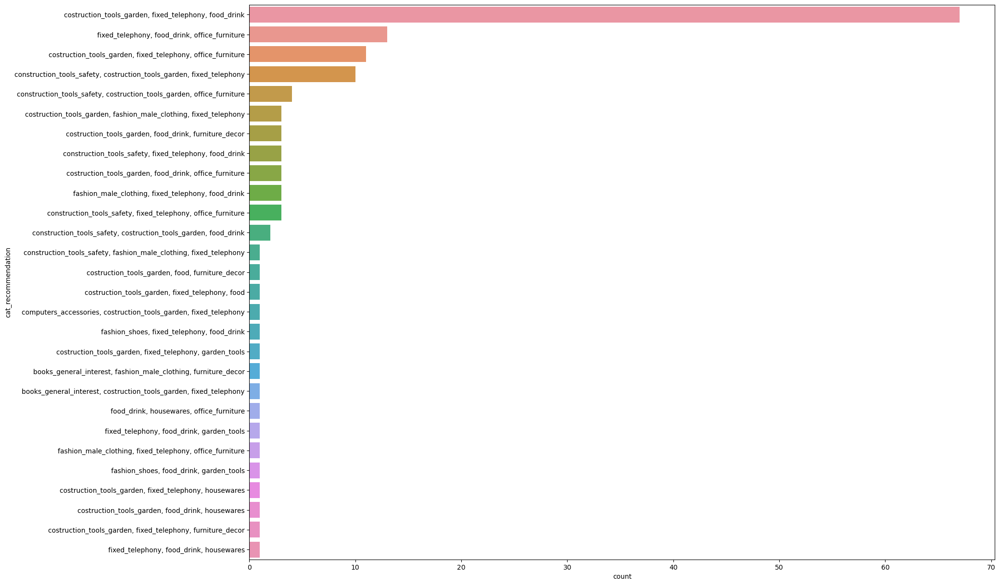

In [ ]:
plt.figure(figsize=(20,15))
sns.countplot(
    data=df_smlvc_recommendation, 
    y='cat_recommendation', 
    order=df_smlvc_recommendation['cat_recommendation'].value_counts().sort_values(ascending=False).index)
plt.show()

    Berdasarkan hasil model rekomendasi, dapat disimpulkan bahwa pelanggan yang berada pada Cluster SMLVC mayoritas dapat kita rekomendasikan produk costruction_tools_garden, fixed_telephony, dan food_drink.

## **Cluster Major Market - Low Value Customer (MMLVC)**

### **Load Dataset**

In [ ]:
df_mmlvc = create_dataframe(df_cluster_for_recsys, 'Major Market', 'Low Value Customer')
df_mmlvc.head()

,customer_unique_id,product_category_name_english,order_item_id
0,0004aac84e0df4da2b147fca70cf8255,telephony,1.0
1,00082cbe03e478190aadbea78542e933,luggage_accessories,1.0
2,000bfa1d2f1a41876493be685390d6d3,fashion_bags_accessories,2.0
3,000de6019bb59f34c099a907c151d855,bed_bath_table,3.0
4,002cdf87d4c03f08f7eb4551a923affc,office_furniture,1.0


In [ ]:
mmlvc_user_matrix = create_user_matrix(df_mmlvc, 'customer_unique_id', 'product_category_name_english', 'order_item_id')
mmlvc_user_matrix.head()

product_category_name_english,agro_industry_and_commerce,air_conditioning,art,audio,auto,baby,bed_bath_table,books_general_interest,books_imported,books_technical,cds_dvds_musicals,christmas_supplies,cine_photo,computers,computers_accessories,consoles_games,construction_tools_construction,construction_tools_lights,construction_tools_safety,cool_stuff,costruction_tools_garden,costruction_tools_tools,drinks,dvds_blu_ray,electronics,fashio_female_clothing,fashion_bags_accessories,fashion_childrens_clothes,fashion_male_clothing,fashion_shoes,fashion_sport,fashion_underwear_beach,fixed_telephony,flowers,food,food_drink,furniture_bedroom,furniture_decor,furniture_living_room,garden_tools,health_beauty,home_appliances,home_appliances_2,home_comfort_2,home_confort,home_construction,housewares,industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,la_cuisine,luggage_accessories,market_place,music,musical_instruments,office_furniture,party_supplies,perfumery,pet_shop,signaling_and_security,small_appliances,small_appliances_home_oven_and_coffee,sports_leisure,stationery,tablets_printing_image,telephony,toys,watches_gifts
customer_unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0004aac84e0df4da2b147fca70cf8255,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN
00082cbe03e478190aadbea78542e933,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
000bfa1d2f1a41876493be685390d6d3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
000de6019bb59f34c099a907c151d855,NaN,NaN,NaN,NaN,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
002cdf87d4c03f08f7eb4551a923affc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### **Dataset Surprise**

In [ ]:
data_mmlvc = create_surprise_dataset(df_mmlvc, 'order_item_id')

### **Dataset Splitting**

In [ ]:
trainset_mmlvc, testset_mmlvc = train_test_split(data=data_mmlvc, test_size=0.2, random_state=42)

### **Hyperparam Tuning**

#### **1. SVD (Singular Value Decomposition)**

In [ ]:
gs_svd_mmlvc = GridSearchCV(
    algo_class= SVD,
    param_grid= hyperparam_svd,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)
# fit to data
gs_svd_mmlvc.fit(data_mmlvc)

In [ ]:
gs_svd_mmlvc.best_score

{'mae': 0.8154209993641531, 'rmse': 3.0126185108585872}

In [ ]:
gs_svd_mmlvc.best_params

{'mae': {'n_epochs': 5,
  'lr_all': 0.009000000000000001,
  'reg_all': 0.06999999999999999},
 'rmse': {'n_epochs': 430, 'lr_all': 0.002, 'reg_all': 0.09}}

#### **2. ALS (Alternating Least Square)**

In [ ]:
gs_als_mmlvc = GridSearchCV(
    algo_class= BaselineOnly,
    param_grid= hyperparam_als,
    cv= 5,
    measures= ['mae', 'rmse'],
    n_jobs= -1
)

# fit
gs_als_mmlvc.fit(data_mmlvc)

In [ ]:
gs_als_mmlvc.best_score

{'mae': 0.8558862842714609, 'rmse': 3.391122528408959}

In [ ]:
gs_als_mmlvc.best_params

{'mae': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 5,
   'reg_i': 0}},
 'rmse': {'bsl_options': {'method': 'als',
   'n_epoch': 5,
   'reg_u': 5,
   'reg_i': 40}}}

In [ ]:
mmlvc_mae_score = pd.DataFrame(index=['mae','rmse'])
mmlvc_mae_score['svd_model'] = [gs_svd_mmlvc.best_score['mae'],gs_svd_mmlvc.best_score['rmse']]
mmlvc_mae_score['als_model'] = [gs_als_mmlvc.best_score['mae'],gs_als_mmlvc.best_score['rmse']]
mmlvc_mae_score

,svd_model,als_model
mae,0.815421,0.855886
rmse,3.012619,3.391123


Berdasarkan hasil hyperparameter tuning, ditemukan bahwa nilai MAE dan RMSE pada model SVD lebih kecil dibandingkan model ALS. Maka dari itu, dapat disimpulkan bahwa model yang lebih baik digunakan untuk pembuatan recommendation system di cluster Major Market - Low Value Customer adalah model SVD.

Dapat dilihat juga bahwa RMSE nya tinggi, artinya, model yang dibuat akan lebih tidak baik membuat prediksi rekomendasi pada customer dengan kategori produk yang pembelian jumlahnya banyak.

### **Predict**

In [ ]:
if gs_svd_mmlvc.best_score['mae'] < gs_als_mmlvc.best_score['mae']:
    best_model_mmlvc = gs_svd_mmlvc.best_estimator['mae']
else:
    best_model_mmlvc = gs_als_mmlvc.best_estimator['mae']

In [ ]:
best_model_mmlvc.fit(trainset_mmlvc)

In [ ]:
list_customer = df_mmlvc['customer_unique_id'].drop_duplicates().to_list()
list_product = df_mmlvc['product_category_name_english'].drop_duplicates().to_list()

In [ ]:
list_mmlvc = []

for user in list_customer:
    for item in list_product:
        result = [user, item]
        list_mmlvc.append(result)

df_result_mmlvc = pd.DataFrame(
    data= list_mmlvc,
    columns=['customer_unique_id', 'product_category_name_english']
    )

In [ ]:
df_result_mmlvc.head()

,customer_unique_id,product_category_name_english
0,0004aac84e0df4da2b147fca70cf8255,telephony
1,0004aac84e0df4da2b147fca70cf8255,luggage_accessories
2,0004aac84e0df4da2b147fca70cf8255,fashion_bags_accessories
3,0004aac84e0df4da2b147fca70cf8255,bed_bath_table
4,0004aac84e0df4da2b147fca70cf8255,office_furniture


In [ ]:
list_est_order = []

for row in df_result_mmlvc.iterrows():
    user = row[1]['customer_unique_id']
    item = row[1]['product_category_name_english']

    # predict 1 row
    est_order = best_model_mmlvc.predict(uid=user, iid=item)
    list_est_order.append(est_order[3])

In [ ]:
df_result_mmlvc['est_order'] = list_est_order
df_result_mmlvc

,customer_unique_id,product_category_name_english,est_order
0,0004aac84e0df4da2b147fca70cf8255,telephony,1.127035
1,0004aac84e0df4da2b147fca70cf8255,luggage_accessories,1.303393
2,0004aac84e0df4da2b147fca70cf8255,fashion_bags_accessories,1.330503
3,0004aac84e0df4da2b147fca70cf8255,bed_bath_table,1.662414
4,0004aac84e0df4da2b147fca70cf8255,office_furniture,2.296528
...,...,...,...
486080,fff699c184bcc967d62fa2c6171765f7,cine_photo,1.385013
486081,fff699c184bcc967d62fa2c6171765f7,tablets_printing_image,1.444325
486082,fff699c184bcc967d62fa2c6171765f7,fashion_childrens_clothes,1.506787
486083,fff699c184bcc967d62fa2c6171765f7,music,1.514924


In [ ]:
df_actual_vs_result_mmlvc = pd.merge(
    left= df_result_mmlvc,
    right= df_mmlvc,
    on = ['customer_unique_id','product_category_name_english'],
    how = 'left'
).rename(columns={'order_item_id':'act_order'})
df_actual_vs_result_mmlvc.head()

,customer_unique_id,product_category_name_english,est_order,act_order
0,0004aac84e0df4da2b147fca70cf8255,telephony,1.127035,1.0
1,0004aac84e0df4da2b147fca70cf8255,luggage_accessories,1.303393,NaN
2,0004aac84e0df4da2b147fca70cf8255,fashion_bags_accessories,1.330503,NaN
3,0004aac84e0df4da2b147fca70cf8255,bed_bath_table,1.662414,NaN
4,0004aac84e0df4da2b147fca70cf8255,office_furniture,2.296528,NaN


In [ ]:
df_predict_mmlvc = df_actual_vs_result_mmlvc[df_actual_vs_result_mmlvc['act_order'].isna()].drop(columns='act_order')
df_predict_mmlvc.head()

,customer_unique_id,product_category_name_english,est_order
1,0004aac84e0df4da2b147fca70cf8255,luggage_accessories,1.303393
2,0004aac84e0df4da2b147fca70cf8255,fashion_bags_accessories,1.330503
3,0004aac84e0df4da2b147fca70cf8255,bed_bath_table,1.662414
4,0004aac84e0df4da2b147fca70cf8255,office_furniture,2.296528
5,0004aac84e0df4da2b147fca70cf8255,toys,1.207809


In [ ]:
df_predict_mmlvc['cat_rank'] = df_predict_mmlvc.groupby('customer_unique_id')['est_order'].rank(ascending=False, method='dense')
df_predict_mmlvc.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
1,0004aac84e0df4da2b147fca70cf8255,luggage_accessories,1.303393,50.0
2,0004aac84e0df4da2b147fca70cf8255,fashion_bags_accessories,1.330503,47.0
3,0004aac84e0df4da2b147fca70cf8255,bed_bath_table,1.662414,14.0
4,0004aac84e0df4da2b147fca70cf8255,office_furniture,2.296528,3.0
5,0004aac84e0df4da2b147fca70cf8255,toys,1.207809,57.0


In [ ]:
df_top_recom = df_predict_mmlvc[df_predict_mmlvc['cat_rank'].isin([1,2,3])].sort_values(by=['customer_unique_id','cat_rank'])
df_top_recom.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank
19,0004aac84e0df4da2b147fca70cf8255,computers_accessories,2.671582,1.0
27,0004aac84e0df4da2b147fca70cf8255,christmas_supplies,2.421507,2.0
4,0004aac84e0df4da2b147fca70cf8255,office_furniture,2.296528,3.0
71,00082cbe03e478190aadbea78542e933,office_furniture,3.874724,1.0
86,00082cbe03e478190aadbea78542e933,computers_accessories,2.448918,2.0


In [ ]:
df_top_recom['cat_rank'].value_counts()

1.0    7258
2.0    7255
3.0    7255
Name: cat_rank, dtype: int64

In [ ]:
# Custom aggregation function to join unique product categories using a set
def join_unique_categories(categories):
    return ', '.join(set(categories))

# Group by 'customer_unique_id' and aggregate the unique product categories as a sentence
df_mmlvc_original_cat = df_mmlvc.groupby('customer_unique_id')['product_category_name_english'].agg(join_unique_categories).reset_index()

# Rename the column to 'cat_original'
df_mmlvc_original_cat = df_mmlvc_original_cat.rename(columns={'product_category_name_english': 'cat_original'})

df_mmlvc_original_cat.head()

,customer_unique_id,cat_original
0,0004aac84e0df4da2b147fca70cf8255,telephony
1,00082cbe03e478190aadbea78542e933,luggage_accessories
2,000bfa1d2f1a41876493be685390d6d3,fashion_bags_accessories
3,000de6019bb59f34c099a907c151d855,bed_bath_table
4,002cdf87d4c03f08f7eb4551a923affc,office_furniture


In [ ]:
df_mmlvc_buyer_cat = pd.merge(left=df_top_recom, right=df_mmlvc_original_cat, on='customer_unique_id', how='left')
df_mmlvc_buyer_cat.head()

,customer_unique_id,product_category_name_english,est_order,cat_rank,cat_original
0,0004aac84e0df4da2b147fca70cf8255,computers_accessories,2.671582,1.0,telephony
1,0004aac84e0df4da2b147fca70cf8255,christmas_supplies,2.421507,2.0,telephony
2,0004aac84e0df4da2b147fca70cf8255,office_furniture,2.296528,3.0,telephony
3,00082cbe03e478190aadbea78542e933,office_furniture,3.874724,1.0,luggage_accessories
4,00082cbe03e478190aadbea78542e933,computers_accessories,2.448918,2.0,luggage_accessories


In [ ]:
df_mmlvc_cat_group = df_mmlvc_buyer_cat.groupby(['cat_original','product_category_name_english'])[['est_order']].sum().reset_index()
df_mmlvc_cat_group['cat_rank'] = df_mmlvc_cat_group.groupby(['cat_original'])['est_order'].rank(ascending=False, method='dense')
df_mmlvc_cat_group.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,bed_bath_table,4.581452,7.0
1,agro_industry_and_commerce,christmas_supplies,6.875159,3.0
2,agro_industry_and_commerce,computers_accessories,5.003752,5.0
3,agro_industry_and_commerce,construction_tools_construction,2.069985,8.0
4,agro_industry_and_commerce,drinks,6.342876,4.0


In [ ]:
df_mmlvc_cat_group_top_rank = df_mmlvc_cat_group[df_mmlvc_cat_group['cat_rank'].isin([1,2,3])].sort_values(by=['cat_original','cat_rank']).reset_index(drop=True)
df_mmlvc_cat_group_top_rank.head()

,cat_original,product_category_name_english,est_order,cat_rank
0,agro_industry_and_commerce,office_furniture,20.326476,1.0
1,agro_industry_and_commerce,fixed_telephony,8.879264,2.0
2,agro_industry_and_commerce,christmas_supplies,6.875159,3.0
3,air_conditioning,office_furniture,48.489514,1.0
4,air_conditioning,christmas_supplies,31.380310,2.0


In [ ]:
pivot_cat_mmlvc = pd.pivot_table(
    data=df_mmlvc_cat_group_top_rank,
    columns='cat_original',
    index='product_category_name_english',
    values='est_order',
    aggfunc=np.sum,
)

pivot_cat_mmlvc

cat_original,agro_industry_and_commerce,air_conditioning,art,audio,auto,"auto, furniture_decor",baby,bed_bath_table,"bed_bath_table, baby","bed_bath_table, consoles_games","bed_bath_table, costruction_tools_garden","bed_bath_table, furniture_decor","bed_bath_table, home_appliances_2","bed_bath_table, sports_leisure","bed_bath_table, telephony","bed_bath_table, toys",books_general_interest,books_imported,books_technical,cds_dvds_musicals,christmas_supplies,cine_photo,computers,computers_accessories,"computers_accessories, auto","computers_accessories, bed_bath_table, sports_leisure","computers_accessories, fixed_telephony","computers_accessories, home_construction","computers_accessories, housewares","computers_accessories, sports_leisure","computers_accessories, stationery","computers_accessories, toys",consoles_games,"consoles_games, toys",construction_tools_construction,construction_tools_lights,construction_tools_safety,cool_stuff,"cool_stuff, baby","cool_stuff, construction_tools_safety","cool_stuff, furniture_decor","cool_stuff, garden_tools","cool_stuff, telephony","cool_stuff, toys",costruction_tools_garden,"costruction_tools_garden, garden_tools",costruction_tools_tools,drinks,dvds_blu_ray,electronics,"electronics, fashion_bags_accessories","electronics, furniture_decor","electronics, telephony",fashio_female_clothing,fashion_bags_accessories,fashion_childrens_clothes,fashion_male_clothing,fashion_shoes,fashion_sport,fashion_underwear_beach,fixed_telephony,flowers,food,"food, drinks",food_drink,furniture_bedroom,furniture_decor,"furniture_decor, baby",furniture_living_room,"furniture_living_room, furniture_decor",garden_tools,"garden_tools, furniture_decor",health_beauty,"health_beauty, perfumery","health_beauty, sports_leisure","health_beauty, stationery","health_beauty, telephony",home_appliances,"home_appliances, auto",home_appliances_2,home_comfort_2,home_confort,"home_confort, bed_bath_table","home_confort, furniture_decor","home_confort, furniture_living_room",home_construction,housewares,"housewares, baby","housewares, bed_bath_table, furniture_decor","housewares, consoles_games","housewares, drinks","housewares, food_drink","housewares, furniture_decor","housewares, garden_tools",industry_commerce_and_business,kitchen_dining_laundry_garden_furniture,la_cuisine,luggage_accessories,market_place,"market_place, furniture_decor",music,musical_instruments,"musical_instruments, home_comfort_2",office_furniture,"office_furniture, air_conditioning","office_furniture, fashion_bags_accessories","office_furniture, furniture_decor","office_furniture, watches_gifts",party_supplies,perfumery,"perfumery, bed_bath_table","perfumery, furniture_decor","perfumery, housewares","perfumery, sports_leisure",pet_shop,"pet_shop, bed_bath_table","pet_shop, computers_accessories","pet_shop, furniture_decor","pet_shop, garden_tools","pet_shop, health_beauty",signaling_and_security,small_appliances,"small_appliances, electronics","small_appliances, furniture_decor","small_appliances, sports_leisure",small_appliances_home_oven_and_coffee,sports_leisure,"sports_leisure, air_conditioning","sports_leisure, food_drink","sports_leisure, furniture_decor","sports_leisure, garden_tools","sports_leisure, toys",stationery,"stationery, luggage_accessories","stationery, sports_leisure","stationery, toys",tablets_printing_image,telephony,"telephony, garden_tools",toys,"toys, baby",watches_gifts,"watches_gifts, auto","watches_gifts, bed_bath_table","watches_gifts, fashion_bags_accessories","watches_gifts, furniture_decor","watches_gifts, housewares","watches_gifts, sports_leisure","watches_gifts, stationery","watches_gifts, toys"
product_category_name_english,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
air_conditioning,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [ ]:
mmlvc_cat_recs = []
mmlvc_cat_ori = []

for col in pivot_cat_mmlvc.columns:
    non_na_indexes = pivot_cat_mmlvc[col].index[pivot_cat_mmlvc[col].notna()]
    joined_indexes = ', '.join(non_na_indexes)
    mmlvc_cat_ori.append(col)
    mmlvc_cat_recs.append(joined_indexes)

In [ ]:
df_mmlvc_recommendation = pd.DataFrame()
df_mmlvc_recommendation['cat_original'] = mmlvc_cat_ori
df_mmlvc_recommendation['cat_recommendation'] = mmlvc_cat_recs
df_mmlvc_recommendation.head()

,cat_original,cat_recommendation
0,agro_industry_and_commerce,"christmas_supplies, fixed_telephony, office_fu..."
1,air_conditioning,"christmas_supplies, computers_accessories, off..."
2,art,"christmas_supplies, housewares, office_furniture"
3,audio,"christmas_supplies, fixed_telephony, office_fu..."
4,auto,"christmas_supplies, fixed_telephony, office_fu..."


    Berdasarkan hasil model recsys yang sudah dibuat, dapat diperoleh sebuah tabel rekomendasi yang dapat digunakan untuk merekomendasikan kategori produk yang dapat ditawarkan ke pelanggan berdasarkan kategori produk yang pernah dibeli oleh pelanggan tersebut. Sebagai contoh, untuk customer yang pernah membeli produk christmas_supplies, fixed_telephony, dan office_furniture.

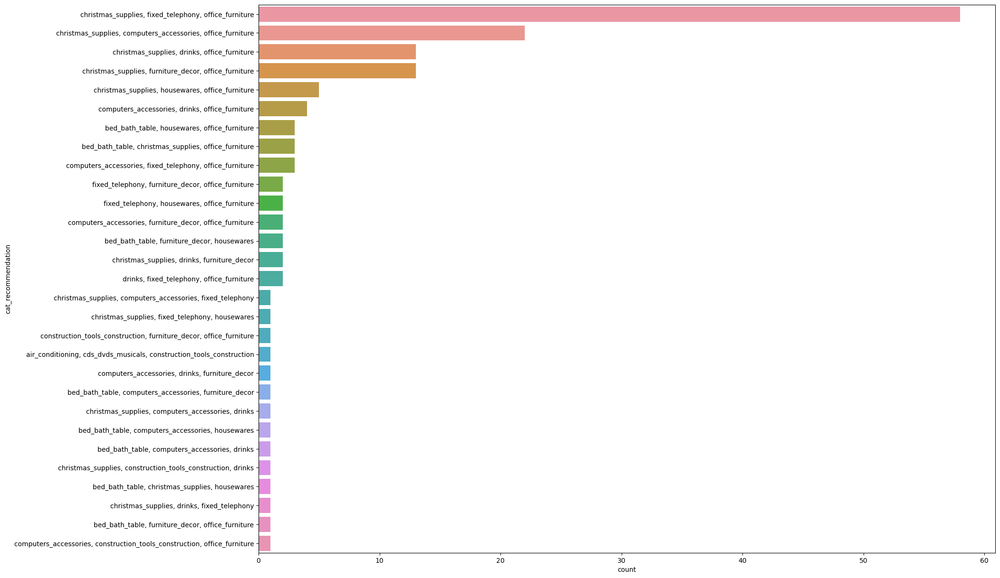

In [ ]:
plt.figure(figsize=(20,15))
sns.countplot(
    data=df_mmlvc_recommendation, 
    y='cat_recommendation', 
    order=df_mmlvc_recommendation['cat_recommendation'].value_counts().sort_values(ascending=False).index)
plt.show()

    Berdasarkan hasil model rekomendasi, dapat disimpulkan bahwa pelanggan yang berada pada Cluster MMLVC mayoritas dapat kita rekomendasikan produk christmas_supplies, fixed_telephony, dan office_furniture.

# **Business Impact Analysis**

Pada bagian ini dilakukan pengukuran keberhasilan model dengan menghubungkannya dengan revenue yang dapat diperoleh ketika menjalankan campaign  menggunakan rekomendasi yang dihasilkan. Cara pengukurannya adalah dengan mencari rata-rata harga per kategori (Average Selling Price atau ASP) kemudian dikalikan dengan estimasi order yang diprediksi tiap cluster pada model yang dibuat (pada tiap kategori yang direkomendasikan). Estimasi order yang digunakan merupakan nilai yang sudah dikurangi dengan nilai error model (MAE) pada tiap cluster nya, sehingga tidak terjadi over-predict.

In [ ]:
df_asp_cat = df.groupby('product_category_name_english')[['price']].median().reset_index()
df_asp_cat

,product_category_name_english,price
0,agro_industry_and_commerce,268.45
1,air_conditioning,139.99
2,art,99.00
3,arts_and_craftmanship,44.90
4,audio,89.00
...,...,...
66,stationery,79.00
67,tablets_printing_image,99.00
68,telephony,29.99
69,toys,79.90


In [ ]:
def calculate_predicted_revenue(df_source, mae, df_asp):
    df_predicted = df_source.copy()
    df_predicted = df_predicted.drop(columns='cat_rank')
    df_predicted['est_order_aft_error'] = df_predicted['est_order'] - mae             # menghitung order setelah dikurangi nilai error nya
    df_predicted = pd.merge(left=df_predicted, right=df_asp, on='product_category_name_english', how='left')
    df_predicted['est_sales'] = df_predicted['est_order_aft_error'] * df_predicted['price']
    total_predicted = df_predicted['est_sales'].sum()
    
    return total_predicted


In [ ]:
dataframes = [(df_omvlvc_cat_group_top_rank, gs_svd_omvlvc.best_score['mae']),
              (df_smvlvc_cat_group_top_rank, gs_svd_smvlvc.best_score['mae']),
              (df_mmvlvc_cat_group_top_rank, gs_svd_mmvlvc.best_score['mae']),
              (df_omlvc_cat_group_top_rank, gs_svd_omlvc.best_score['mae']),
              (df_smlvc_cat_group_top_rank, gs_svd_smlvc.best_score['mae']),
              (df_mmlvc_cat_group_top_rank, gs_svd_mmlvc.best_score['mae'])]

total_predicted_revenue_list = []

for df_source, mae in dataframes:
    total_predicted_revenue = calculate_predicted_revenue(df_source, mae, df_asp_cat)
    total_predicted_revenue_list.append(total_predicted_revenue)

In [ ]:
pd.options.display.float_format = '{:.2f}'.format

df_predicted_revenue = pd.DataFrame()
df_predicted_revenue['cluster'] = ['OMVLVC','SMVLVC','MMVLVC','OMLVC','SMLVC','MMLVC']
df_predicted_revenue['total_pred_revenue'] = total_predicted_revenue_list
df_predicted_revenue

,cluster,total_pred_revenue
0,OMVLVC,901827.43
1,SMVLVC,1961727.75
2,MMVLVC,3183418.93
3,OMLVC,3308803.54
4,SMLVC,1648886.19
5,MMLVC,3469726.03


In [ ]:
total_campaign_revenue = df_predicted_revenue['total_pred_revenue'].sum()
total_campaign_revenue

14474389.861033179

    Berdasarkan model recommendation system yang telah dibuat, dapat dihitung bahwa potensi sales / revenue yang dapat diperoleh adalah sebesar 15,315,384 R$. Apabila dengan menggunakan asumsi bahwa campaign dijalankan selama 6 bulan, maka hasil ini dapat kita bandingkan dengan Last 6 Month revenue dari data yang ada.

In [ ]:
l6m_revenue = monthly_revenue.tail(6)
l6m_revenue

,order_purchase_month,payment_value
16,Mar-2018,1077896.99
17,Apr-2018,1104577.75
18,May-2018,1106245.82
19,Jun-2018,979798.59
20,Jul-2018,1000503.00
21,Aug-2018,962793.24


In [ ]:
total_l6m_revenue = l6m_revenue['payment_value'].sum()
total_l6m_revenue

6231815.390000001

In [ ]:
df_revenue_comparison = pd.DataFrame(data=[total_l6m_revenue, total_campaign_revenue], columns=['total_revenue'], index=[['last_6month','predicted_model']])
df_revenue_comparison

,total_revenue
last_6month,6231815.39
predicted_model,14474389.86


In [ ]:
predicted_growth = (((total_campaign_revenue - total_l6m_revenue)/total_l6m_revenue)*100).round(2)
predicted_growth

132.27

    Berdasarkan asumsi sebelumnya bahwa apabila campaign menggunakan recommendation system dijalankan selama 6 bulan, maka hasil yang diperoleh jauh lebih tinggi dibandingkan dengan total revenue di 6 bulan kebelakang. Growth antara sales actual dengan sales predicted sebesar 145.76%

# **Conclusion**

Berdasarkan hasil analisa awal terhadap bisnis Olist, ditemukan bahwa pelanggan Olist dapat dikategorikan cenderung tidak aktif atau tidak loyal karena jarang dan hampir tidak pernah melakukan repeat order. Saat ini, sumber utama penghasilan dari platform Olist masih oleh pelanggan-pelanggan baru. Hal ini dapat disebabkan oleh beberapa hal karena sedikitnya aktivasi campaign lokal (ada daerah yang bahkan tidak ada penjual), dan kurangnya rekomendasi produk yang tepat. Berdasarkan hal ini, maka dilakukan clustering dengan tujuan untuk membuat personalized recommendation untuk pelanggan.

Clustering pertama dilakukan dengan melakukan pengelompokkan pelanggan berdasarkan LRFM score nya. Hal ini dapat membedakan mana pelanggan yang aktif dan loyal dengan pelanggan yang sudah tidak aktif dan tidak loyal. Berdasarkan LRFM, diperoleh 5 Cluster pelanggan yaitu:
- Very High Value Customer (pelanggan paling aktif)
- High Value Customer
- Medium Value Customer
- Low Value Customer
- Very Low Value Customer (pelanggan paling tidak aktif)

Pembagian ini sudah didasarkan juga berdasarkan Customer Lifetime Value tiap cluster LRFM nya. Berdasarkan clustering ini, silhouette score yang diperoleh dengan menggunakan algoritma K-Means dalah 0.07313490897748755. Hal ini menunjukkan bahwa titik data tersebut cenderung memiliki tingkat keterpisahan yang rendah dengan klaster tempat ia ditempatkan, namun secara keseluruhan masih cenderung cocok dalam klasternya. Meskipun nilainya positif, nilai sil score yang mendekati nol menandakan bahwa pemisahan antara klaster tidak terlalu jelas dan ada sejumlah tumpang tindih antara klaster. Akan tetapi, nilai silhouette score menggunakan algoritma K-Means sudah mengalami peningkatan yang cukup signifikan dibanding dengan clustering manual. Maka dari itu, dapat disimpulkan bahwa metode yang lebih baik untuk mengelompokkan customer berdasarkan LRFM score nya adalah metode K-Means.

Clustering kedua dilakukan dengan melakukan pengelompokkan wilayah berdasarkan jumlah pelanggan dan jumlah penjual yang ada di daerah tersebut. Hal ini dapat membedakan mana area yang menjadi market utama dan mana yang belum dioptimalkan dengan baik. Berdasarkan itu, diperoleh 3 Cluster wilayah yaitu:

- Major Market
- Secondary Market
- Outlying Market

Dalam clustering ini, nilai silhouette score yang diperoleh adalah 0.784953. Hal ini menunjukkan bahwa klasterisasi yang dilakukan sangat baik dan titik data dalam klaster tersebut memiliki tingkat keterpisahan yang tinggi. Nilai Silhouette Score yang mendekati 1 menunjukkan bahwa titik data cenderung sangat cocok dengan klaster tempat ia ditempatkan dan memiliki tingkat kesamaan yang tinggi dengan anggota klaster lainnya. Silhouette score ini juga mengindikasikan bahwa pengelompokan data tersebut relatif homogen dan kompak dalam klasternya. Hal ini menandakan bahwa data-data yang berada dalam klaster tersebut memiliki karakteristik yang mirip satu sama lain, dan perbedaan antara klaster sangat jelas.

Nilai silhouette score menggunakan algoritma K-Means sudah mengalami peningkatan yang cukup signifikan dibanding dengan clustering manual. Maka dari itu, dapat disimpulkan bahwa metode yang lebih baik untuk mengelompokkan area berdasarkan jumlah pelanggan dan penjual nya adalah metode K-Means.

Setelah menggabungkan kedua cluster ini, maka tiap customer dikelompokkan ke masing-masing cluster area dan LRFM. Untuk meningkatkan loyalitas dengan personalized recommendation, recommendation system difokuskan pada cluster pelanggan Low Value Customer dan Very Low Value Customer di tiap market nya. Berdasarkan model yang sudah dibuat, dapat dilihat bahwa rata-rata RMSE tiap model cenderung tinggi (diatas 2). Artinya, model ini memiliki batasan dalam memprediksi nilai-nilai yang sangat besar. Dapat diinterpretasikan bahwa model ini lebih cocok untuk memprediksi pembeli yang merupakan individual customer dibanding reseller yang mungkin membeli lewat platform dalam jumlah besar.

Hasil recommendation system merupakan kategori produk yang dapat ditawarkan kepada pelanggan ketika melakukan campaign. Dengan asumsi bahwa campaign dijalankan selama 6 bulan, maka total revenue yang dapat diperoleh bisa sangat jauh lebih tinggi dibandingkan total revenue di 6 bulan kebelakang. Growth antara sales actual dengan sales predicted sebesar 145.76%.

# **Recommendation**

**Machine Learning Model Recommendation**

1) Melakukan pembuatan model untuk cluster-cluster yang belum dibuat, sehingga dapat meningkatkan potensi peningkatan revenue juga.

2) Memisahkan pembuatan model untuk pelanggan-pelanggan yang melakukan order sangat banyak, karena ada kemungkinan pelanggan tersebut adalah reseller yang membeli melalui platform. Dapat berkonsultasi dengan tim bisnis untuk pengkelompokkan pelanggan nya.

3) Melakukan pembuatan model untuk recommendation system yang bisa merekomendasikan produk berdasarkan kombinasi antara item-based, content-based, dan user-based sehingga rekomendasinya tidak cenderung ke sebuah kategori produk yang populer saja.


**Business Recommendation**

1) Hasil dari recommendation system dapat digunakan untuk membuat personalized marketing activity seperti personalized Email Direct Marketing (EDM), atau localized activation di wilayah-wilayah tertentu.

2) Dapat membuat produk bundling atau brand collaboration dengan mengkombinasikan hasil kategori yang direkomendasikan berdasarkan model recsys yang dibuat. Contohnya membuat paket khusus yang berisikan garden tools & telephony untuk pelanggan-pelanggan yang pernah membeli produk air conditioning.

3) Melakukan survey kepada pelanggan mengenai kepuasan dan kecenderungan belanja online mereka, sehingga bisa diketahui kenapa tingkat loyalitas di platform Olist sangat rendah, dan jumlah barang yang dibeli sangat sedikit.

# **End of Project**

Created by: Osvaldo Sahat P S Sirait